Toutes les analyses à faire en Python : 



⚠️⚠️⚠️

-Il faut avoir fait le RMSF/ RMSD avant les analyses.

-Utiliser ici le smooth pour faire le RMSD/RMSF smoothé. Mais le faire de préférences avec VScode parce que c'est lourd pour jupyter. 

-Il faut avoir fait un fit des trajectoires notamment pour le hole. 

-Il faut avoir tracé les fichiers XVG avec gromacs d'abord pour les trajectoires.

-Il faut avoir calculé les rayon de gyration, haut, milieu et bas et par hélices.

⚠️⚠️⚠️

D'abord je charge toutes les librairies nécessaires.

In [1]:
import MDAnalysis as mda
from mdahole2.analysis import HoleAnalysis
from MDAnalysis.analysis import helix_analysis as hel
from MDAnalysis.lib.distances import calc_angles, calc_dihedrals
from MDAnalysis.analysis.base import AnalysisBase
from MDAnalysis.analysis.distances import distance_array
import mdtraj as md
import numpy as np
from io import StringIO
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import os
import gc
import glob
import shutil
import tempfile
from __future__ import division
import csv
from math import acos, degrees
from scipy.stats import circmean, circstd

Je charge les fichiers qui seront nécessaires tout au long des analyses. 

In [2]:
plt.rcParams["figure.figsize"] = (14, 6)   # largeur, hauteur en pouces
plt.rcParams["figure.dpi"] = 80           # résolution

In [3]:
ALONE_outdir = "alone/"
ALONE_gro = "alone/md_VvETR2_1us.gro"
ALONE_xtc = "alone/md_VvETR2_1us_final.xtc"
ALONE_fit = "alone/md_VvETR2_1us_fit.xtc"
ALONE_tpr = "alone/md_VvETR2_1us.tpr"

ETHE_outdir = "ethylene/"
ETHE_gro = "ethylene/md_ETHE_1us.gro"
ETHE_xtc = "ethylene/md_ETHE_1us_final.xtc"
ETHE_fit = "ethylene/md_ETHE_1us_fit.xtc"
ETHE_tpr = "ethylene/md_ETHE_1us.tpr"

ETOH_outdir = "ethanol/"
ETOH_gro = "ethanol/md_ETOH_1us.gro"
ETOH_xtc = "ethanol/md_ETOH_1us_final.xtc"
ETOH_fit = "ethanol/md_ETOH_1us_fit.xtc"
ETOH_tpr = "ethanol/md_ETOH_1us.tpr"

BOTH_outdir = "both/"
BOTH_gro = "both/md_ETHE_ETOH_1us.gro"
BOTH_xtc = "both/md_ETHE_ETOH_1us_final.xtc"
BOTH_fit = "both/md_ETHE_ETOH_1us_fit.xtc"
BOTH_tpr = "both/md_ETHE_ETOH_1us.tpr"

Ensuite je vais créer les trajectoires smoothés, cela peut-être nécessaire pour certains résultats.

In [4]:
# def smooth(x, window_len=11, window='hanning'):
#     if x.ndim != 1:
#         raise ValueError("smooth only accepts 1 dimension arrays.")
#     if x.size < window_len:
#         raise ValueError("Input vector needs to be bigger than window size.")
#     if window_len < 3:
#         return x
#     if window not in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
#         raise ValueError("Window must be one of 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'")

#     s = np.r_[2*x[0] - x[window_len-1::-1], x, 2*x[-1] - x[-1:-window_len:-1]]
#     if window == 'flat':
#         w = np.ones(window_len)
#     else:
#         w = getattr(np, window)(window_len)
#     y = np.convolve(w / w.sum(), s, mode='same')
#     return y[window_len:-window_len+1]


# # Lissage des coordonnées d'une trajectoire mdtraj
# def smooth_trajectory(traj, window_len=11, window='hanning'):
#     smoothed = np.zeros_like(traj.xyz)
#     for atom in range(traj.n_atoms):
#         for coord in range(3):  # x, y, z
#             smoothed[:, atom, coord] = smooth(traj.xyz[:, atom, coord], window_len, window)
#     traj.xyz = smoothed
#     return traj

# ALONE_traj = md.load(ALONE_xtc, top=ALONE_gro)  
# ALONE_smooth = smooth_trajectory(ALONE_traj, window_len=11, window='hanning')
# ALONE_smooth.save_xtc(os.path.join(ALONE_outdir,"alone_smooth.xtc"))
# del ALONE_traj, ALONE_smooth
# gc.collect()

# ETHE_traj = md.load(ETHE_xtc, top=ETHE_gro)  
# ETHE_smooth = smooth_trajectory(ETHE_traj, window_len=11, window='hanning')
# ETHE_smooth.save_xtc(os.path.join(ETHE_outdir,"ETHE_smooth.xtc"))
# del ETHE_traj, ETHE_smooth
# gc.collect()

# ETOH_traj = md.load(ETOH_xtc, top=ETOH_gro)  
# ETOH_smooth = smooth_trajectory(ETOH_traj, window_len=11, window='hanning')
# ETOH_smooth.save_xtc(os.path.join(ETOH_outdir,"ETOH_smooth.xtc"))
# del ETOH_traj, ETOH_smooth
# gc.collect()

# BOTH_traj = md.load(BOTH_xtc, top=BOTH_gro)  
# BOTH_smooth = smooth_trajectory(BOTH_traj, window_len=11, window='hanning')
# BOTH_smooth.save_xtc(os.path.join(BOTH_outdir,"BOTH_smooth.xtc"))
# del BOTH_traj, BOTH_smooth
# gc.collect()

Faire un RMSF avec la chaine A au-dessus et B en dessous. Dedans j'annote aussi les positions des résidus qui m'interesse et je marque en rose les zones de linker et N-ter.

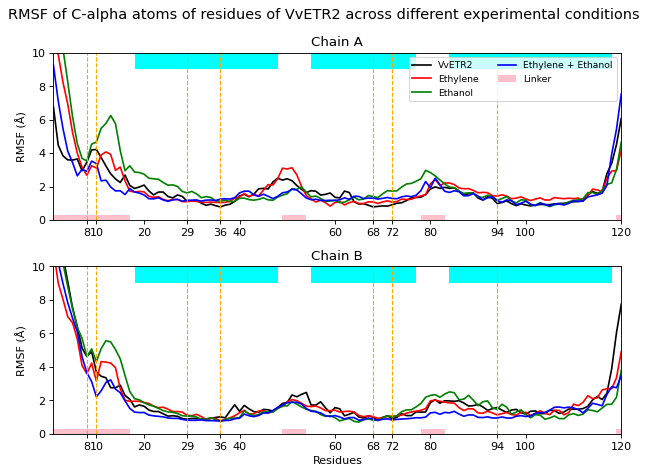

In [5]:
def load_xvg(filename):
    data = []
    with open(filename) as f:
        for line in f:
            if not line.startswith(('@', '#')):
                data.append([float(x) for x in line.split()])
    return np.array(data)

files = [
    ("alone/rmsf_VvETR2_Calpha.xvg",   "VvETR2",     "black"),
    ("ethylene/rmsf_ETHE_Calpha.xvg","Ethylene","red"),
    ("ethanol/rmsf_ETOH_Calpha.xvg", "Ethanol",  "green"),
    ("both/rmsf_both_Calpha.xvg",     "Ethylene + Ethanol",     "blue")
]

# linker et n-ter
highlight_ranges = [
    (1, 17-1),   
    (49, 54-49),
    (78, 83-78), 
    (119, 120-119)
]

highlight_r = [
    (18, 48-18),   
    (55, 77-55),
    (84, 118-84), 
]

highlights = [8,10,29, 36, 68, 72, 94] #résidus important

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 6), sharex=True)

for path, label, color in files:
    data = load_xvg(path)
    residus = data[:, 0]
    rmsf    = data[:, 1] * 10

    # Chaîne A
    res_a,  rmsf_a = residus[:120], rmsf[:120]
    # Chaîne B
    res_b,  rmsf_b = residus[120:] - 120, rmsf[120:]

    ax1.plot(res_a, rmsf_a, label=label, color=color)
    ax2.plot(res_b, rmsf_b, label=label, color=color)

# Calcul de la hauteur de barre 
for ax in (ax1, ax2):
    ymax = 10
    bar_h = 0.03 * ymax
    ax.set_ylim(0, ymax)
    # Dessine les barres roses
    ax.broken_barh(highlight_ranges,
                   (0, bar_h),
                   facecolors='pink')
    
for ax in (ax1, ax2):
    ymax = 10
    bar_h = 0.1 * ymax
    y_start = ymax - bar_h
    ax.set_ylim(0, ymax)
    # Dessine les barres roses
    ax.broken_barh(highlight_r,
                   (y_start, bar_h),
                   facecolors='cyan')
    
#marque en orange les résidus importants    
for x in highlights:
    ax1.axvline(x, color='orange', linestyle='--', linewidth=1)
    ax2.axvline(x, color='orange', linestyle='--', linewidth=1)

base_ticks = sorted(set(list(ax2.get_xticks()) + highlights))

# On applique aux deux axes
for ax in (ax1, ax2):
    ax.set_xticks(base_ticks)
    ax.tick_params(axis='x', which='both', labelbottom=True)


# Légende
pink_patch = mpatches.Patch(facecolor='pink', edgecolor='none', label='Linker')
handles, labels = ax1.get_legend_handles_labels()
handles.append(pink_patch)
labels.append('Linker')
ax1.legend(handles=handles, labels=labels, ncol=2, fontsize="small", loc="upper right")
ax1.set_title("Chain A")
ax2.set_title("Chain B")
ax1.set_ylabel("RMSF (Å)")
ax2.set_ylabel("RMSF (Å)")
ax2.set_xlabel("Residues")
ax1.set_xlim(1, 120)
ax2.set_xlim(1, 120)
ax1.set_ylim(0, 10)
ax2.set_ylim(0, 10)
fig.suptitle("RMSF of C-alpha atoms of residues of VvETR2 across different experimental conditions", fontsize=13, y=0.98)
plt.tight_layout()
#plt.savefig(output_file, dpi=300)
plt.show()



Le code suivant permet d'analyser l'ouverture de la protéine et de générer des spheres visualisables sur vmd.

In [6]:
#MD_ETR doit contenir 
def hole(gro, fit, output_dir) :
    MD_ETR2 = mda.Universe(gro, fit)
    test_hole = HoleAnalysis(MD_ETR2, select = "protein",
                         executable= "/home/mabadielim/Desktop/hole/hole2/exe/hole",
                         #cpoint = [28.965001, 52.020004, 59.225004],
                         cpoint = [40.6, 37.7, 51],
                         verbose = True,
                         cvect= [0,0,1],
                         sos_triangle = "/home/mabadielim/Desktop/hole/hole2/exe/sos_triangle",
                         sph_process = "/home/mabadielim/Desktop/hole/hole2/exe/sph_process"
                        )
    test_hole.run(start=0, stop=10001, step= 1000)
    
    #plt.figure(figsize=(12, 6))
    profiles = test_hole.results.data["profiles"]
    for frame_id, profile in profiles.items() :
        x = profile["rxn_coord"]
        y = profile["radius"]*2
        plt.plot(x,y,label = f'frame_{frame_id}')
    
    
    
    plt.xlabel("coordonnées le long de la protéine")
    plt.xlim(20,90)
    #plt.ylim(0,35)
    plt.ylabel("Diametre")
    plt.title("HOLE")
    plt.axhline(y =1.5 , color = "red", linestyle = '--', label = "water")
    plt.axhline(y =4.16 , color = "green", linestyle = '--', label = "ethylene")
    plt.axhline(y =4.7, color = "purple", linestyle = '--', label = "ethanol")
    lignes, labels = plt.gca().get_legend_handles_labels() #plt gca get current axes et .get_legend_handles_labels() récupère tout ce qui a un label mais qui n'a pas de légende dans gca
    plt.legend(loc='upper right', fontsize='small', ncol=2, bbox_to_anchor=(1, 1), handles = lignes, labels=labels)
    plt.fill_between([0,100],0,4.1, color='gray', alpha=0.3, label="fermé")
    plt.grid(True)    
    #plt.savefig(os.path.join(output_dir,"figure_hole"), dpi=300)
    plt.show()
    
    os.makedirs(output_dir, exist_ok=True)
    
    for sph_file in test_hole.results.data["sphpdbs"]:
        if os.path.exists(sph_file):
            shutil.copy(sph_file, output_dir)
            print(f" Ok pour : {sph_file}")
        
            #Parce que hole fait bien chier à copier là où on lui demande pas : 
            os.remove(sph_file)
    for i in range(0, 10001, 1000):
        if i == 0 :
            fname = "hole000.out"
        else : 
            fname = f"hole{i}.out"
        os.remove(fname)

  0%|          | 0/11 [00:00<?, ?it/s]

/home/mabadielim/stage/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:1154: UserWarning: Found no information for attr: 'altLocs' Using default value of ' '
  warnings.warn("Found no information for attr: '{}'"
/home/mabadielim/stage/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:1154: UserWarning: Found no information for attr: 'icodes' Using default value of ' '
  warnings.warn("Found no information for attr: '{}'"
/home/mabadielim/stage/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:1154: UserWarning: Found no information for attr: 'chainIDs' Using default value of ''
  warnings.warn("Found no information for attr: '{}'"
/home/mabadielim/stage/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:1154: UserWarning: Found no information for attr: 'occupancies' Using default value of '1.0'
  warnings.warn("Found no information for attr: '{}'"
/home/mabadielim/stage/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:1154: UserWarning: Fo

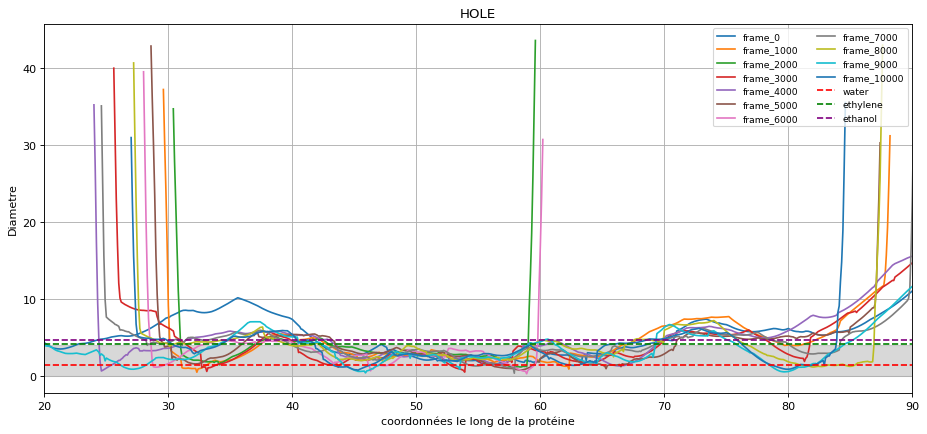

 Ok pour : hole000.sph
 Ok pour : hole1000.sph
 Ok pour : hole2000.sph
 Ok pour : hole3000.sph
 Ok pour : hole4000.sph
 Ok pour : hole5000.sph
 Ok pour : hole6000.sph
 Ok pour : hole7000.sph
 Ok pour : hole8000.sph
 Ok pour : hole9000.sph
 Ok pour : hole10000.sph


In [7]:
hole(ALONE_gro,ALONE_fit,"alone/hole")

  0%|          | 0/11 [00:00<?, ?it/s]

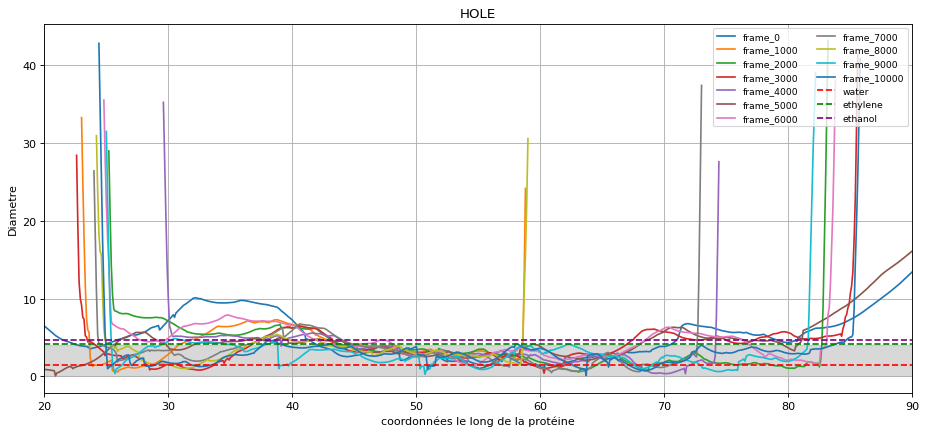

 Ok pour : hole000.sph
 Ok pour : hole1000.sph
 Ok pour : hole2000.sph
 Ok pour : hole3000.sph
 Ok pour : hole4000.sph
 Ok pour : hole5000.sph
 Ok pour : hole6000.sph
 Ok pour : hole7000.sph
 Ok pour : hole8000.sph
 Ok pour : hole9000.sph
 Ok pour : hole10000.sph


In [8]:
hole(ETHE_gro,ETHE_fit,"ethylene/hole")

  0%|          | 0/11 [00:00<?, ?it/s]

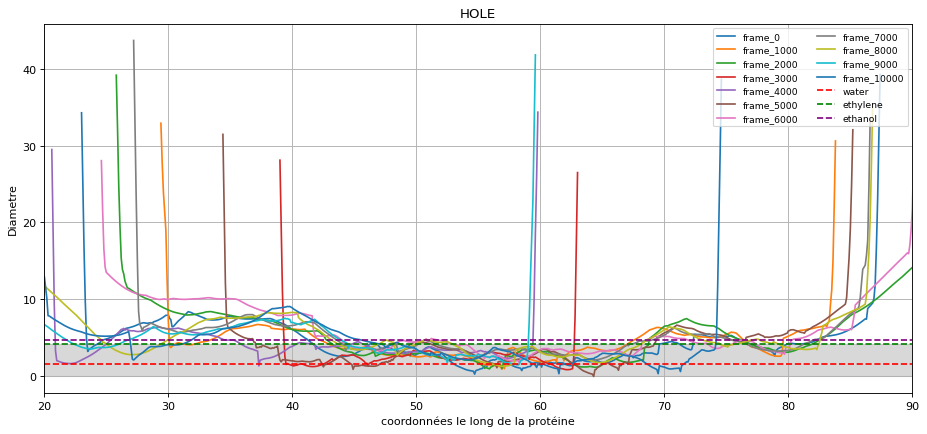

 Ok pour : hole000.sph
 Ok pour : hole1000.sph
 Ok pour : hole2000.sph
 Ok pour : hole3000.sph
 Ok pour : hole4000.sph
 Ok pour : hole5000.sph
 Ok pour : hole6000.sph
 Ok pour : hole7000.sph
 Ok pour : hole8000.sph
 Ok pour : hole9000.sph
 Ok pour : hole10000.sph


In [9]:
hole(ETOH_gro,ETOH_fit,"ethanol/hole")

  0%|          | 0/11 [00:00<?, ?it/s]

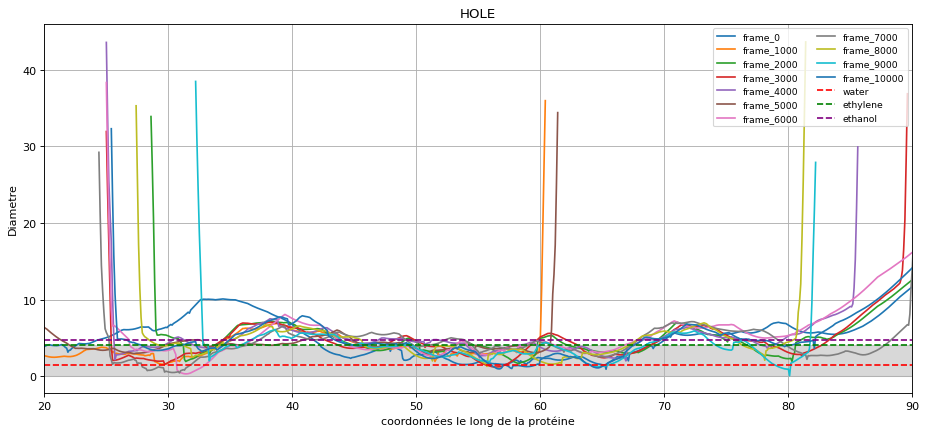

 Ok pour : hole000.sph
 Ok pour : hole1000.sph
 Ok pour : hole2000.sph
 Ok pour : hole3000.sph
 Ok pour : hole4000.sph
 Ok pour : hole5000.sph
 Ok pour : hole6000.sph
 Ok pour : hole7000.sph
 Ok pour : hole8000.sph
 Ok pour : hole9000.sph
 Ok pour : hole10000.sph


In [10]:
hole(BOTH_gro,BOTH_fit,"both/hole")

Le code ci-dessous permet de réaliser un csv contenant le temps que passe chaque ligand dans les différentes parties avec membrane et écart-type. 
⚠️ Il faut avoir tracé les fichiers XVG avec gromacs d'abord. ⚠️

In [11]:
z_min_membrane = 4.1
z_max_membrane = 7.9

# Limites XY de la protéine 
x_min_prot, x_max_prot = 1.9, 4.7
y_min_prot, y_max_prot = 1.9, 4.6

def temps_csv(xvg_files, ligand):
    summary_list = []
    
    #boucle pour chaque fichier xvg
    for filepath in xvg_files:
        filename = os.path.basename(filepath)
        ligand_id = filename.replace(f"{ligand}_z", "").replace(".xvg", "")

        with open(filepath, 'r') as f:
            lines = [line for line in f if not line.startswith(('@', '#'))]
        data = pd.read_csv(StringIO(''.join(lines)), sep=r'\s+', header=None)
    
        # extraction des colonnes
        time_ps = data.iloc[:, 0]
        x = data.iloc[:, 1]
        y = data.iloc[:, 2]
        z = data.iloc[:, 3]
    
        time_ns = time_ps / 1000  # conversion ps en ns
        delta_t_ns = time_ns.diff().fillna(0)
    
        #on regarde si c'est dans la membrane ou dans la protéine
        in_membrane = (z >= z_min_membrane) & (z <= z_max_membrane)
        in_protein = (x >= x_min_prot) & (x <= x_max_prot) & (y >= y_min_prot) & (y <= y_max_prot) & (z >= z_min_membrane) & (z <= z_max_membrane)
           
        #on calcule chaque durée
        time_in_protein = delta_t_ns[in_protein].sum()
        time_in_lipid = delta_t_ns[in_membrane].sum() - time_in_protein #on deduit bien le temps passé dans la protéine sinon c'est faux
        time_out_membrane = delta_t_ns[~in_membrane].sum()
        time_total = delta_t_ns.sum()
    
        # on ajoute ça au summary
        summary_list.append({
            "Fichier": filename,
            f"{ligand}_ID": ligand_id,
            "Temps_dans_proteine_ns": round(time_in_protein, 3),
            "Temps_dans_lipide_ns": round(time_in_lipid, 3),
            "Temps_hors_membrane_ns": round(time_out_membrane, 3),
            "Temps_total_ns": round(time_total, 3)
        })
      
    #on transforme le summary en dataframe
    df = pd.DataFrame(summary_list)
    num = df.select_dtypes(include="number")
    mean_val = num.mean().round(3)
    std_val  = num.std().round(3)
    
    #je veux aussi moyenn et ecart type à la fin 
    
    stats_df = pd.DataFrame([
        {
            "Fichier":               "",
            f"{ligand}_ID":           "Moyenne",
            "Temps_dans_proteine_ns": mean_val["Temps_dans_proteine_ns"],
            "Temps_dans_lipide_ns":   mean_val["Temps_dans_lipide_ns"],
            "Temps_hors_membrane_ns": mean_val["Temps_hors_membrane_ns"],
            "Temps_total_ns":         mean_val["Temps_total_ns"],
        },
        {
            "Fichier":               "",
            f"{ligand}_ID":           "Écart-type",
            "Temps_dans_proteine_ns": std_val["Temps_dans_proteine_ns"],
            "Temps_dans_lipide_ns":   std_val["Temps_dans_lipide_ns"],
            "Temps_hors_membrane_ns": std_val["Temps_hors_membrane_ns"],
            "Temps_total_ns":         std_val["Temps_total_ns"],
        }
    ])
    
    # j'ajoute la moyenne et l'ecart type dans le df
    df = pd.concat([df, stats_df], ignore_index=True)
    #df.to_csv(( output_csv), index=False)
    #print(df)
    return(df)

In [12]:
# ETHE SEUL
ETHE_traj = "ethylene/traj_ethe/"
ETHE_traj_files = sorted(glob.glob(os.path.join(ETHE_traj, "ethylene_z*.xvg")))
ETHE_df_temps = temps_csv(ETHE_traj_files, "ethylene")
ETHE_df_temps

,Fichier,ethylene_ID,Temps_dans_proteine_ns,Temps_dans_lipide_ns,Temps_hors_membrane_ns,Temps_total_ns
0,ethylene_z1.xvg,1,64.000,556.800,379.200,1000.0
1,ethylene_z10.xvg,10,40.000,705.800,254.200,1000.0
2,ethylene_z2.xvg,2,79.300,680.200,240.500,1000.0
3,ethylene_z3.xvg,3,45.300,516.900,437.800,1000.0
4,ethylene_z4.xvg,4,308.900,196.500,494.600,1000.0
5,ethylene_z5.xvg,5,103.500,496.000,400.500,1000.0
6,ethylene_z6.xvg,6,152.600,424.800,422.600,1000.0
7,ethylene_z7.xvg,7,83.800,438.700,477.500,1000.0
8,ethylene_z8.xvg,8,144.800,455.400,399.800,1000.0
9,ethylene_z9.xvg,9,97.700,554.100,348.200,1000.0


In [13]:
# ETOH SEUL
ETOH_traj = "ethanol/traj_etoh/"
ETOH_traj_files = sorted(glob.glob(os.path.join(ETOH_traj, "ethanol_z*.xvg")))
ETOH_df_temps = temps_csv(ETOH_traj_files, "ethanol")
ETOH_df_temps

,Fichier,ethanol_ID,Temps_dans_proteine_ns,Temps_dans_lipide_ns,Temps_hors_membrane_ns,Temps_total_ns
0,ethanol_z1.xvg,1,11.800,171.800,816.400,1000.0
1,ethanol_z10.xvg,10,22.900,151.800,825.300,1000.0
2,ethanol_z2.xvg,2,51.200,137.800,811.000,1000.0
3,ethanol_z3.xvg,3,12.900,157.600,829.500,1000.0
4,ethanol_z4.xvg,4,10.500,129.900,859.600,1000.0
5,ethanol_z5.xvg,5,11.700,119.100,869.200,1000.0
6,ethanol_z6.xvg,6,21.300,166.800,811.900,1000.0
7,ethanol_z7.xvg,7,15.500,145.600,838.900,1000.0
8,ethanol_z8.xvg,8,13.000,206.300,780.700,1000.0
9,ethanol_z9.xvg,9,14.100,169.400,816.500,1000.0


In [14]:
# ETHE BOTH
BOTH_traj = "both/traj_ethe/"
BOTH_ETHE_traj_files = sorted(glob.glob(os.path.join(BOTH_traj, "ethylene_z*.xvg")))
BOTH_ETHE_df_temps = temps_csv(BOTH_ETHE_traj_files, "ethylene")
BOTH_ETHE_df_temps

,Fichier,ethylene_ID,Temps_dans_proteine_ns,Temps_dans_lipide_ns,Temps_hors_membrane_ns,Temps_total_ns
0,ethylene_z1.xvg,1,154.900,386.200,458.900,1000.0
1,ethylene_z10.xvg,10,132.200,580.100,287.700,1000.0
2,ethylene_z2.xvg,2,141.000,405.500,453.500,1000.0
3,ethylene_z3.xvg,3,63.800,669.900,266.300,1000.0
4,ethylene_z4.xvg,4,107.700,428.000,464.300,1000.0
5,ethylene_z5.xvg,5,277.900,345.300,376.800,1000.0
6,ethylene_z6.xvg,6,42.000,590.400,367.600,1000.0
7,ethylene_z7.xvg,7,242.200,270.600,487.200,1000.0
8,ethylene_z8.xvg,8,72.100,630.900,297.000,1000.0
9,ethylene_z9.xvg,9,46.500,598.000,355.500,1000.0


In [15]:
BOTH_ETOH_traj = "both/traj_etoh/"
BOTH_ETOH_traj_files = sorted(glob.glob(os.path.join(BOTH_ETOH_traj, "ethanol_z*.xvg")))
BOTH_ETOH_df_temps = temps_csv(BOTH_ETOH_traj_files, "ethanol")
BOTH_ETOH_df_temps

,Fichier,ethanol_ID,Temps_dans_proteine_ns,Temps_dans_lipide_ns,Temps_hors_membrane_ns,Temps_total_ns
0,ethanol_z1.xvg,1,9.400,204.800,785.800,1000.0
1,ethanol_z10.xvg,10,24.700,133.300,842.000,1000.0
2,ethanol_z2.xvg,2,29.600,177.600,792.800,1000.0
3,ethanol_z3.xvg,3,12.200,205.700,782.100,1000.0
4,ethanol_z4.xvg,4,39.900,232.900,727.200,1000.0
5,ethanol_z5.xvg,5,9.200,170.700,820.100,1000.0
6,ethanol_z6.xvg,6,1.900,152.000,846.100,1000.0
7,ethanol_z7.xvg,7,15.800,130.300,853.900,1000.0
8,ethanol_z8.xvg,8,8.300,125.700,866.000,1000.0
9,ethanol_z9.xvg,9,3.900,135.600,860.500,1000.0


Nous allons rendre plus visuel les tableaux en effectuant des histogrammes en barre, groupé ou bien empilé. 

In [16]:
def histogramme_repartition_temps(df, ligand) : 
    df = df[df['Fichier'].str.strip() != ''] 
    df['Temps_dans_proteine_ns'] = df['Temps_dans_proteine_ns'].astype(float)
    df['Temps_dans_membrane_ns'] = df['Temps_dans_lipide_ns'].astype(float)
    df['Temps_hors_membrane_ns'] = df['Temps_hors_membrane_ns'].astype(float)

    ligand_ids = df[f'{ligand}_ID'].astype(str)
    x = np.arange(len(ligand_ids))
    width = 0.25


    plt.figure(figsize=(12, 4))
    plt.bar(x - width, df['Temps_dans_proteine_ns'], width, label='Dans la protéine')
    plt.bar(x, df['Temps_dans_membrane_ns'], width, label='Dans la membrane')
    plt.bar(x + width, df['Temps_hors_membrane_ns'], width, label='Hors de la membrane')

    plt.xlabel(f"ID {ligand}")
    plt.ylabel("Temps (ns)")
    plt.title("Temps par région – Histogramme groupé")
    plt.xticks(x, ligand_ids, rotation=45, ha='right')
    plt.legend()
    plt.grid(True, axis='y', linestyle='--', alpha=0.5)
    plt.tight_layout()
    #plt.savefig(os.path.join(outdir, "histogramme_groupé.png"), dpi=300)
    plt.show()


    plt.figure(figsize=(12, 4))
    plt.bar(x, df['Temps_dans_proteine_ns'], width, label='Dans la protéine')
    plt.bar(x, df['Temps_dans_membrane_ns'], width, bottom=df['Temps_dans_proteine_ns'], label='Dans la membrane')
    plt.bar(x, df['Temps_hors_membrane_ns'], width, bottom=df['Temps_dans_proteine_ns'] + df['Temps_dans_membrane_ns'], label='Hors de la membrane')

    plt.xlabel(f"ID {ligand}")
    plt.ylabel("Temps cumulé (ns)")
    plt.title("Temps par région – Histogramme empilé")
    plt.xticks(x, ligand_ids, rotation=45, ha='right')
    plt.legend()
    plt.grid(True, axis='y', linestyle='--', alpha=0.5)
    plt.tight_layout()
    #plt.savefig(os.path.join(outdir, "histogramme_empilé.png"), dpi=300)
    plt.show()

/tmp/ipykernel_181553/3318501495.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Temps_dans_proteine_ns'] = df['Temps_dans_proteine_ns'].astype(float)
/tmp/ipykernel_181553/3318501495.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Temps_dans_membrane_ns'] = df['Temps_dans_lipide_ns'].astype(float)
/tmp/ipykernel_181553/3318501495.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the 

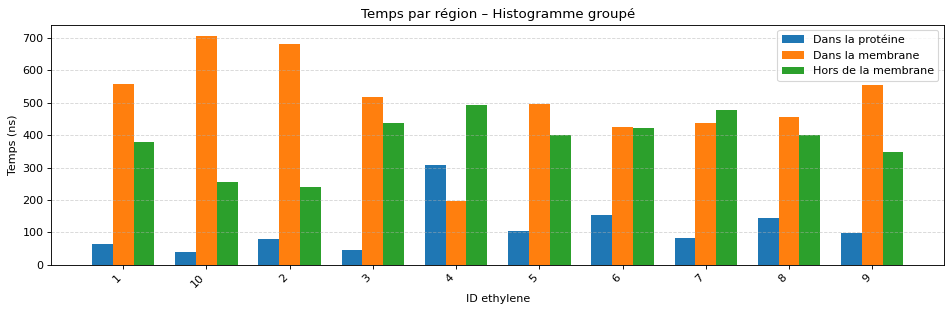

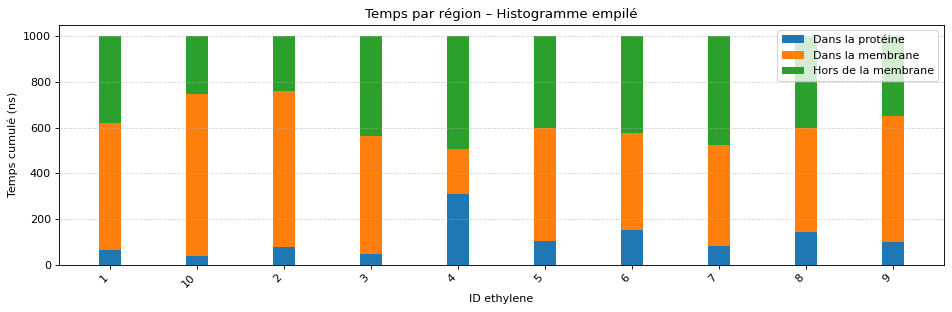

In [17]:
histogramme_repartition_temps(ETHE_df_temps, "ethylene")

/tmp/ipykernel_181553/3318501495.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Temps_dans_proteine_ns'] = df['Temps_dans_proteine_ns'].astype(float)
/tmp/ipykernel_181553/3318501495.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Temps_dans_membrane_ns'] = df['Temps_dans_lipide_ns'].astype(float)
/tmp/ipykernel_181553/3318501495.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the 

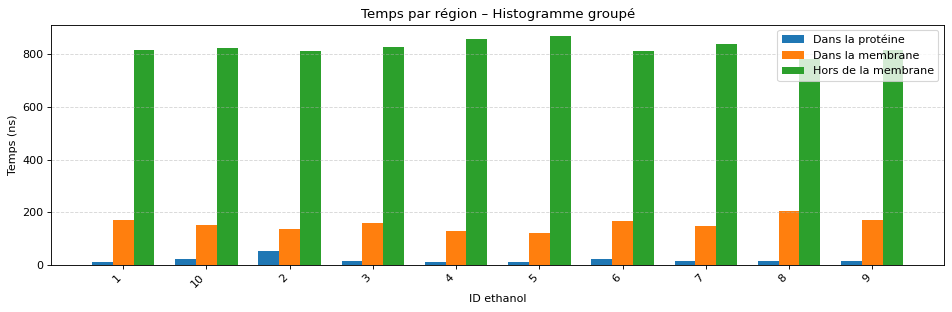

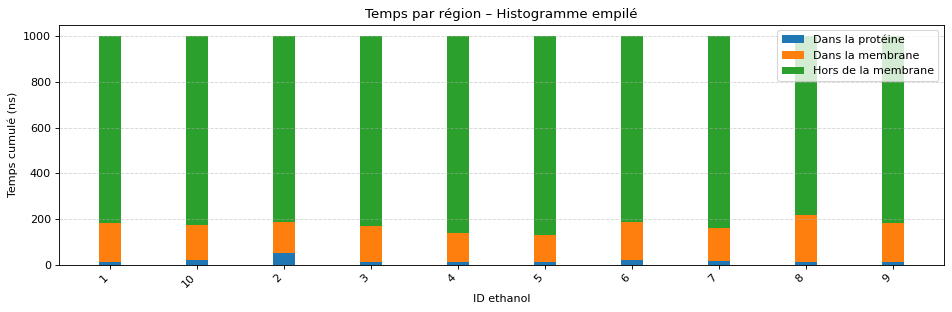

In [18]:
histogramme_repartition_temps(ETOH_df_temps, "ethanol")

/tmp/ipykernel_181553/3318501495.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Temps_dans_proteine_ns'] = df['Temps_dans_proteine_ns'].astype(float)
/tmp/ipykernel_181553/3318501495.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Temps_dans_membrane_ns'] = df['Temps_dans_lipide_ns'].astype(float)
/tmp/ipykernel_181553/3318501495.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the 

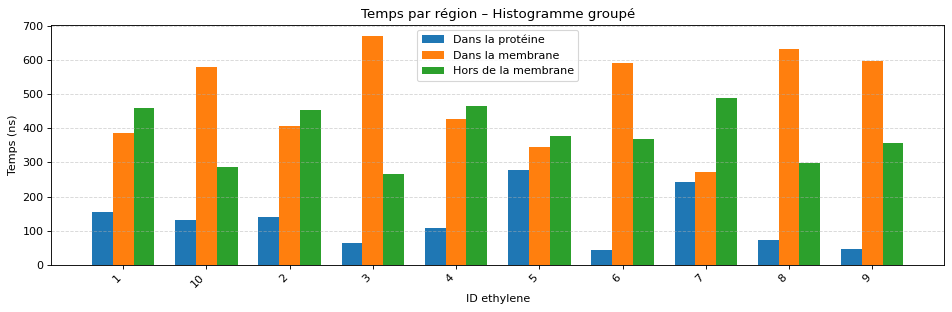

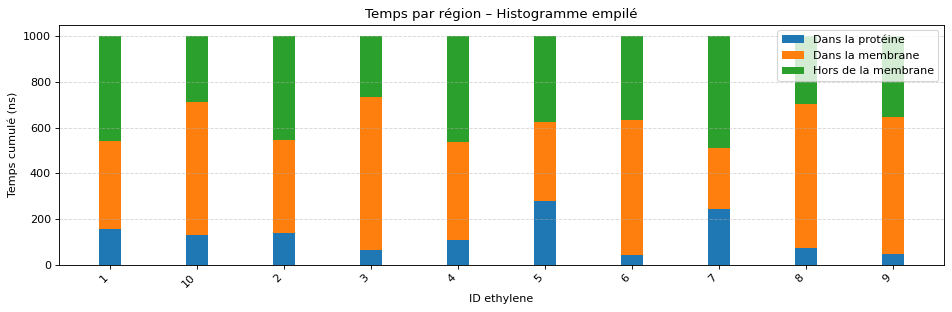

In [19]:
histogramme_repartition_temps(BOTH_ETHE_df_temps, "ethylene")

/tmp/ipykernel_181553/3318501495.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Temps_dans_proteine_ns'] = df['Temps_dans_proteine_ns'].astype(float)
/tmp/ipykernel_181553/3318501495.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Temps_dans_membrane_ns'] = df['Temps_dans_lipide_ns'].astype(float)
/tmp/ipykernel_181553/3318501495.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the 

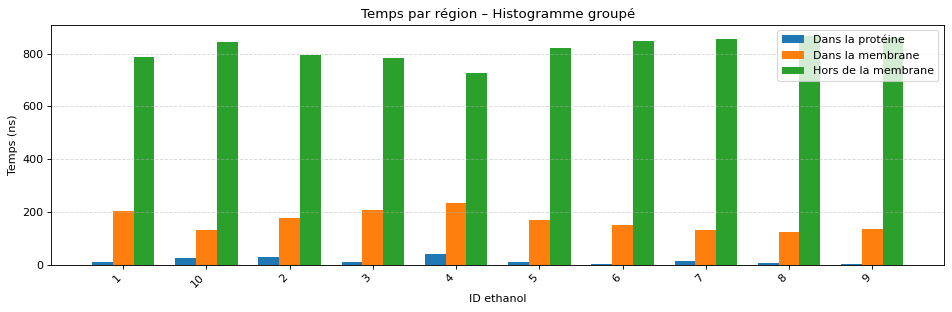

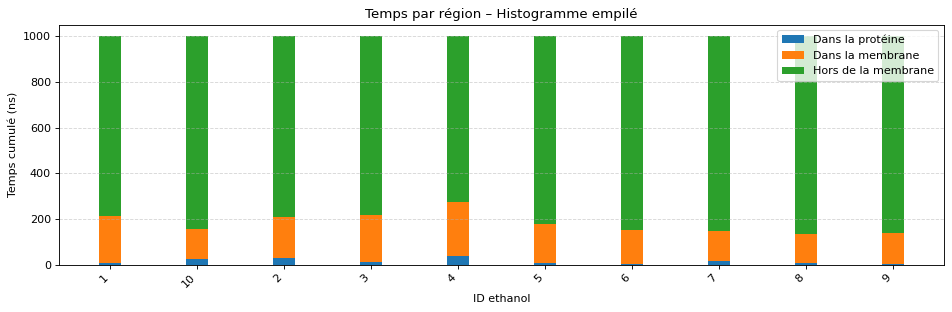

In [20]:
histogramme_repartition_temps(BOTH_ETOH_df_temps, "ethanol")

Je vais également effectuer un tableau comparatif et un plots comparatifs des moyennes et des écarts types. 

In [21]:
def comparer_moyennes(dfs, noms):
    comparaison = []    
    labels = []
    moyennes = []
    ecarts_types = []
    colors = ["red", 'lightgreen', 'dodgerblue', "deepskyblue"]

    #ligand_ids = df[f'{ligand}_ID'].astype(str)
    for df, nom in zip(dfs, noms):
        idx_moyenne = df[df.iloc[:, 1].astype(str).str.strip().str.lower() == 'moyenne'].index
        idx_sd = df[df.iloc[:, 1].astype(str).str.strip().str.lower().str.contains("écart")].index    
        moyenne = df.iloc[idx_moyenne[0], 2:-1].astype(float).values
        print(moyenne)
        ecart_type = df.iloc[idx_sd[0], 2:-1].astype(float).values
        print(ecart_type)
        
        #pour le plots
        labels.append(nom)
        moyennes.append(moyenne)        # Une colonne choisie
        ecarts_types.append(ecart_type)

        # Pour le df
        ligne_formatée = [f"{m:.2f} ± {e:.2f}" for m, e in zip(moyenne, ecart_type)]
        comparaison.append([nom] + ligne_formatée)

    #Pour le plot    
    moyennes_array = np.array(moyennes)        # shape (n_fichiers, n_colonnes)
    ecarts_array = np.array(ecarts_types)      # idem
    
    n_colonnes = moyennes_array.shape[1]
    
    for i in range(n_colonnes):
            x = np.arange(len(labels))
            y = moyennes_array[:, i]
            yerr = ecarts_array[:, i]
            if i == 0 :
                compartiment = "la proteine"
            elif i == 1 :
                compartiment = "la membrane"
            else : 
                compartiment = "le solvant"
        
            plt.figure(figsize=(7, 4))
            plt.bar(x, y, yerr=yerr, capsize=5, color=colors)
            plt.xticks(x, labels)
            plt.ylabel("Valeur moyenne ± écart-type")
            plt.title(f"Comparaison des moyennes pour le temps passé dans {compartiment}")
            plt.grid(True, axis='y', linestyle='--', alpha=0.7)
            plt.tight_layout()
            plt.show()
    
    # Pour le df 
    colonnes = ["Fichier"] + [f"Colonne {i+1}" for i in range(len(ligne_formatée))]
    result_df = pd.DataFrame(comparaison, columns=colonnes)
    return result_df

[111.99 502.52 385.49]
[ 78.579 143.268  84.724]
[ 18.49 155.61 825.9 ]
[12.209 24.893 25.457]
[128.03 490.49 381.48]
[ 80.359 138.608  81.175]
[ 15.49 166.86 817.65]
[12.193 37.704 44.688]


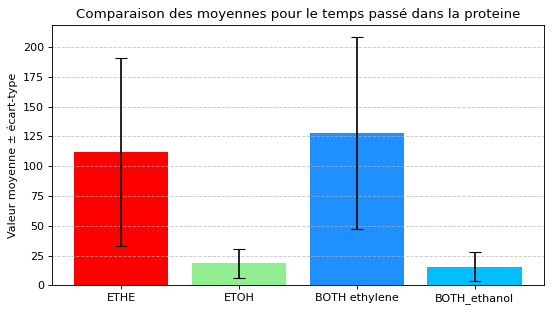

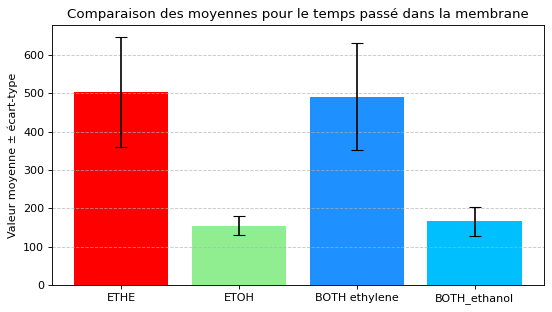

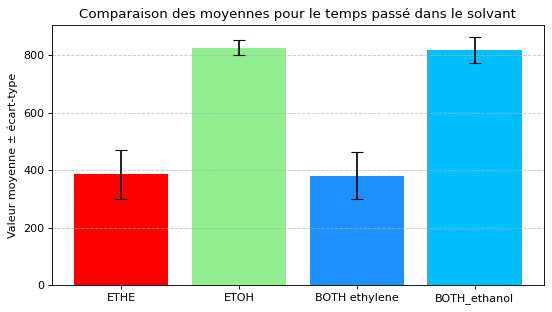

In [22]:
all_df = [ETHE_df_temps, ETOH_df_temps, BOTH_ETHE_df_temps, BOTH_ETOH_df_temps]
all_condition = ["ETHE", "ETOH", "BOTH ethylene", "BOTH_ethanol"]
comparaison = comparer_moyennes(all_df, all_condition)

Tracer des plots pour suivre le deltaZ de la distance de la membrane des ligands, dans les différentes conditions.

Au départ j'utilisais des valeurs smoothés pour les plots, mais cela ajoutais trop d'incohérence, le smooth n'est donc pas conservé.


In [23]:
# def smooth(x, window_len=11, window='hanning'):
#     x = np.asarray(x) 

#     if x.ndim != 1:
#         raise ValueError("smooth only accepts 1 dimension arrays.")
#     if x.size < window_len:
#         raise ValueError("Input vector needs to be bigger than window size.")
#     if window_len < 3:
#         return x
#     if window not in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
#         raise ValueError("Window must be one of 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'")

#     s = np.r_[2*x[0] - x[window_len-1::-1], x, 2*x[-1] - x[-1:-window_len:-1]]
#     w = np.ones(window_len) if window == 'flat' else getattr(np, window)(window_len)
#     y = np.convolve(w / w.sum(), s, mode='same')
#     return y[window_len:-window_len+1]

# Paramètres membrane
z_min_membrane = 4.1
z_max_membrane = 7.9
z_mid_membrane = (z_max_membrane + z_min_membrane) / 2

# Fonction de tracé
def trajetZ(file_list, ligand, condition):
    #output_folder = "plots"
    #os.makedirs(output_folder, exist_ok=True)

    #Figure qui regroupe tout
    #plt.figure(figsize=(12, 5))
    plt.axhline(z_max_membrane - z_mid_membrane, color='red', linestyle='--', label="Limite membrane")
    plt.axhline(z_min_membrane-z_mid_membrane, color='red', linestyle='--')
    plt.fill_between([-10, 1100],z_max_membrane - z_mid_membrane,z_min_membrane-z_mid_membrane, color='gray', alpha=0.5, label="Zone membrane")

    for i, file in enumerate(file_list, start=1):
        data = np.loadtxt(file, comments=('@', '#'))
        time = data[:, 0] / 1000  # ns
        z = data[:, 3]
        deltaZ = z - z_mid_membrane
        basename = os.path.basename(file)
        resnum = ''.join(filter(str.isdigit, basename)) 
        label = os.path.basename(file).replace(".xvg", "")
        plt.scatter(time, deltaZ, label=label, marker= ".", alpha = 0.5 )

    plt.xlabel("Temps (ns)")
    plt.ylim(-7, 7)
    plt.xlim(0,1000)
    plt.ylabel("ΔZ (nm)")
    plt.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
    plt.title(f"Distance deltaZ au centre de la membranes de toutes les molécules de {ligand} en condition {condition}")
    plt.grid(True)
    plt.show()
    plt.close()

    for i, file in enumerate(file_list, start=1):
        filename = os.path.basename(file)
        ligand_id = filename.replace(f"{ligand}_z", "").replace(".xvg", "")

        with open(file, 'r') as f:
            lines = [line for line in f if not line.startswith(('@', '#'))]
        data = pd.read_csv(StringIO(''.join(lines)), sep=r'\s+', header=None)

        time = data.iloc[:, 0] / 1000  # ns
        z = data.iloc[:, 3]            # nm
        deltaZ = z - z_mid_membrane
        #deltaZ_smoothed = smooth(deltaZ)

        # Tracé
        #plt.figure(figsize=(10, 5))
        plt.scatter(time, deltaZ, label="ΔZ lissé", marker = ".")
        plt.axhline(z_max_membrane - z_mid_membrane, color='red', linestyle='--', label="Limite membrane")
        plt.axhline(z_min_membrane - z_mid_membrane, color='red', linestyle='--')
        plt.fill_between(time, z_min_membrane - z_mid_membrane, z_max_membrane - z_mid_membrane,
                         color='gray', alpha=0.2, label="Zone membrane")

        plt.xlabel("Temps (ns)")
        plt.ylabel("ΔZ (nm)")
        plt.ylim(-7, 7)
        plt.title(f"{ligand} {ligand_id} — Distance au centre membrane en condition {condition}")
        plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
        plt.grid(True)
        plt.tight_layout()

        #output_file = os.path.join(output_folder, f"{ligand}_{i}_DeltaZ.png")
        #plt.savefig(output_file, dpi=300)
        plt.show()
        plt.close()


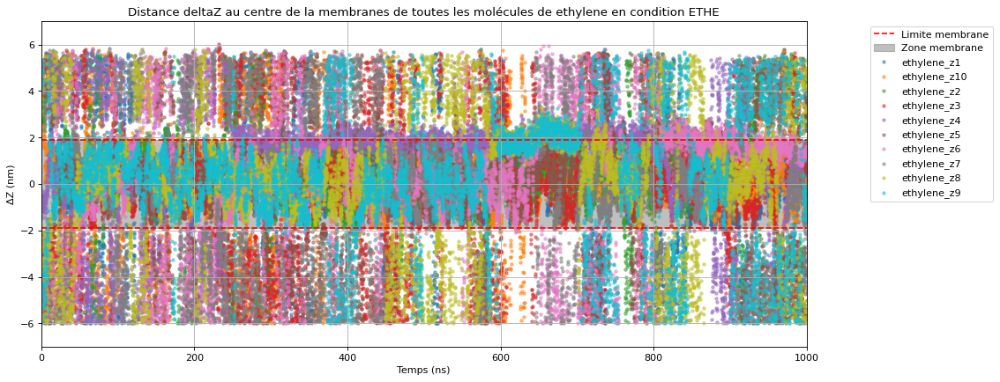

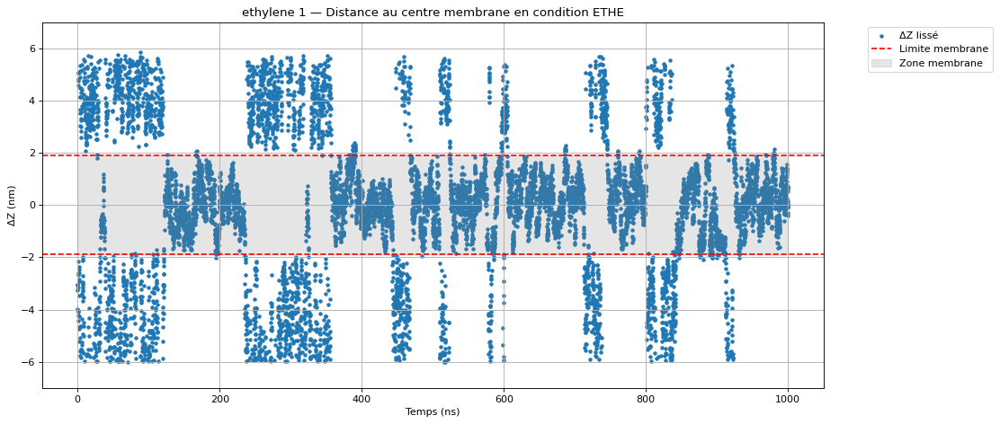

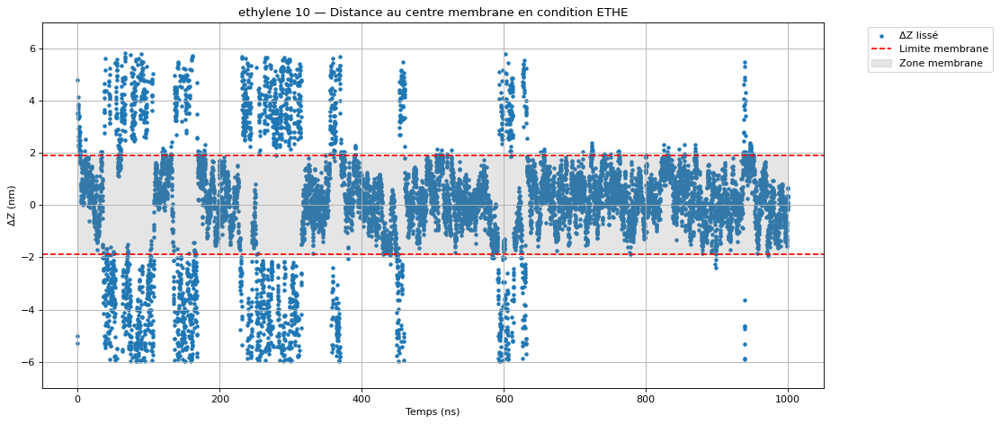

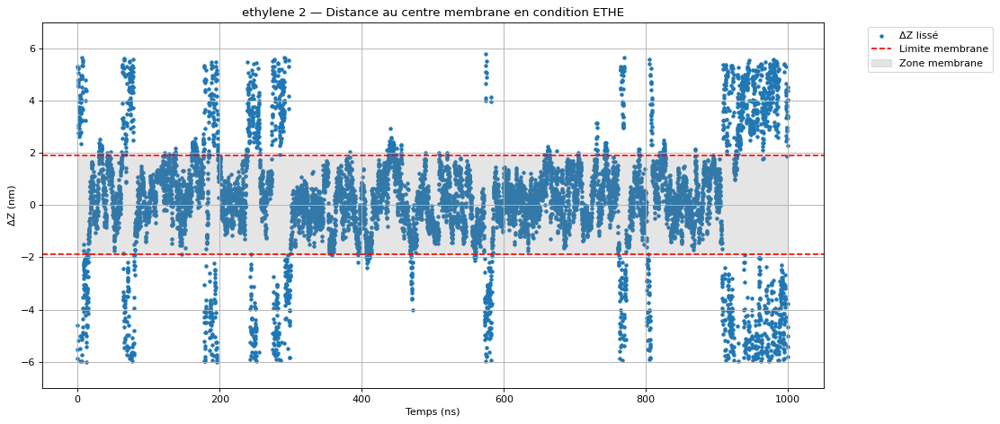

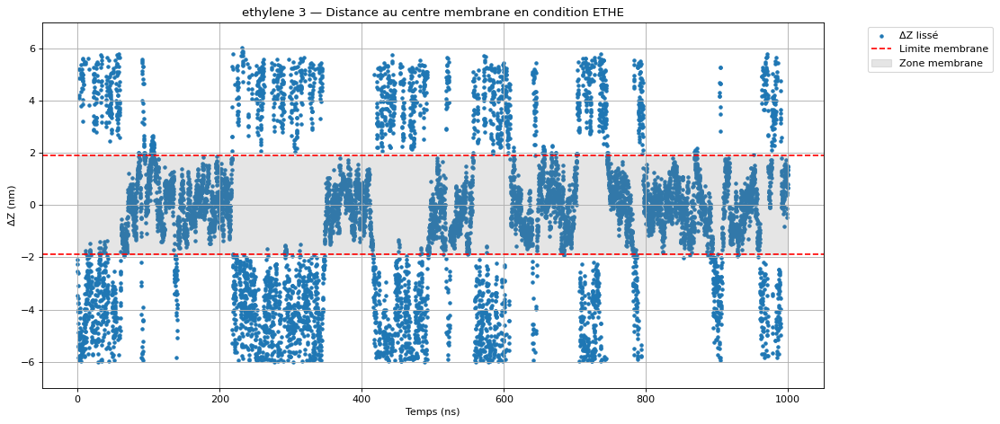

...

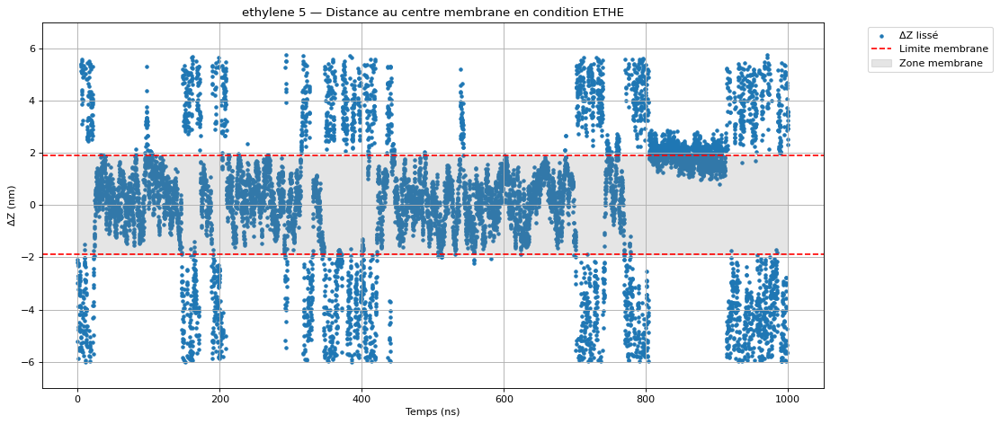

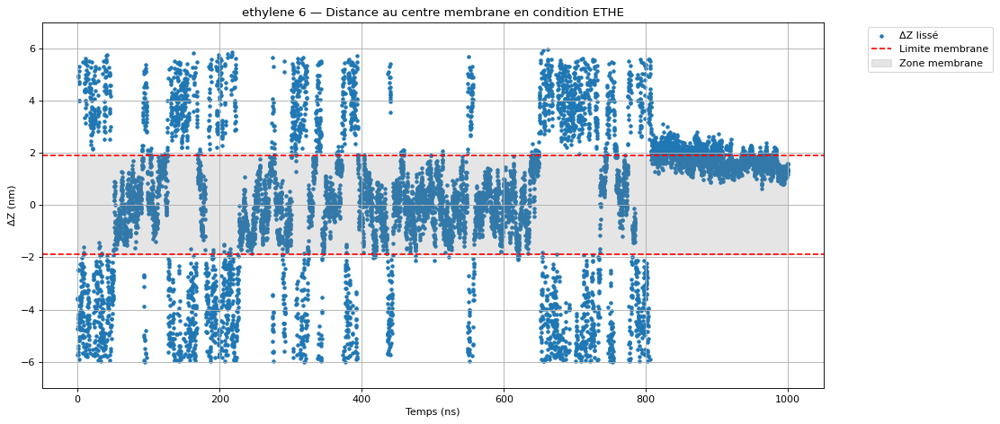

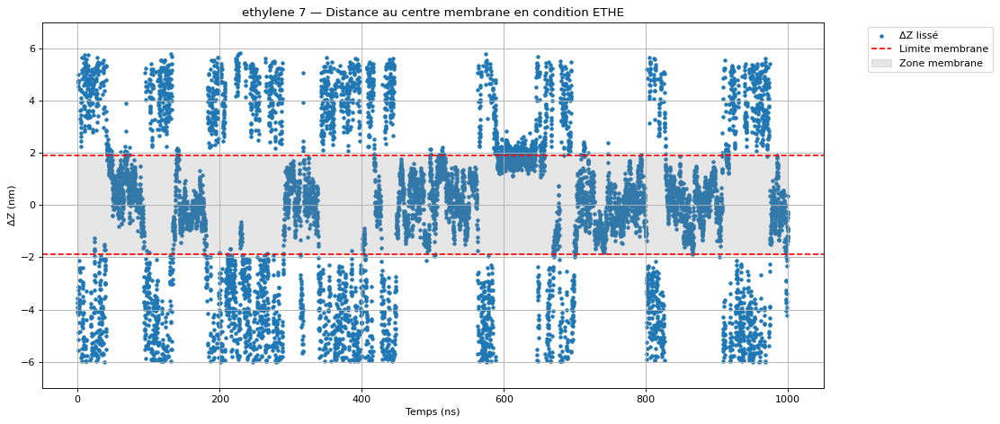

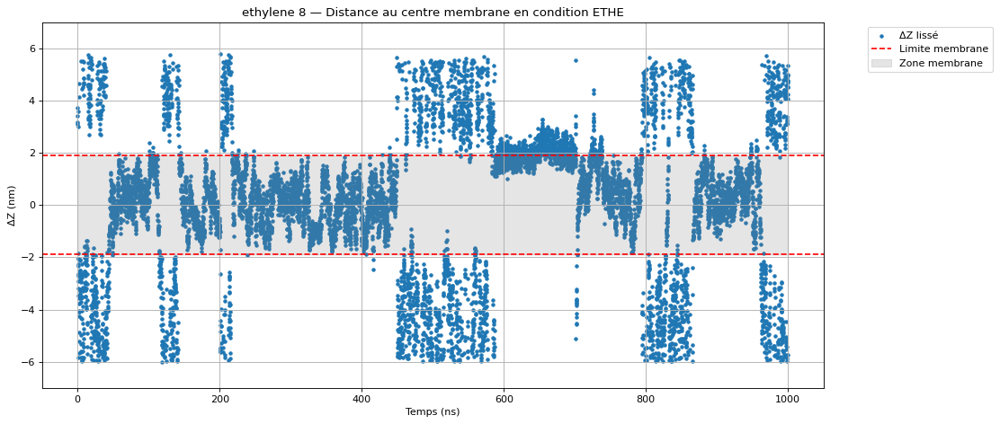

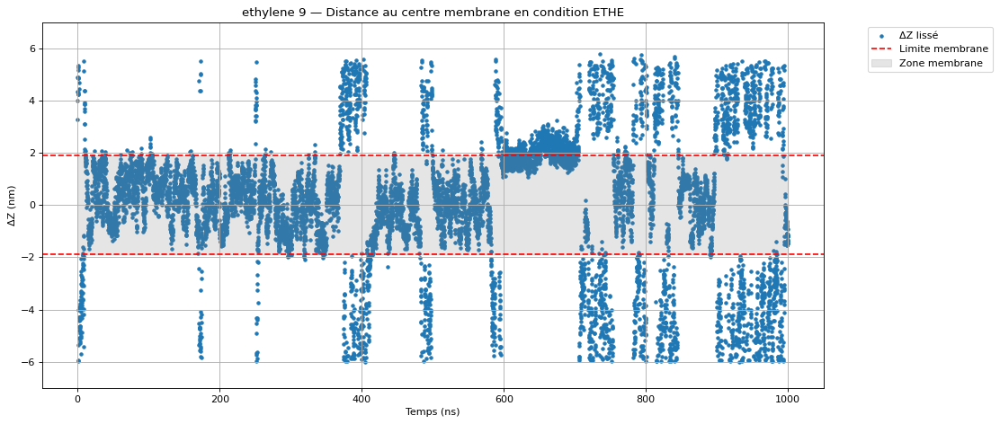

In [24]:
# ETHE SEUL
trajetZ(ETHE_traj_files, "ethylene","ETHE")

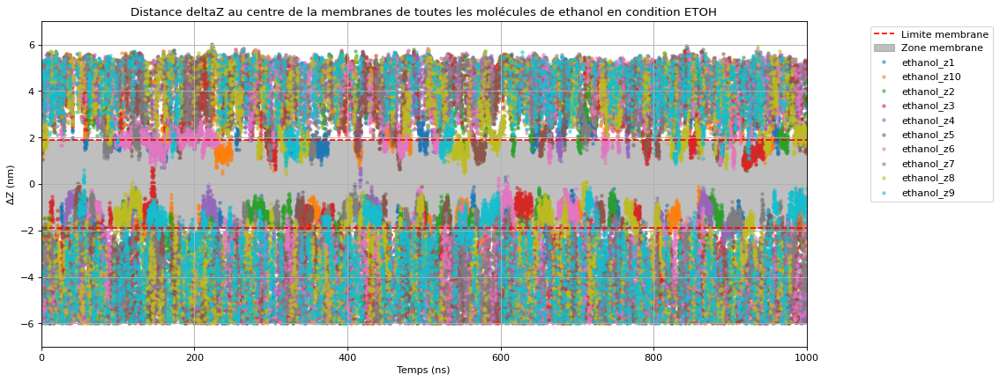

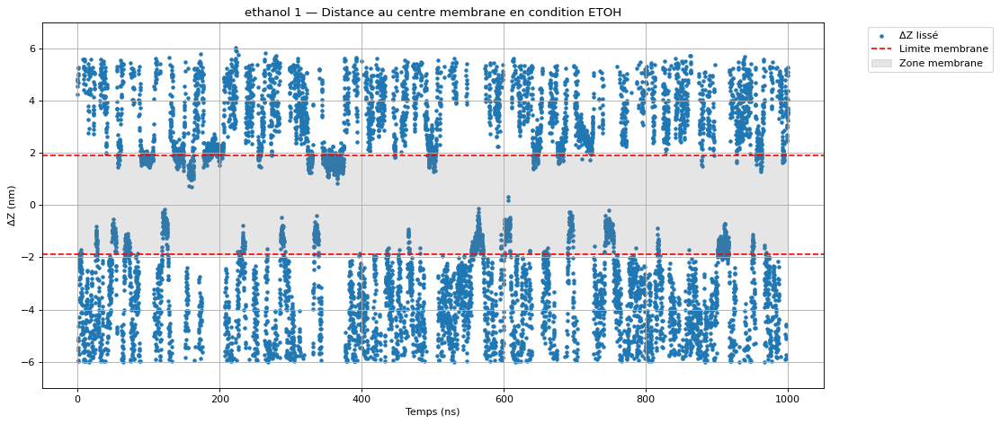

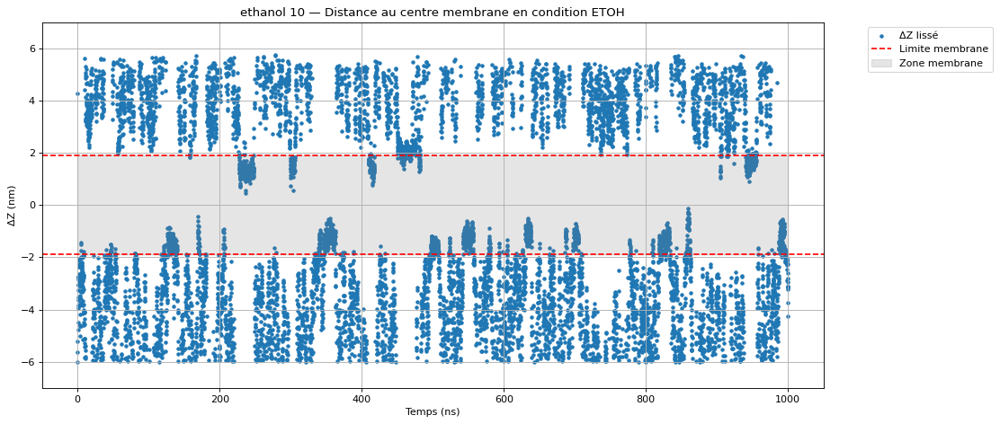

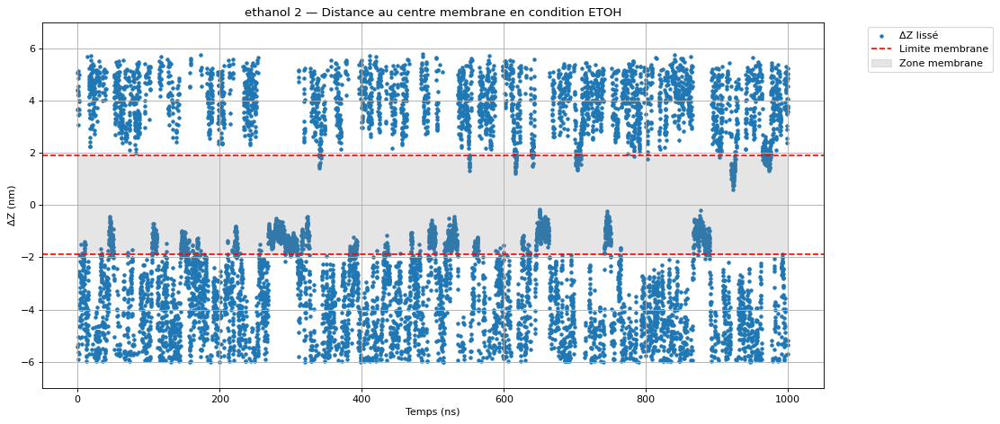

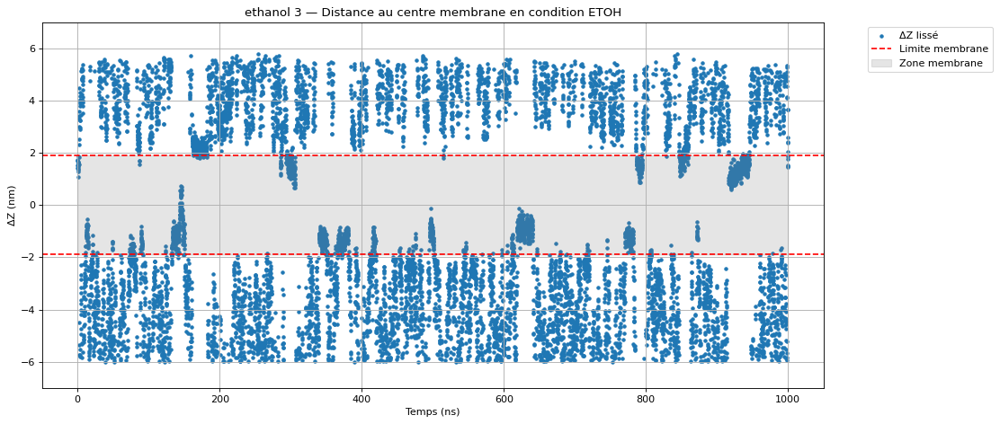

...

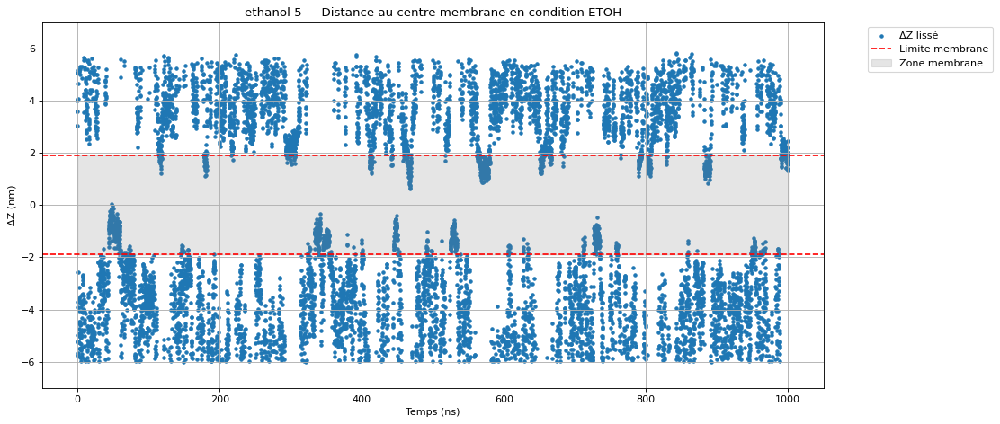

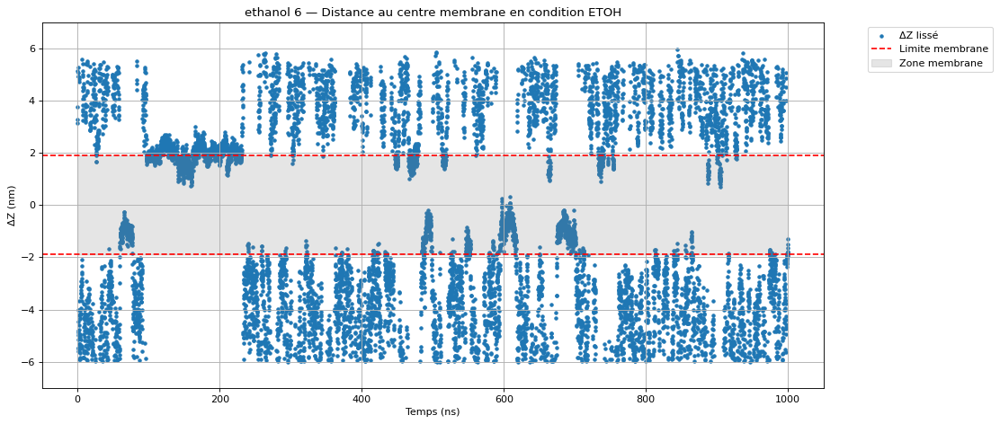

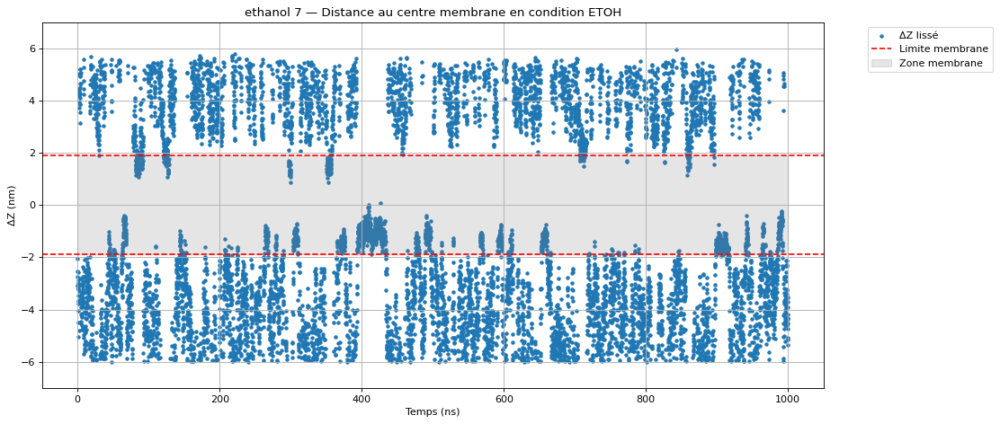

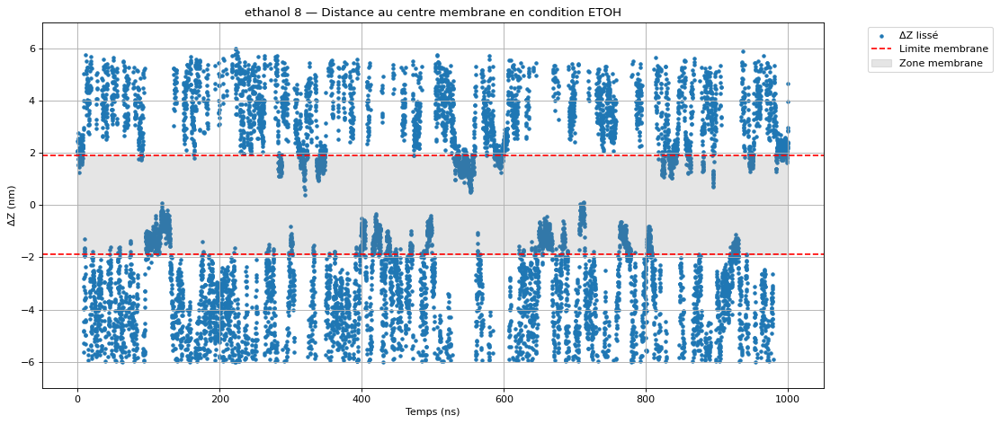

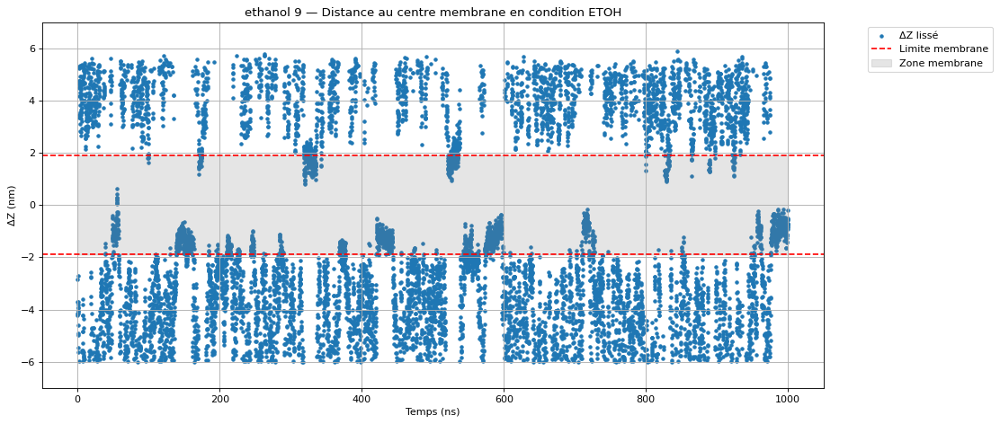

In [25]:
#ETOH seul
trajetZ(ETOH_traj_files, "ethanol", "ETOH")

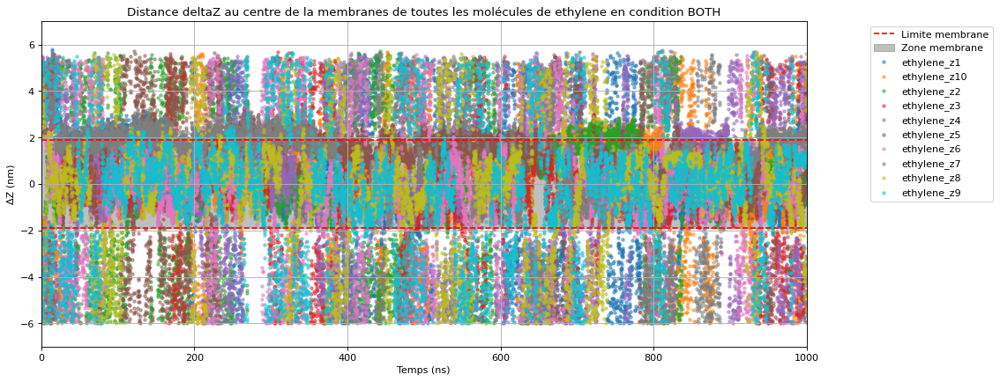

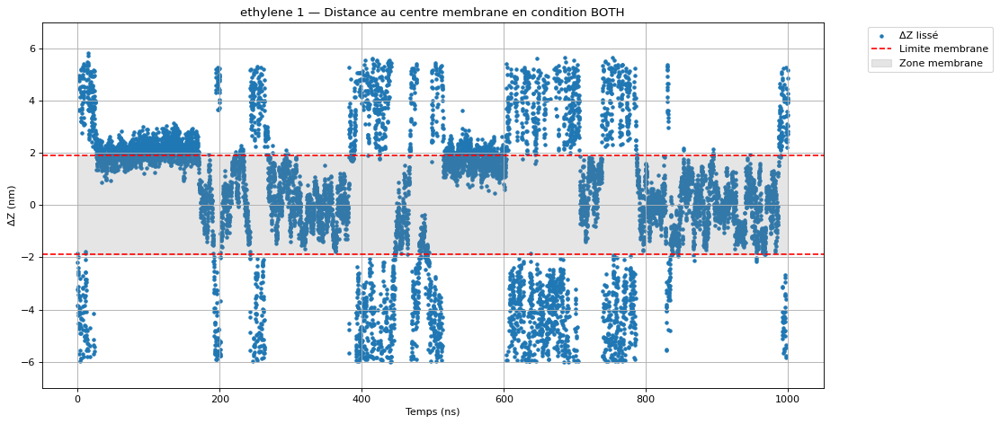

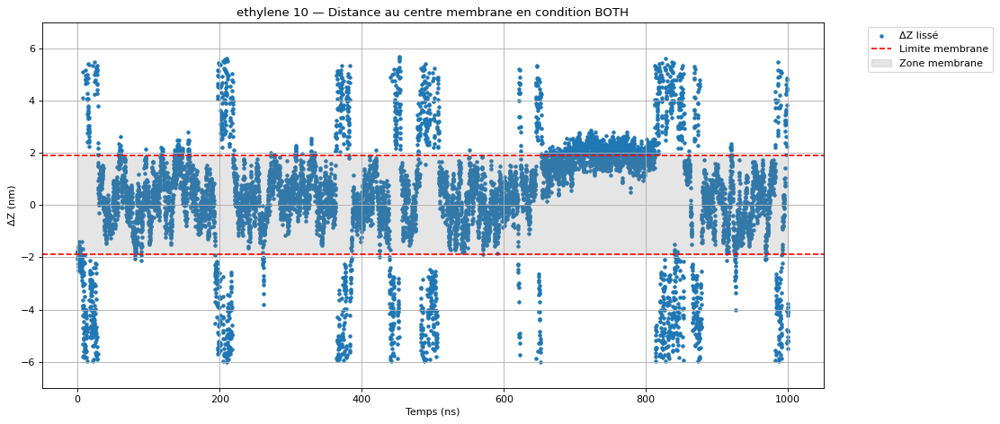

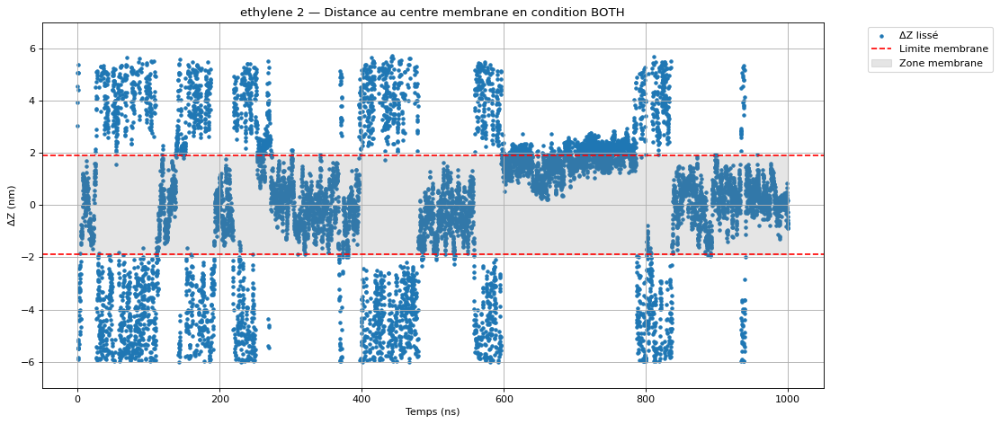

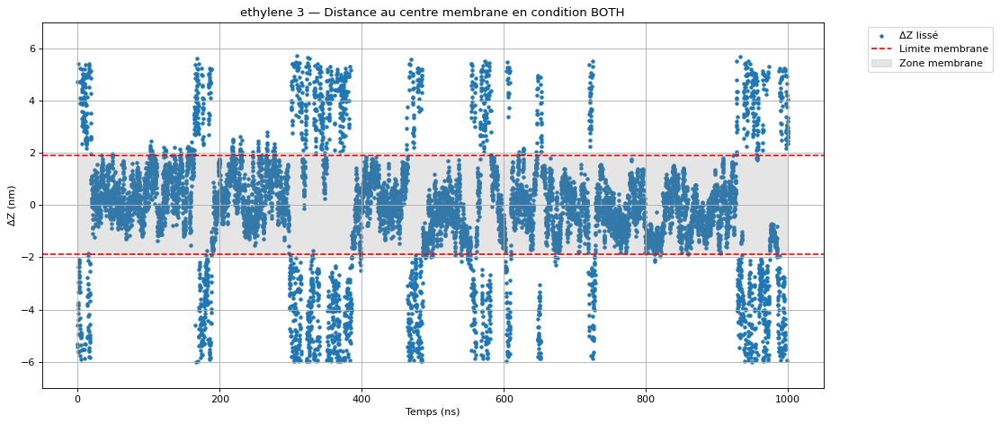

...

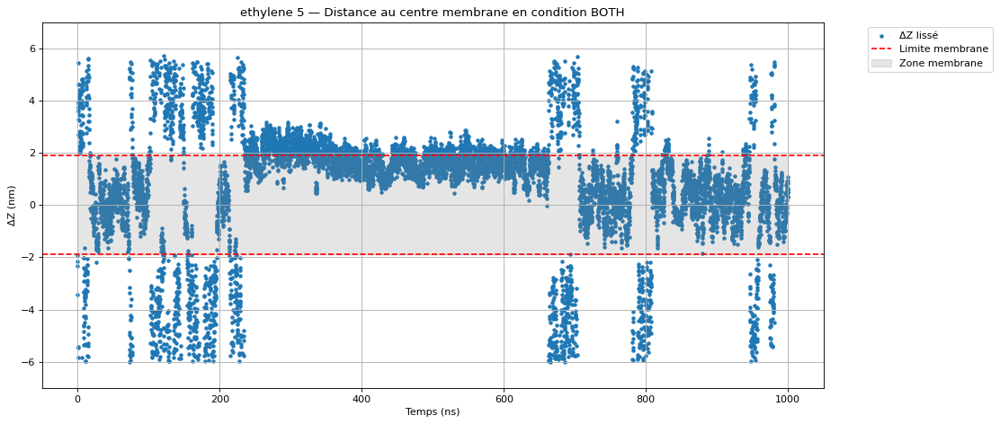

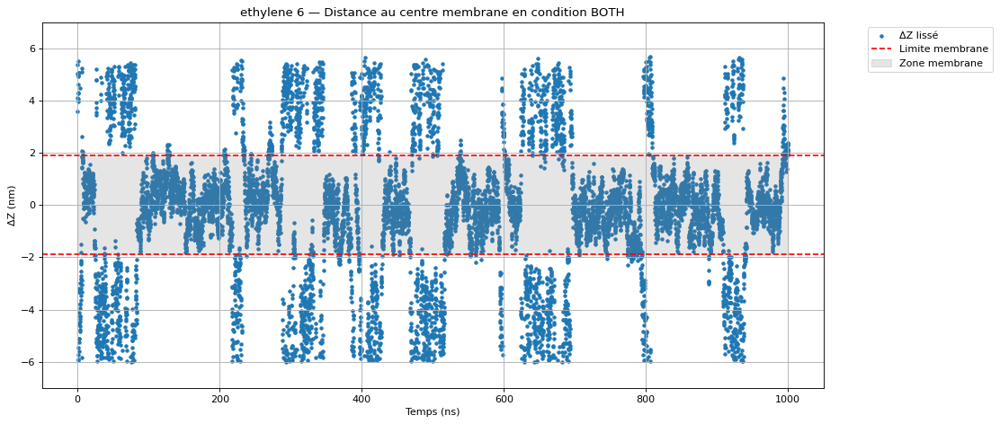

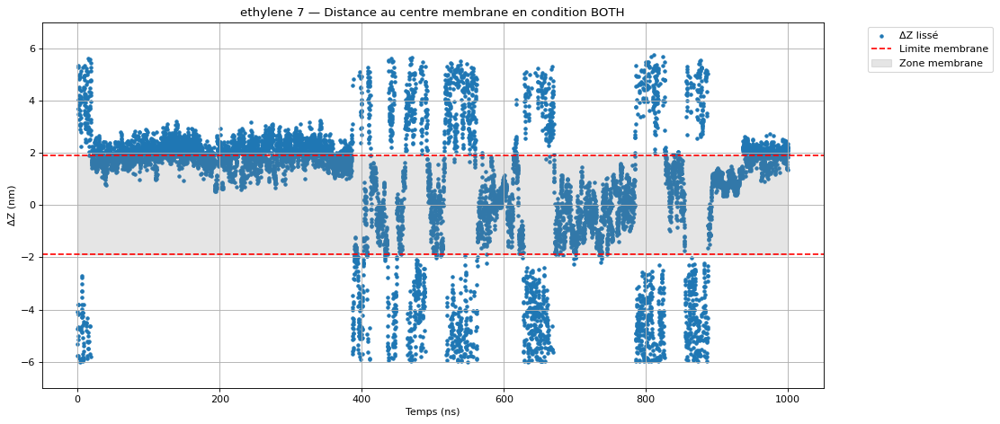

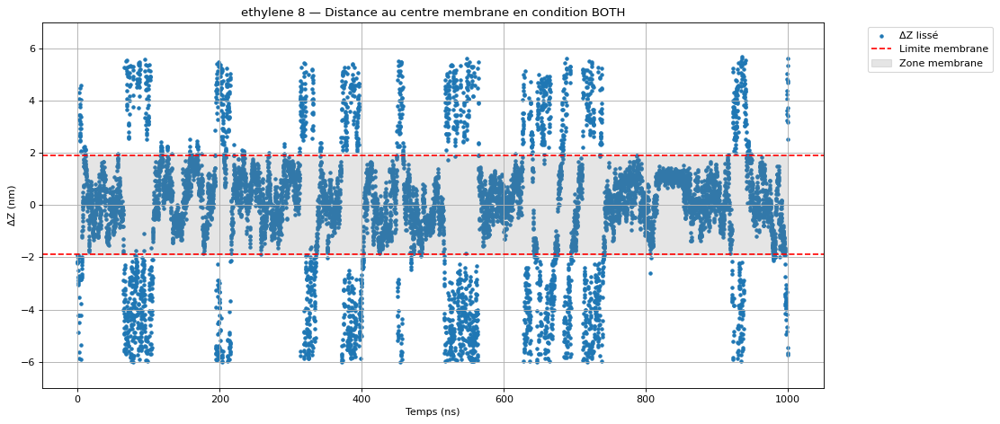

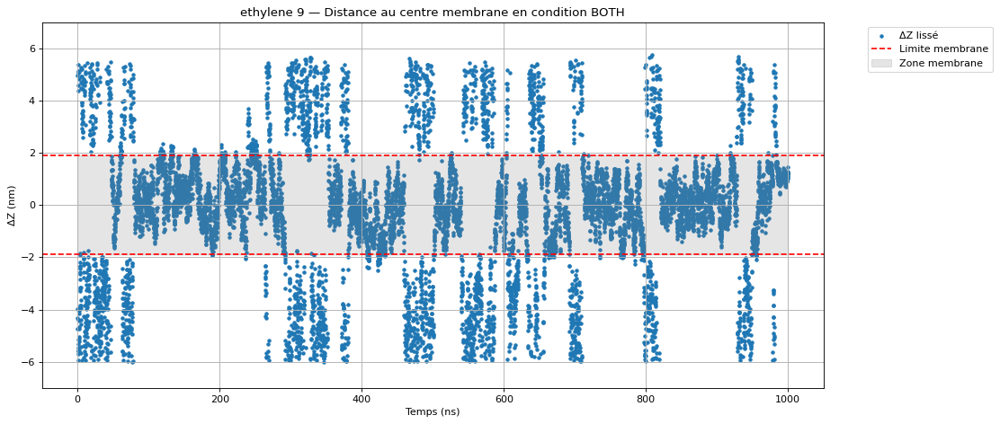

In [26]:
#ETHE dans BOTH
trajetZ(BOTH_ETHE_traj_files, "ethylene", "BOTH")

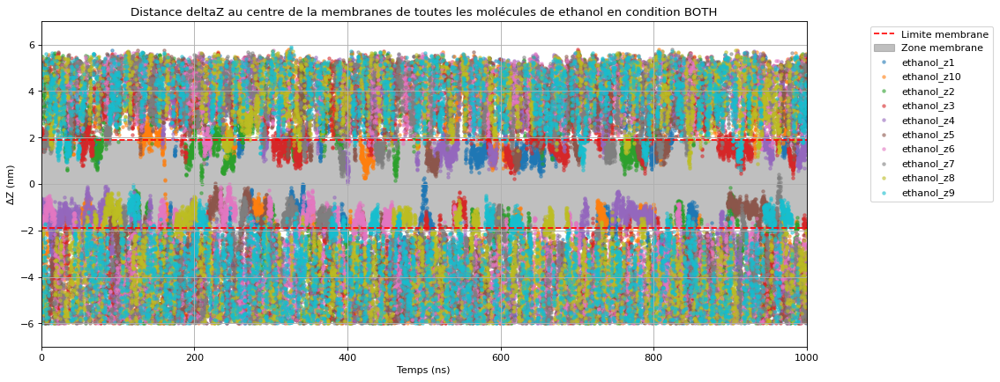

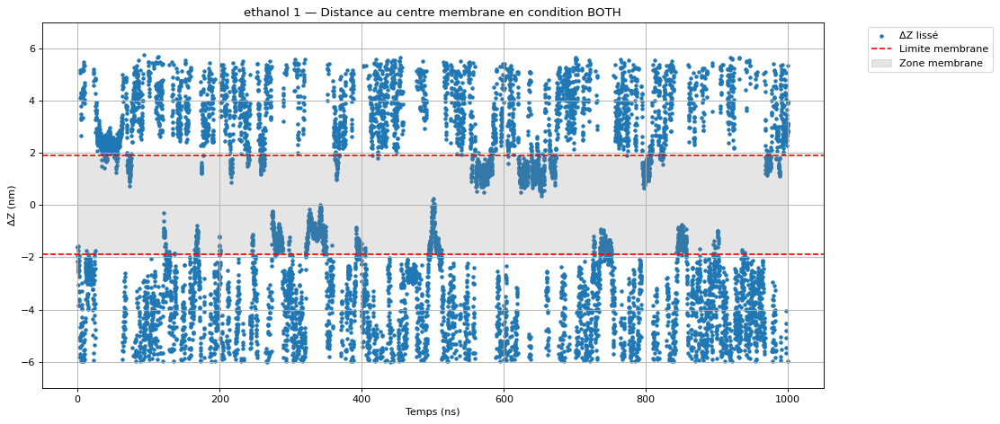

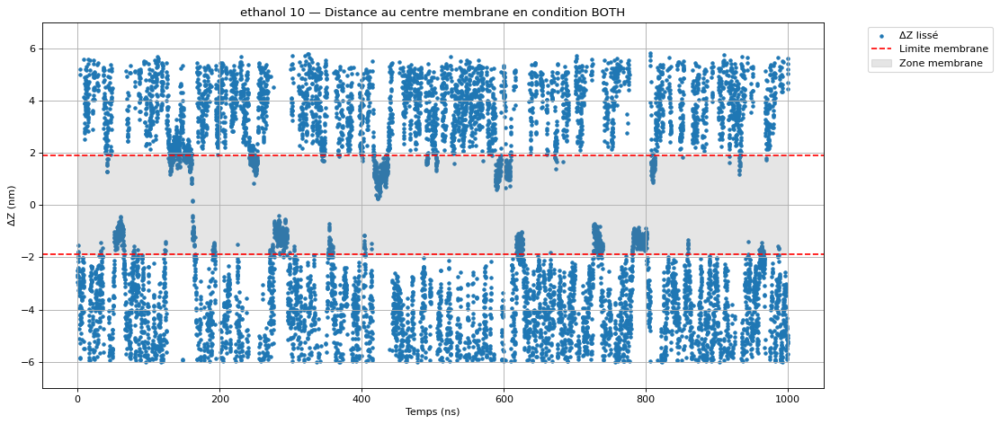

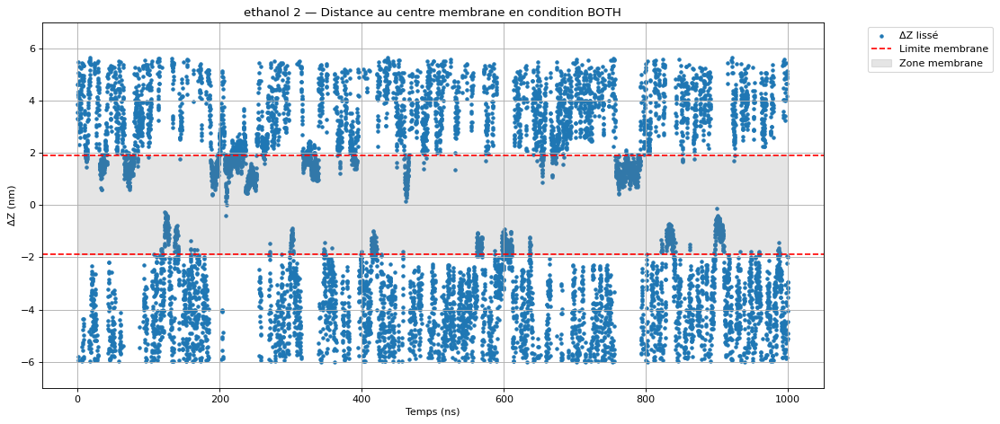

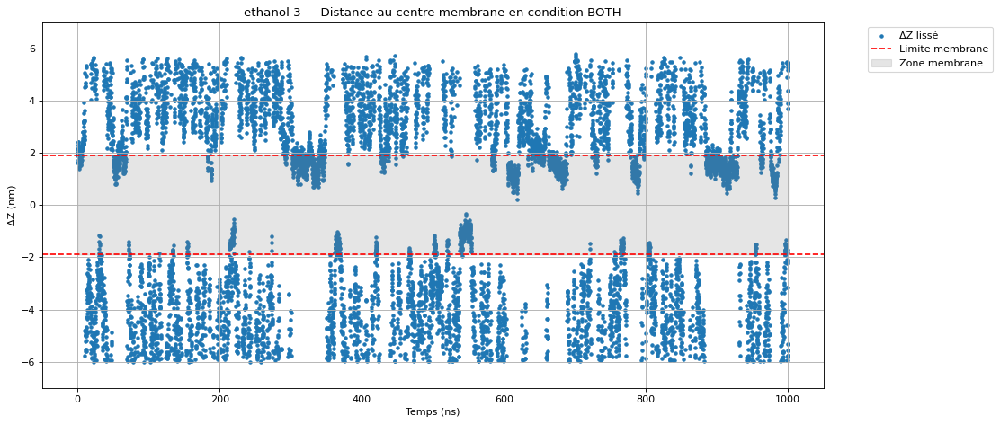

...

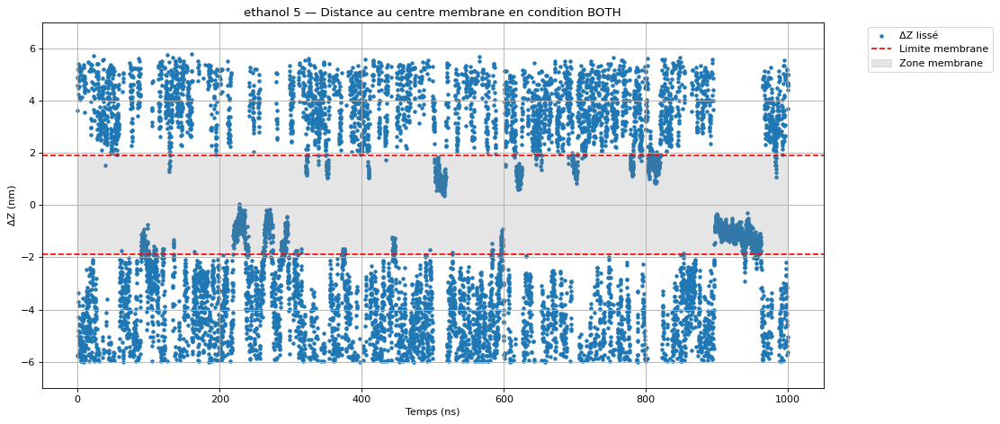

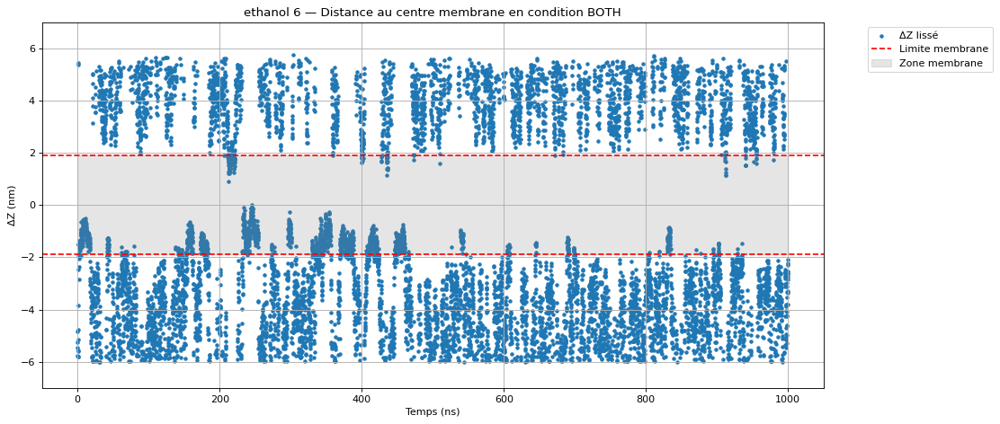

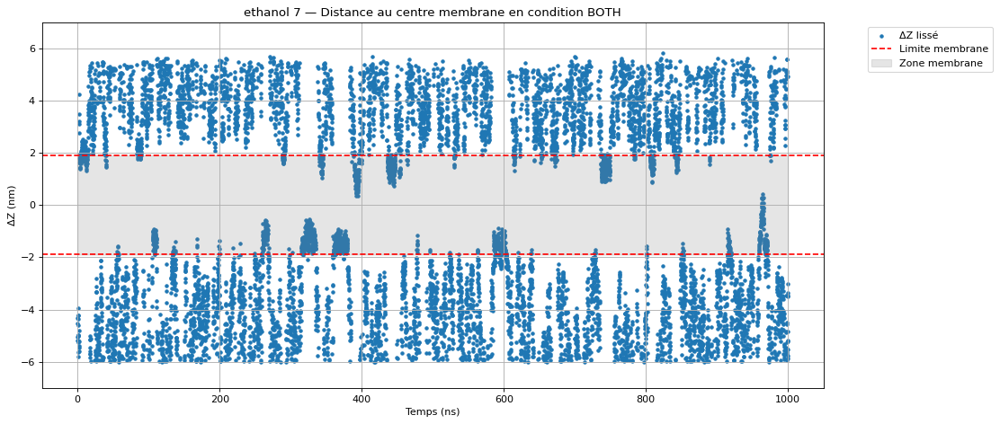

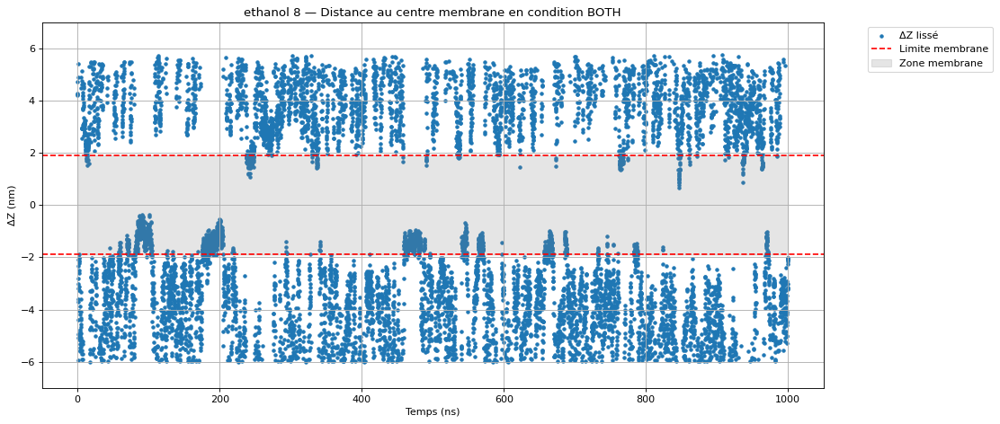

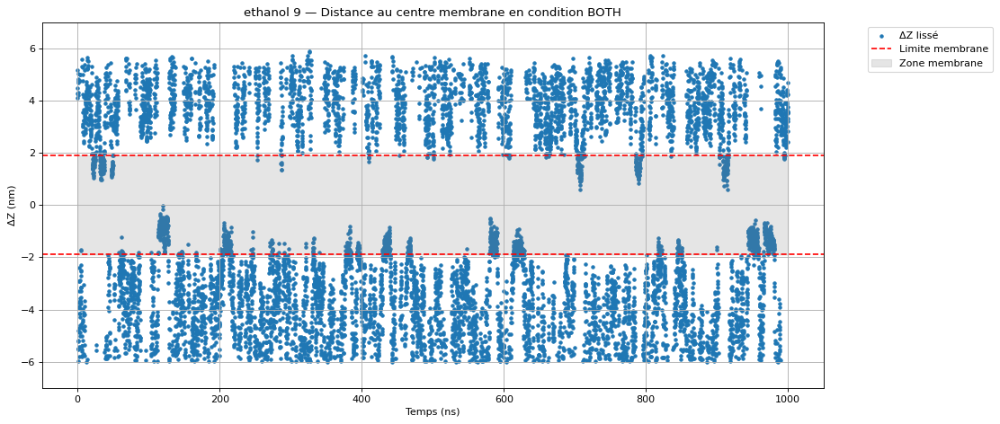

In [27]:
#ETOH dans BOTH
trajetZ(BOTH_ETOH_traj_files, "ethanol", "BOTH")

Le programme qui suit a pour objectif de compter le nombre de diffusion d'éthylène à travers la membrane. 

In [28]:
# Bornes de la membrane (en nm)
z_min = 4.1
z_max = 7.9

def get_transit_times(time, z, zmin=z_min, zmax=z_max):
   #On veut garder que ceux qui entrent d'un coté pour sortir de l'autre coté.
    inside = (z >= zmin) & (z <= zmax)
    crossings = []
    i = 0
    n = len(z)

    while i < n:
        if inside[i]:
            #on commence à l'indice i
            start = i
            # on cherche où on sort de la membrane
            while i < n and inside[i]:
                i += 1
            end = i - 1  # dernier point à l'intérieur

            # indices avant/après
            if start > 0 and end < n-1:
                z_before = z[start-1]
                z_after  = z[end+1]
                # je test si c'est bien allé du bas vers le haut
                if z_before < zmin and z_after > zmax:
                    crossings.append(time[end+1] - time[start-1])
                # ou du haut vers le bas
                elif z_before > zmax and z_after < zmin:
                    crossings.append(time[end+1] - time[start-1])
        else:
            i += 1

    return crossings

    
    #boucle pour chaque fichier xvg
        
def transit_csv(xvg_files):
    
    records = []

    for file in xvg_files:
        by_ethe = []
        
        mol = os.path.splitext(os.path.basename(file))[0]
        data = np.loadtxt(file, comments=('@','#'))
        time = data[:,0] / 1000   # ps → ns
        z    = data[:,3]
    
        for duration in get_transit_times(time, z):
            records.append({'molecule': mol, 'duration': duration})
            by_ethe.append({'molecule': mol, 'duration': duration})
            
        df_temp = pd.DataFrame(by_ethe)
        moy = df_temp['duration'].mean()
        sd = df_temp['duration'].std()
        nb = len(by_ethe)
        print(f"{mol} diffuse {nb} fois et met en moyenne {moy:.2f} ns ± {sd:.2f} ns")
        
    df = pd.DataFrame(records, columns=['molecule','duration'])

    df.loc[len(df)] = ['Moyenne', df['duration'].mean()]
    df.loc[len(df)] = ['Ecart-type',df['duration'].std()]

    return(df)


In [29]:
ETHE_mean_duration_of_one_diffusion = transit_csv(ETHE_traj_files)
ETHE_mean_duration_of_one_diffusion

ethylene_z1 diffuse 11 fois et met en moyenne 17.66 ns ± 16.18 ns
ethylene_z10 diffuse 12 fois et met en moyenne 26.21 ns ± 20.18 ns
ethylene_z2 diffuse 14 fois et met en moyenne 24.62 ns ± 18.32 ns
ethylene_z3 diffuse 15 fois et met en moyenne 24.57 ns ± 20.15 ns
ethylene_z4 diffuse 4 fois et met en moyenne 15.30 ns ± 7.33 ns
ethylene_z5 diffuse 13 fois et met en moyenne 17.48 ns ± 9.72 ns
ethylene_z6 diffuse 17 fois et met en moyenne 17.35 ns ± 11.54 ns
ethylene_z7 diffuse 13 fois et met en moyenne 19.64 ns ± 21.93 ns
ethylene_z8 diffuse 11 fois et met en moyenne 24.15 ns ± 48.08 ns
ethylene_z9 diffuse 12 fois et met en moyenne 19.08 ns ± 14.07 ns


,molecule,duration
0,ethylene_z1,4.500000
1,ethylene_z1,27.000000
2,ethylene_z1,52.200000
3,ethylene_z1,16.900000
4,ethylene_z1,4.300000
...,...,...
119,ethylene_z9,12.800000
120,ethylene_z9,45.200000
121,ethylene_z9,5.700000
122,Moyenne,20.947541


In [30]:
BOTH_mean_duration_of_one_diffusion = transit_csv(BOTH_ETHE_traj_files)
BOTH_mean_duration_of_one_diffusion

ethylene_z1 diffuse 10 fois et met en moyenne 18.92 ns ± 11.54 ns
ethylene_z10 diffuse 13 fois et met en moyenne 19.42 ns ± 19.82 ns
ethylene_z2 diffuse 6 fois et met en moyenne 15.13 ns ± 8.04 ns
ethylene_z3 diffuse 8 fois et met en moyenne 34.38 ns ± 34.14 ns
ethylene_z4 diffuse 11 fois et met en moyenne 16.06 ns ± 14.07 ns
ethylene_z5 diffuse 2 fois et met en moyenne 7.20 ns ± 3.11 ns
ethylene_z6 diffuse 13 fois et met en moyenne 20.33 ns ± 21.63 ns
ethylene_z7 diffuse 12 fois et met en moyenne 18.91 ns ± 16.17 ns
ethylene_z8 diffuse 15 fois et met en moyenne 19.02 ns ± 27.69 ns
ethylene_z9 diffuse 13 fois et met en moyenne 14.16 ns ± 6.53 ns


,molecule,duration
0,ethylene_z1,7.400000
1,ethylene_z1,21.000000
2,ethylene_z1,10.200000
3,ethylene_z1,20.100000
4,ethylene_z1,41.900000
...,...,...
100,ethylene_z9,15.500000
101,ethylene_z9,23.000000
102,ethylene_z9,16.500000
103,Moyenne,19.021359


Visualisation de l'évolution des rayons de gyration en fonction du temps de simulation : 


In [31]:
def visualisation_gyr(gyr_files, condition= "?") :
    i= 0
    colors= ['darkviolet','pink','mediumvioletred']
    #labels = ['bas', 'haut','milieu']
    plt.figure(figsize = (25,7))
    for file in gyr_files : 
        data = np.loadtxt(file, comments=['@', '#'])
        time = data[:,0]/1000
        rg = data[:,1]
        filename = os.path.basename(file)
        clean_name = filename.replace("gyration_", "").replace(".xvg", "")
        plt.plot(time, rg,alpha = 0.5, color = colors[i], label = clean_name)
        i += 1
    plt.legend()
    plt.xlabel('Temps (ns)')
    plt.xlim(0,1000)
    plt.grid()
    plt.ylabel('Rayon de giration (nm)')
    plt.title(f'Respiration de la protéine en condition {condition}')
    plt.show()

['alone/gyration_bas.xvg', 'alone/gyration_haut.xvg', 'alone/gyration_milieu.xvg']


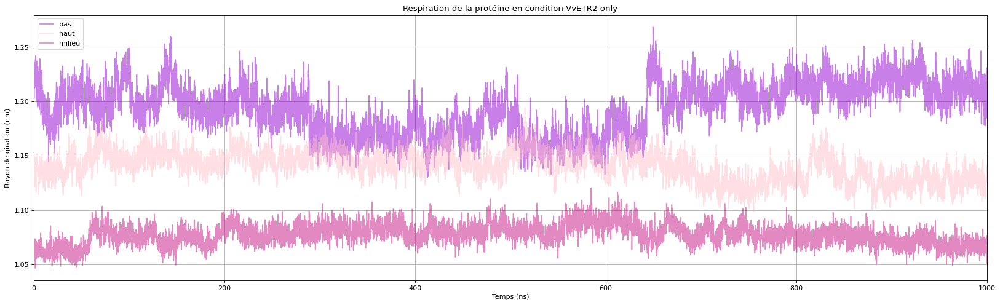

In [32]:
alone_gyr = sorted(glob.glob(os.path.join(ALONE_outdir, "gyration_*.xvg")))
print(alone_gyr)
visualisation_gyr(alone_gyr,"VvETR2 only")

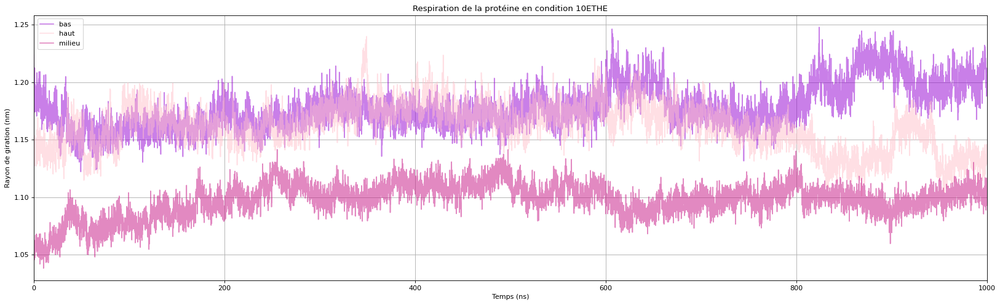

In [33]:
ethe_gyr = sorted(glob.glob(os.path.join(ETHE_outdir, "gyration_*.xvg")))
visualisation_gyr(ethe_gyr,"10ETHE")

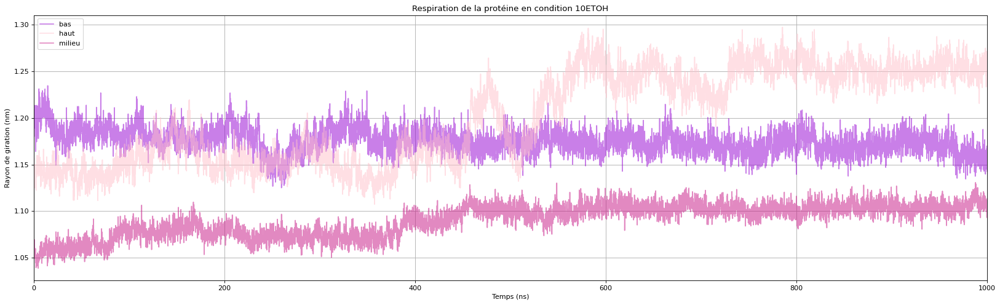

In [34]:
etoh_gyr = sorted(glob.glob(os.path.join(ETOH_outdir, "gyration_*.xvg")))
visualisation_gyr(etoh_gyr,"10ETOH")

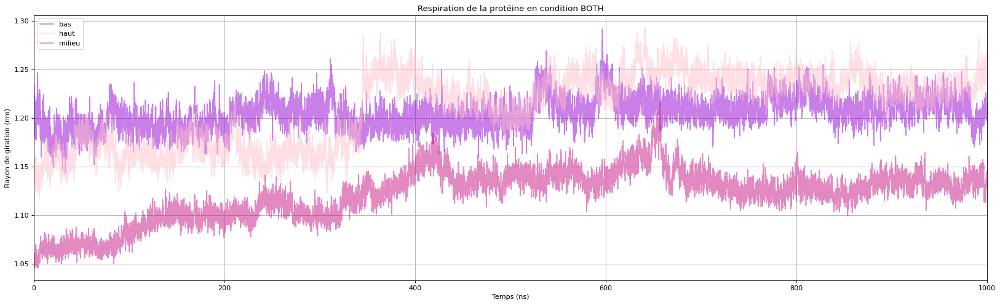

In [35]:
both_gyr = sorted(glob.glob(os.path.join(BOTH_outdir, "gyration_*.xvg")))
visualisation_gyr(both_gyr,"BOTH")

Calcul pour voir si nous avons potentiellement des changement significatif entre les conditions qui possèdent de l'éthanol et celles qui n'en possèdent pas.

In [36]:
def moyenne_gyration_histo(files, labels, localisation = "?"):
    moyennes = []
    ecarts = []
    colors = ["black","red","green","blue"]
    for f in files:
        data = np.loadtxt(f, comments=['@', '#'])
        rg = data[:, 1]
        mean_rg = np.mean(rg)
        std_rg = np.std(rg)
        moyennes.append(mean_rg)
        ecarts.append(std_rg)
        print(f"{f} → Moyenne : {mean_rg:.4f} nm | Écart-type : {std_rg:.4f} nm")

    # Affichage en barres
    x = np.arange(len(files))
    plt.figure(figsize=(12, 5))
    plt.bar(x, moyennes, yerr=ecarts, capsize=5, color=colors, width=0.4)
    plt.xticks(x, labels, rotation=45)
    plt.ylabel("Rayon de giration (nm)")
    plt.title(f"Moyenne du Rg par condition se situant {localisation} de la protéine")
    plt.grid(True, axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()



alone/gyration_haut.xvg → Moyenne : 1.1408 nm | Écart-type : 0.0134 nm
ethylene/gyration_haut.xvg → Moyenne : 1.1611 nm | Écart-type : 0.0195 nm
ethanol/gyration_haut.xvg → Moyenne : 1.2008 nm | Écart-type : 0.0493 nm
both/gyration_haut.xvg → Moyenne : 1.2109 nm | Écart-type : 0.0363 nm


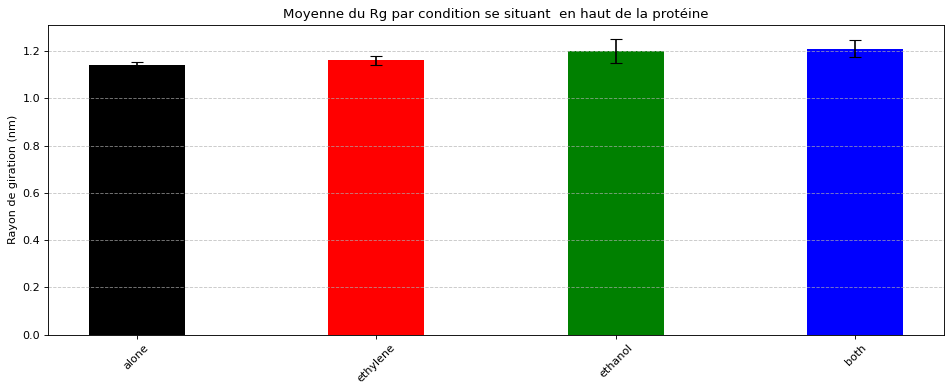

In [37]:
haut = ("alone/gyration_haut.xvg","ethylene/gyration_haut.xvg", "ethanol/gyration_haut.xvg", "both/gyration_haut.xvg")
labels = ("alone","ethylene", "ethanol", "both")
moyenne_gyration_histo(haut,labels," en haut")

alone/gyration_milieu.xvg → Moyenne : 1.0775 nm | Écart-type : 0.0095 nm
ethylene/gyration_milieu.xvg → Moyenne : 1.0975 nm | Écart-type : 0.0147 nm
ethanol/gyration_milieu.xvg → Moyenne : 1.0902 nm | Écart-type : 0.0169 nm
both/gyration_milieu.xvg → Moyenne : 1.1210 nm | Écart-type : 0.0263 nm


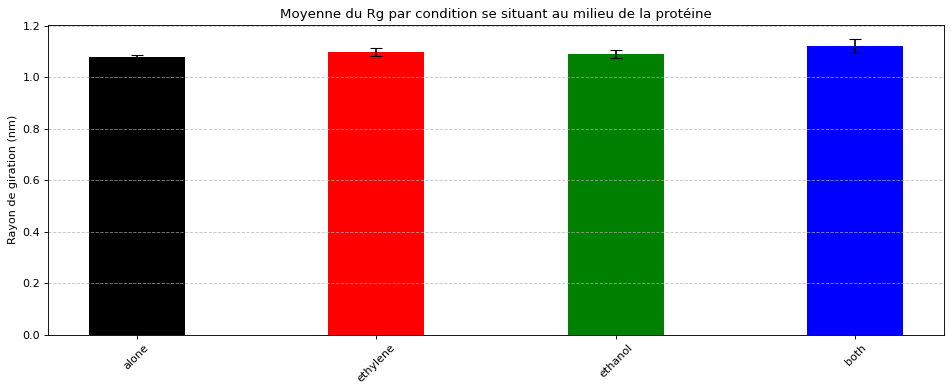

In [38]:
milieu = ("alone/gyration_milieu.xvg","ethylene/gyration_milieu.xvg", "ethanol/gyration_milieu.xvg", "both/gyration_milieu.xvg")
moyenne_gyration_histo(milieu,labels,"au milieu")

alone/gyration_bas.xvg → Moyenne : 1.1939 nm | Écart-type : 0.0232 nm
ethylene/gyration_bas.xvg → Moyenne : 1.1783 nm | Écart-type : 0.0193 nm
ethanol/gyration_bas.xvg → Moyenne : 1.1752 nm | Écart-type : 0.0135 nm
both/gyration_bas.xvg → Moyenne : 1.2052 nm | Écart-type : 0.0164 nm


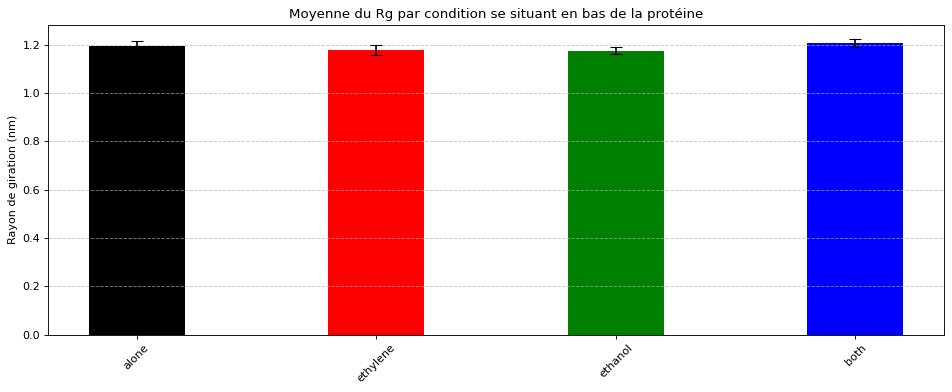

In [39]:
bas = ("alone/gyration_bas.xvg","ethylene/gyration_bas.xvg", "ethanol/gyration_bas.xvg", "both/gyration_bas.xvg")
moyenne_gyration_histo(bas,labels,"en bas")

Comme j'ai remarqué que c'était surtout sur la seconde moitié que les changements ont l'air de se voir, je vais visualiser cela. 

In [40]:
def filtre_temps_xvg(files, tmin=None, tmax=None):
    all_data = []
    for file in files:
        data = []
        with open(file, 'r') as f:
            for line in f:
                line = line.strip()
                if line.startswith('@') or line.startswith('#'):
                    continue
                elif line:
                    parts = line.split()
                    time = float(parts[0])
                    if ((tmin is None or time >= tmin) and
                        (tmax is None or time <= tmax)):
                        data.append([float(x) for x in parts])
        data_array = np.array(data)
        all_data.append(data_array)
    return all_data


In [41]:
haut_600derniers = filtre_temps_xvg(haut, tmin=600_000)
milieu_600derniers = filtre_temps_xvg(milieu, tmin=600_000)
bas_600derniers = filtre_temps_xvg(bas, tmin=600_000)


In [42]:
def moyenne_gyration_histo_array(files, labels, localisation="?"):
    moyennes = []
    ecarts = []
    colors = ["black","red","green","blue"]
    for i in range(0,4):
        rg = files[i][:,1]
        mean_rg = rg.mean()
        std_rg = rg.std()
        moyennes.append(mean_rg)
        ecarts.append(std_rg)
        print(f"→ Moyenne : {mean_rg:.4f} nm | Écart-type : {std_rg:.4f} nm")

    # Affichage en barres
    x = np.arange(len(files))
    plt.figure(figsize=(12, 5))
    plt.bar(x, moyennes, yerr=ecarts, capsize=5, color=colors, width=0.4)
    plt.xticks(x, labels, rotation=45)
    plt.ylabel("Rayon de giration (nm)")
    plt.title(f"Moyenne du Rg par condition se situant {localisation} de la proteine")
    plt.grid(True, axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


→ Moyenne : 1.1320 nm | Écart-type : 0.0128 nm
→ Moyenne : 1.1523 nm | Écart-type : 0.0196 nm
→ Moyenne : 1.2491 nm | Écart-type : 0.0152 nm
→ Moyenne : 1.2384 nm | Écart-type : 0.0135 nm


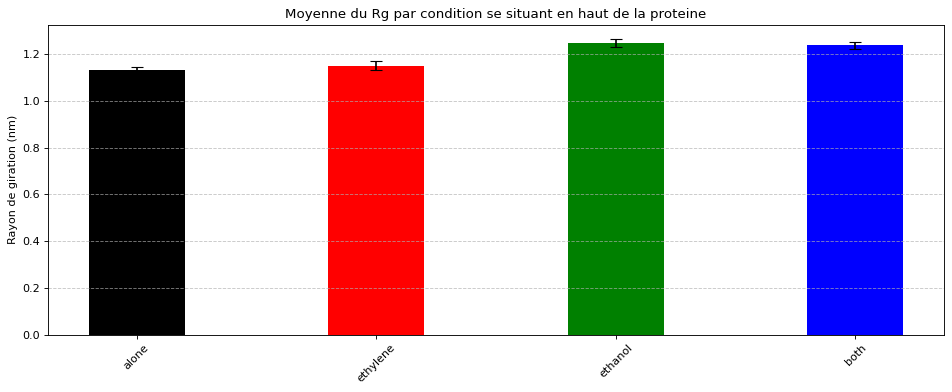

In [43]:
moyenne_gyration_histo_array(haut_600derniers, labels,"en haut")

→ Moyenne : 1.0762 nm | Écart-type : 0.0093 nm
→ Moyenne : 1.0975 nm | Écart-type : 0.0095 nm
→ Moyenne : 1.1035 nm | Écart-type : 0.0073 nm
→ Moyenne : 1.1352 nm | Écart-type : 0.0151 nm


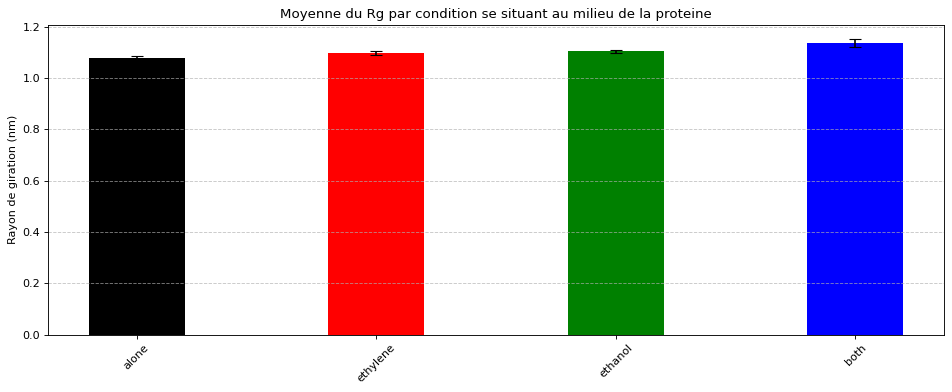

In [44]:
moyenne_gyration_histo_array(milieu_600derniers, labels,"au milieu")


→ Moyenne : 1.2078 nm | Écart-type : 0.0184 nm
→ Moyenne : 1.1918 nm | Écart-type : 0.0193 nm
→ Moyenne : 1.1708 nm | Écart-type : 0.0113 nm
→ Moyenne : 1.2128 nm | Écart-type : 0.0131 nm


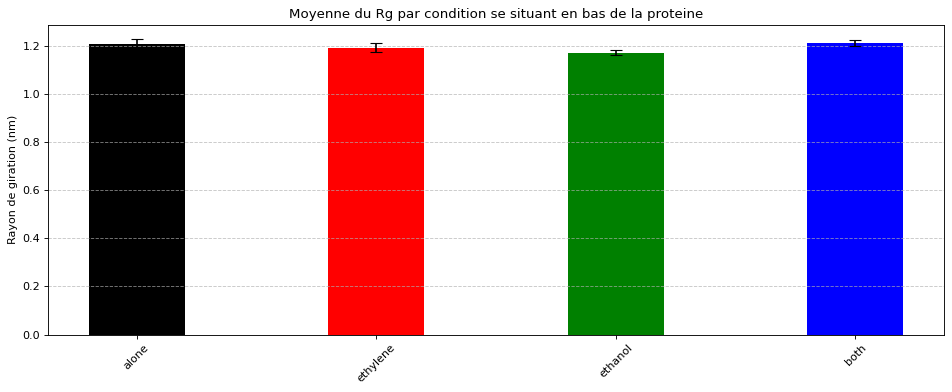

In [45]:
moyenne_gyration_histo_array(bas_600derniers, labels,"en bas")

Il semble y avoir des changement significatif. J'aimerai donc repérer sur quelles composantes.


In [46]:
def moyenne_gyration_histo_array_xyz(files, labels, color, localisation="?"):
    moyennes = []
    ecarts = []

    for j in range(1, 5):
        for i in range(len(files)):
            rg = files[i][:, j]
            moyennes.append(rg.mean())
            ecarts.append(rg.std())

    x = np.arange(len(moyennes))  # ici 16
    plt.figure(figsize=(16, 6))
    plt.bar(x, moyennes, yerr=ecarts, capsize=5, color=colors[:len(moyennes)], width=0.6)
    plt.xticks(x, labels, rotation=45, ha='right')
    plt.ylabel("Rayon de giration (nm)")
    plt.title(f"Moyenne du Rg par condition - {localisation}")
    plt.grid(True, axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


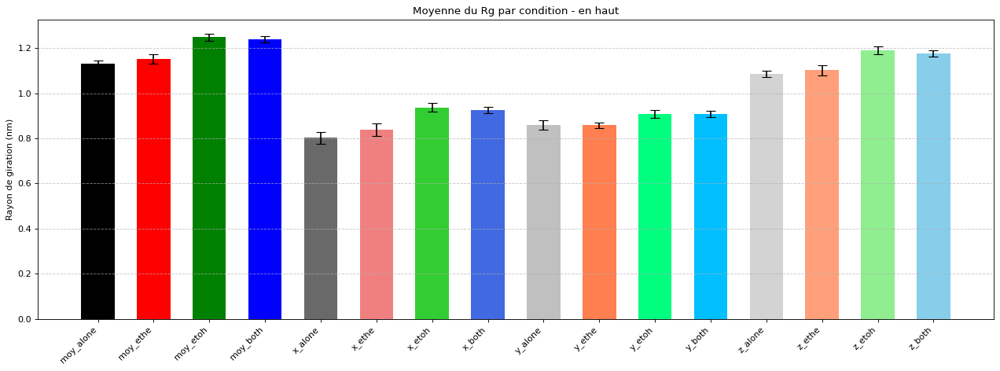

In [47]:
label2 = ["moy_alone", "moy_ethe","moy_etoh","moy_both","x_alone", "x_ethe","x_etoh","x_both","y_alone", "y_ethe","y_etoh","y_both","z_alone", "z_ethe","z_etoh","z_both"]
colors = ["black","red", "green","blue", "dimgrey","lightcoral","limegreen", "royalblue","silver","coral", "springgreen","deepskyblue","lightgrey",  "lightsalmon",  "lightgreen","skyblue"]

moyenne_gyration_histo_array_xyz(haut_600derniers, label2,colors, "en haut")

C'est les 3 axes, mais surtout le x et le z contribuent au fait que le rayon de gyration pour les modèles avec ethanol ont un rayon de gyration plus élevé sur la seconde partie de la simulation. 

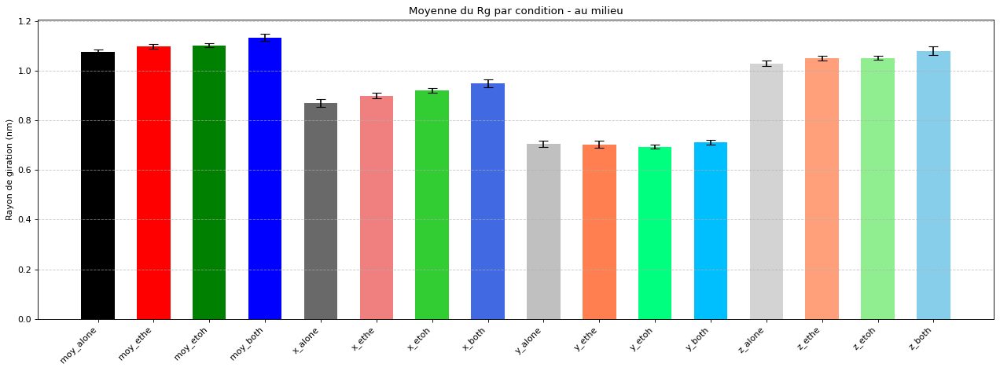

In [48]:
label2 = ["moy_alone", "moy_ethe","moy_etoh","moy_both","x_alone", "x_ethe","x_etoh","x_both","y_alone", "y_ethe","y_etoh","y_both","z_alone", "z_ethe","z_etoh","z_both"]
colors = ["black","red", "green","blue", "dimgrey","lightcoral","limegreen", "royalblue","silver","coral", "springgreen","deepskyblue","lightgrey",  "lightsalmon",  "lightgreen","skyblue"]

moyenne_gyration_histo_array_xyz(milieu_600derniers, label2,colors, "au milieu")

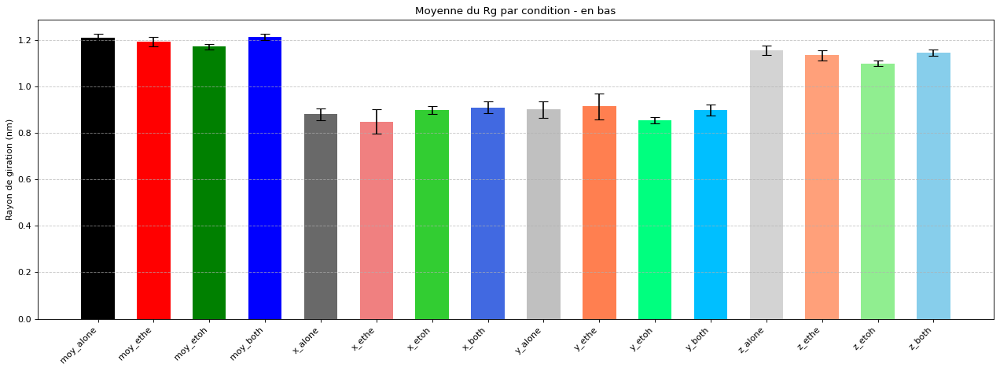

In [49]:
label2 = ["moy_alone", "moy_ethe","moy_etoh","moy_both","x_alone", "x_ethe","x_etoh","x_both","y_alone", "y_ethe","y_etoh","y_both","z_alone", "z_ethe","z_etoh","z_both"]
colors = ["black","red", "green","blue", "dimgrey","lightcoral","limegreen", "royalblue","silver","coral", "springgreen","deepskyblue","lightgrey",  "lightsalmon",  "lightgreen","skyblue"]

moyenne_gyration_histo_array_xyz(bas_600derniers, label2,colors, "en bas")

Partie Helanal : 

h = hel.HELANAL(u, select='name CA and resnum 161-187',
                ref_axis=[0, 0, 1]).run()
    
    dict_keys(['local_twists', 'local_bends', 'local_heights', 'local_nres_per_turn', 'local_origins', 'local_axes', 'local_helix_directions', 'local_screw_angles', 'global_axis', 'global_tilts', 'all_bends'])



    local_twists :
    L’angle de torsion local entre les unités consécutives (par exemple entre résidus ou paires de bases) — combien la structure tourne autour de son axe à cet endroit précis.

    local_bends :
    L’angle de courbure locale — combien la structure se plie à un point donné.

    local_heights :
    La hauteur locale, c’est-à-dire la distance de translation le long de l’axe hélicoïdal entre unités consécutives.

    local_nres_per_turn :
    Le nombre local de résidus (ou unités) par tour d’hélice — ça donne la "densité" locale de la spirale.

    local_origins :
    Les points d’origine locaux (coordonnées) à chaque segment — où commence la portion locale considérée.

    local_axes :
    L’axe local (vecteur) de l’hélice à chaque portion — la direction instantanée de l’axe de la spirale.

    local_helix_directions :
    La direction locale de l’hélice (probablement un vecteur normalisé) à chaque segment, indiquant l’orientation précise.

    local_screw_angles :
    L’angle de vis local, combinant rotation et translation — c’est le paramètre décrivant la transformation hélicoïdale locale entre segments.

    global_axis :
    L’axe global de l’hélice, moyenne de l’axe principal de la structure hélicoïdale entière.

    global_tilts :
    Les angles d’inclinaison ou de basculement globaux par rapport à une référence (ex : l’axe z), indiquant comment l’hélice est orientée dans l’espace.
    
    all_bends :
    Tous les angles de courbure calculés le long de la structure


Par exemple pour avoir le 3 ème angle de local twist de la frame 10 je dois faire : 
resultat_helanal[9]['local_twists'][2]



ET si j'ai plusieurs hélices : 

helanal2 = hel.HELANAL(u, select=('name CA and resnum 100-160',
                                  'name CA and resnum 200-230'))

resultat_helanal[9]['local_twists'][1][2]

9 = frame 10 

[1] = deuxième hélice 

[2] = segment 3 dans cette hélice


mes hélices : 
    
    (18, 49),
    
    (55, 77),  
    
    (84, 117), 
    
    (138, 169),

    (175, 197),
    
    (204, 237)


In [50]:
helix_1 = ('name CA and resid 18-49')

helix_2 = ('name CA and resid 55-77')

helix_3 = ('name CA and resid 84-117')

helix_4 = ('name CA and resid 138-169')

helix_5 = ('name CA and resid 175-197')

helix_6 = ('name CA and resid 204-237')

all_helix = ('name CA and resid 18-49','name CA and resid 55-77','name CA and resid 84-117','name CA and resid 138-169', 'name CA and resid 175-197','name CA and resid 204-237')


In [51]:
def analyse_helanal(tpr, fit, helix, condition = "?"):
    all_local_bends = []

    u = mda.Universe(tpr,fit) 
    #il faut le faire là sinon ça repart toujours toujours toujours à 0
    result = hel.HELANAL(u, select=(helix,))
    result.run()

    #Je pense que tout les 100 points ça suffit quand même
    for i, ts in enumerate(u.trajectory[::100]):
        bends = np.array(result.results.local_bends[i])
        all_local_bends.append(bends)

    local_bends_array = np.array(all_local_bends)
    #plt.figure(figsize=(10,6))
    plt.imshow(local_bends_array.T, aspect='auto', cmap='viridis')
    plt.colorbar(label='Angle de courbure (degrés)')
    plt.xlabel('Frame')
    plt.ylabel('Segment')
    plt.title(f'Évolution des courbures locales au cours du temps en condition {condition} sur {helix}')
    plt.show()  


    means = local_bends_array.mean(axis=0)   # moyenne par segment
    stds = local_bends_array.std(axis=0)     # écart-type par segment
    
    segments = np.arange(len(means))
    
    #plt.figure(figsize=(10,6))
    plt.errorbar(segments, means, yerr=stds, fmt='-o', ecolor='r', capsize=5)
    plt.xlabel('Segment')
    plt.ylabel('Angle moyen de courbure (°)')
    plt.title(f'Courbure locale moyenne avec écart-type, condition {condition}')
    plt.show()

    return(means, stds)

In [52]:
def plot_par_helice(dico1, dico2,dico3,dico4):
    
    conditions = {
    "alone": dico1,
    "ETHE": dico2,
    "ETOH": dico3,
    "BOTH": dico4
}
    colors = ['black', 'red', 'green', 'blue']
    
    for i in range (1,7):
        helix_key = f"helix_{i}"
        plt.figure(figsize=(12,6))

        for cond_name, cond_dict, color in zip(conditions.keys(), conditions.values(), colors):
            means, stds = cond_dict[helix_key]  # on récupère les deux arrays retournés
            x = np.arange(len(means))           # index (par exemple segments ou frames)
            plt.errorbar(x, means, yerr=stds, label=cond_name, color=color, capsize=3)

        plt.xlabel('Segment')
        plt.ylabel('Moyenne')
        plt.title(f' moyenne ± écart-type pour {helix_key} selon condition')
        plt.legend()
        plt.show()

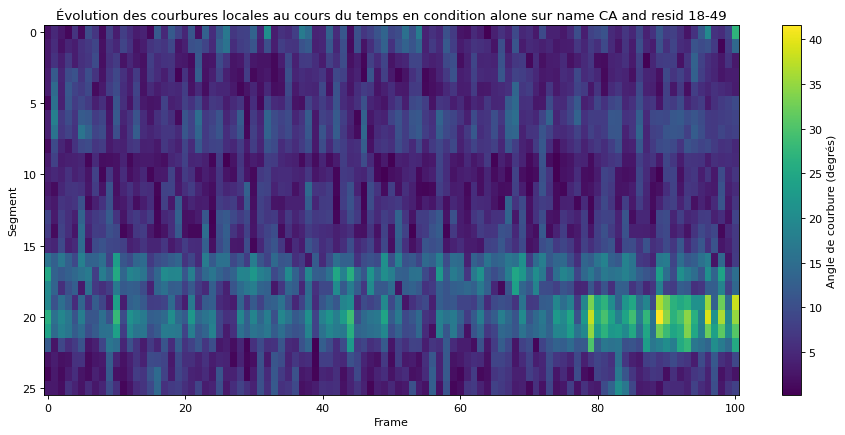

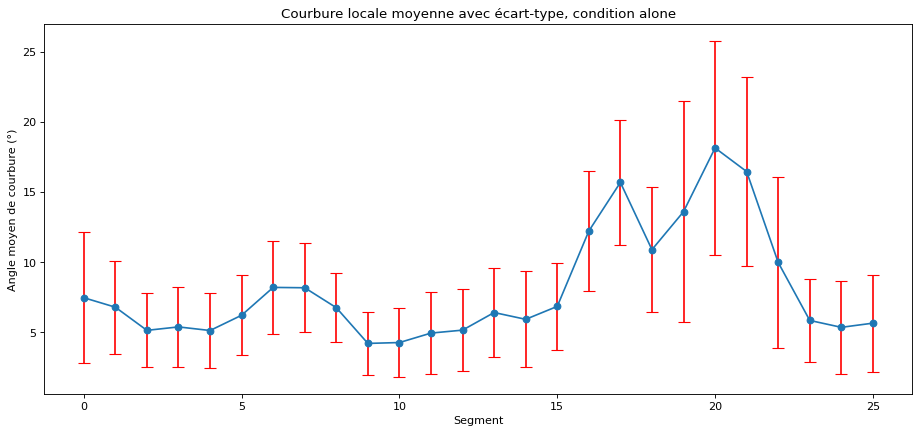

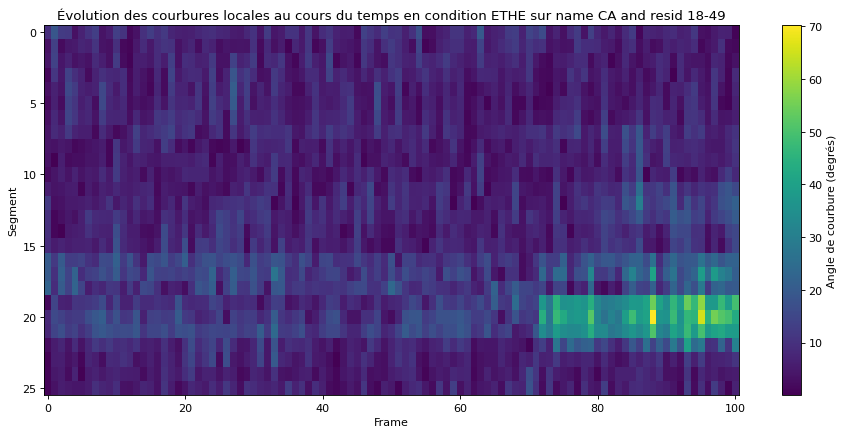

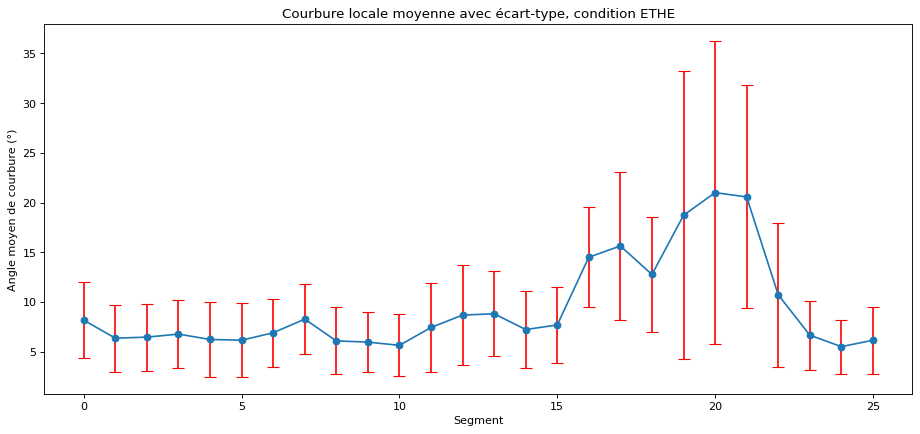

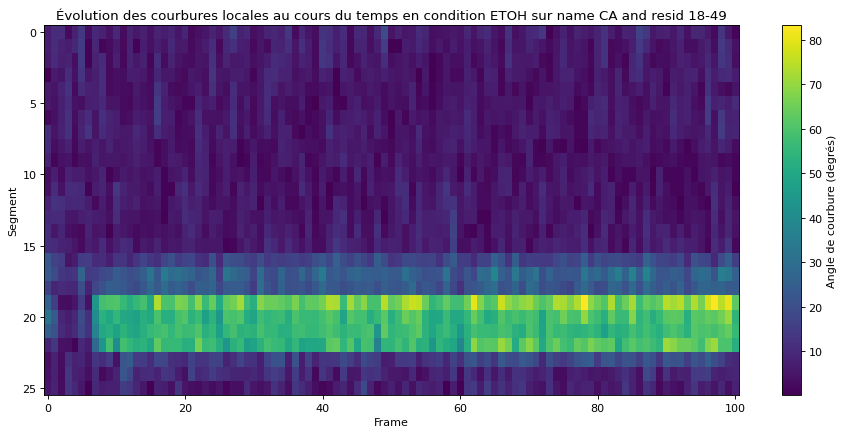

...

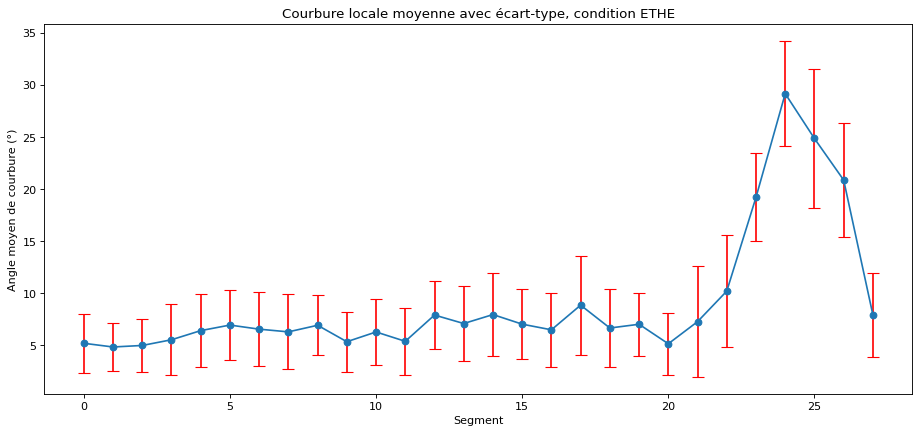

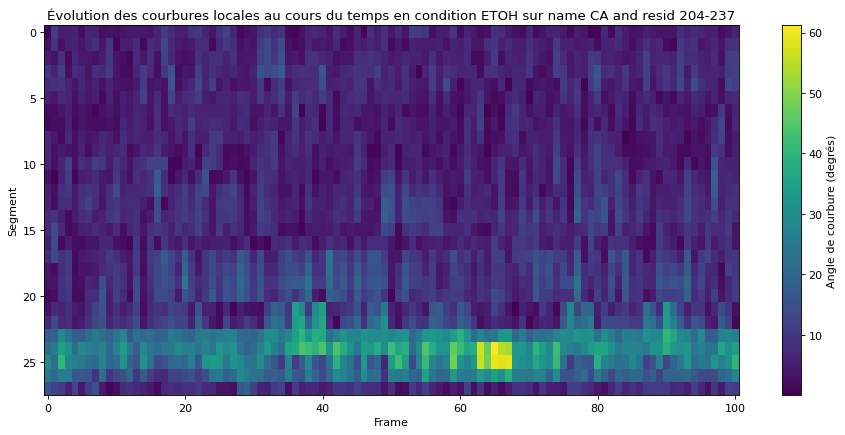

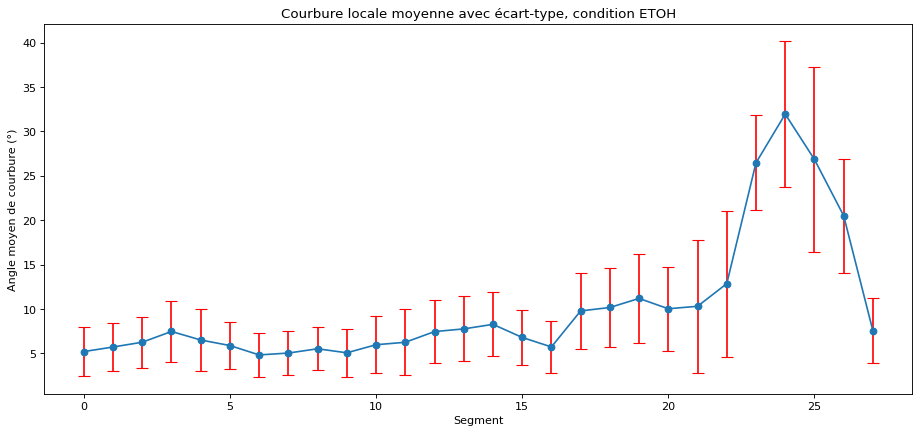

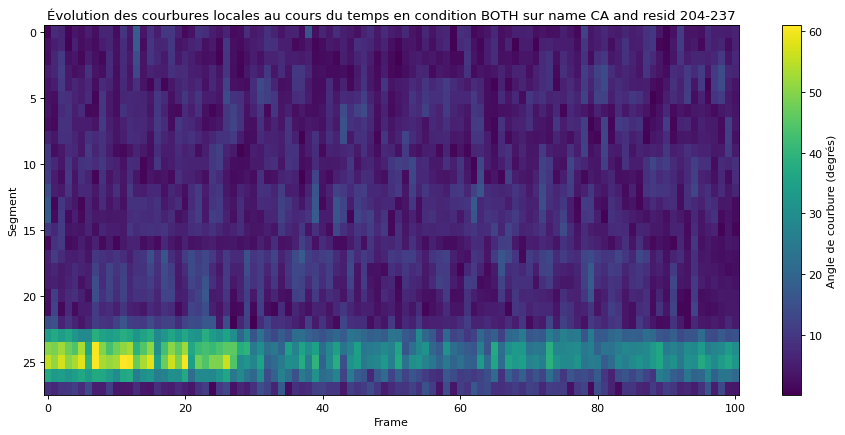

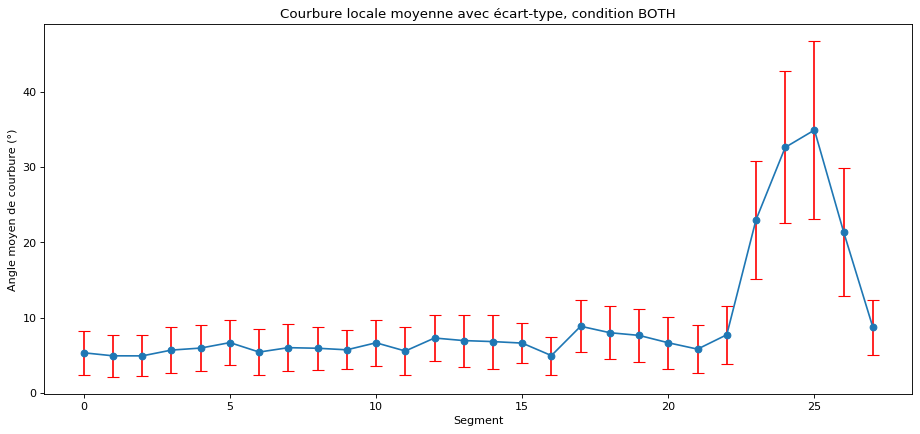

In [53]:
alone_results = {}
ETHE_results = {}
ETOH_results = {}
BOTH_results = {}

for i, helix in enumerate(all_helix, start=1):
    alone_results[f"helix_{i}"] = analyse_helanal(ALONE_tpr, ALONE_fit, helix, "alone")
    ETHE_results[f"helix_{i}"] = analyse_helanal(ETHE_tpr, ETHE_fit, helix,"ETHE")
    ETOH_results[f"helix_{i}"] = analyse_helanal(ETOH_tpr, ETOH_fit, helix,"ETOH")
    BOTH_results[f"helix_{i}"] = analyse_helanal(BOTH_tpr, BOTH_fit, helix,"BOTH")
    

Maintenant je veux faire un plot pour chaque hélices avec les moyennes et ecarts types dans chaque condition.

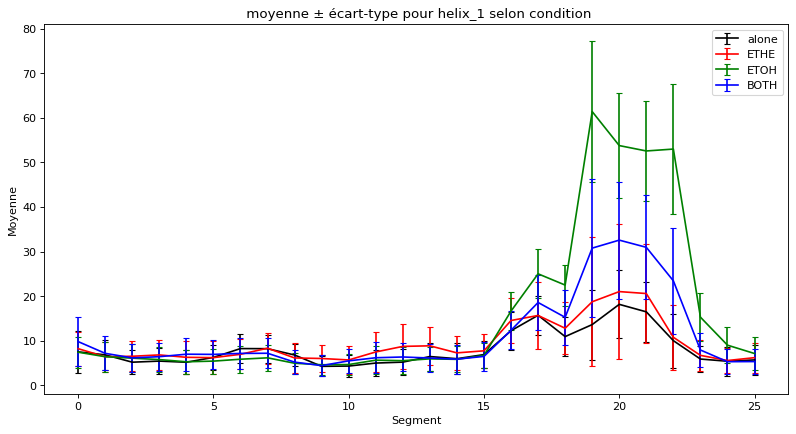

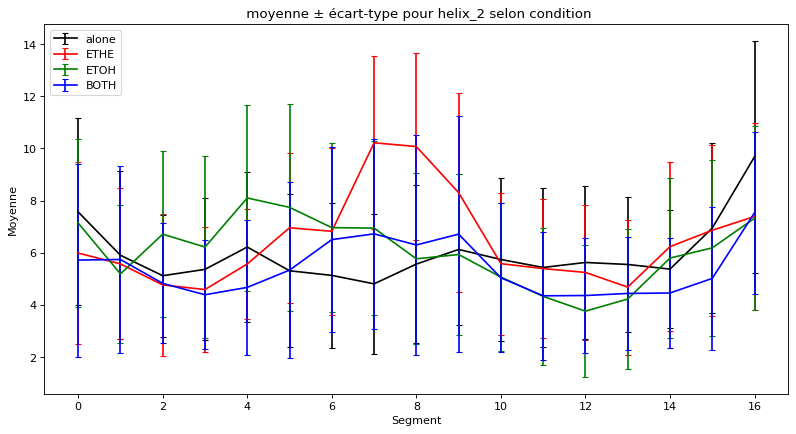

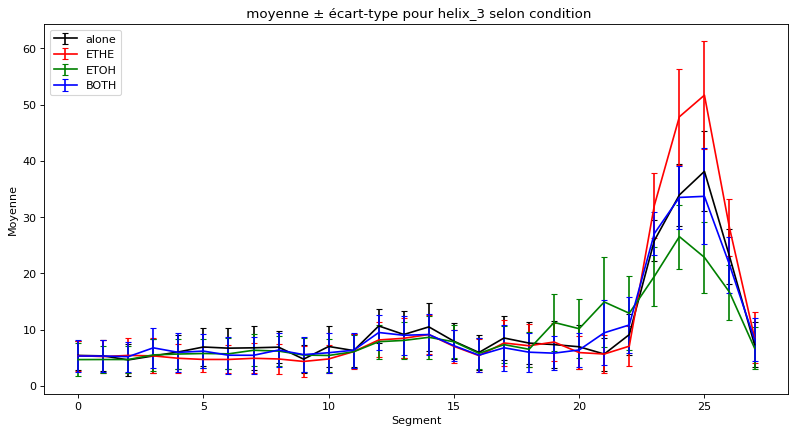

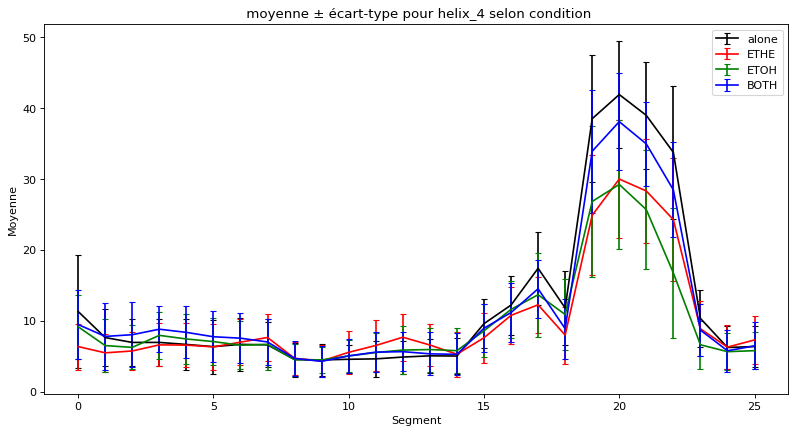

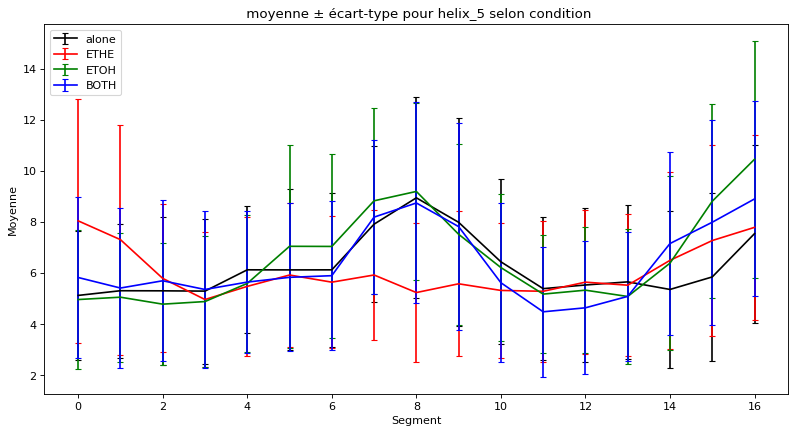

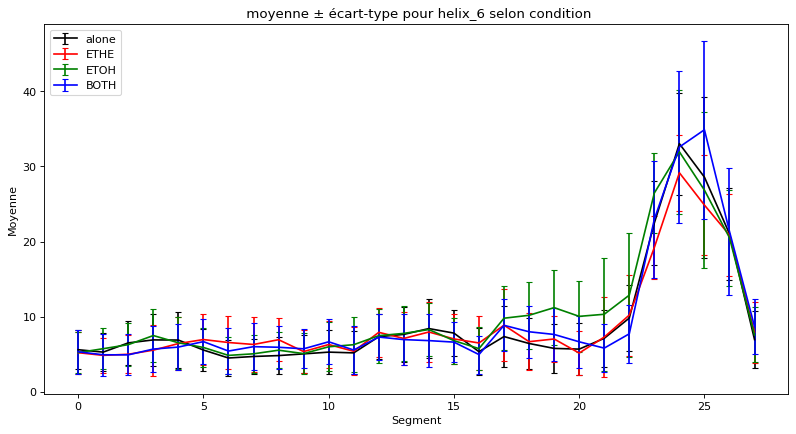

In [54]:
plot_par_helice(alone_results, ETHE_results, ETOH_results, BOTH_results)

In [55]:
def analyse_helanal_twists(tpr, fit, helix, condition = "?"):
    all_twists = []
    all_screw = []
    
    u = mda.Universe(tpr,fit) 
    #il faut le faire là sinon ça repart toujours toujours toujours à 0
    result = hel.HELANAL(u, select=(helix,))
    result.run()

    #Je pense que tout les 100 points ça suffit quand même
    for i, ts in enumerate(u.trajectory[::100]):
        twist = np.array(result.results.local_twists[i])
        all_twists.append(twist)
        

    local_twists_array = np.array(all_twists)
    
    #plt.figure(figsize=(10,6))
    plt.imshow(local_twists_array.T, aspect='auto', cmap='viridis')
    plt.colorbar(label='Angle de la torsion locale (degrés)')
    plt.xlabel('Frame')
    plt.ylabel('Segment')
    plt.title(f'Évolution des locals twists au cours du temps en condition {condition} sur {helix}')
    plt.show()  


    means = local_twists_array.mean(axis=0)   # moyenne par segment
    stds = local_twists_array.std(axis=0)     # écart-type par segment
    
    segments = np.arange(len(means))
    
    #plt.figure(figsize=(10,6))
    plt.errorbar(segments, means, yerr=stds, fmt='-o', ecolor='r', capsize=5)
    plt.xlabel('Segment')
    plt.ylabel('Angle moyen de la torsion locale (°)')
    plt.title(f'local twist moyen avec écart-type, condition {condition}')
    plt.show()


    return(means, stds)


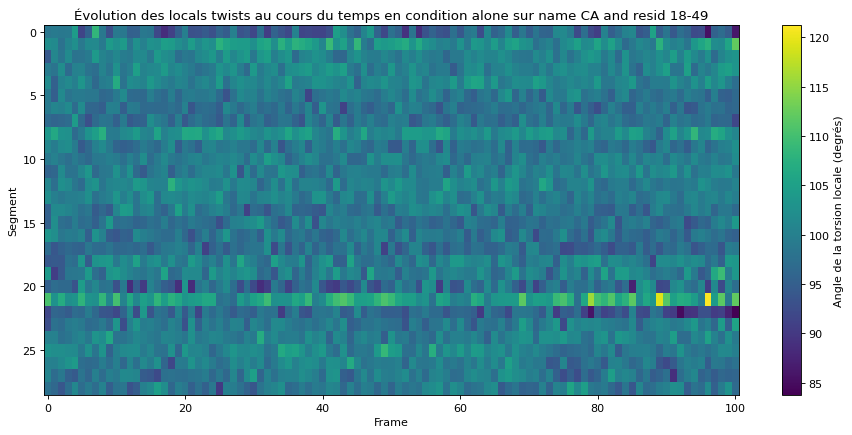

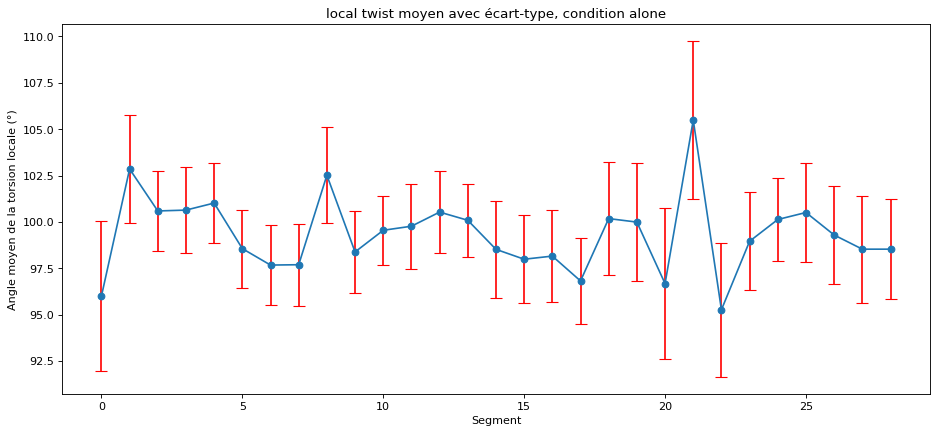

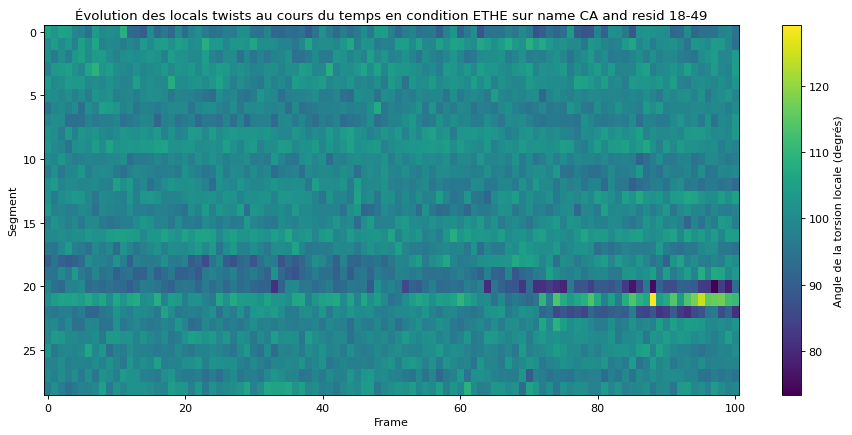

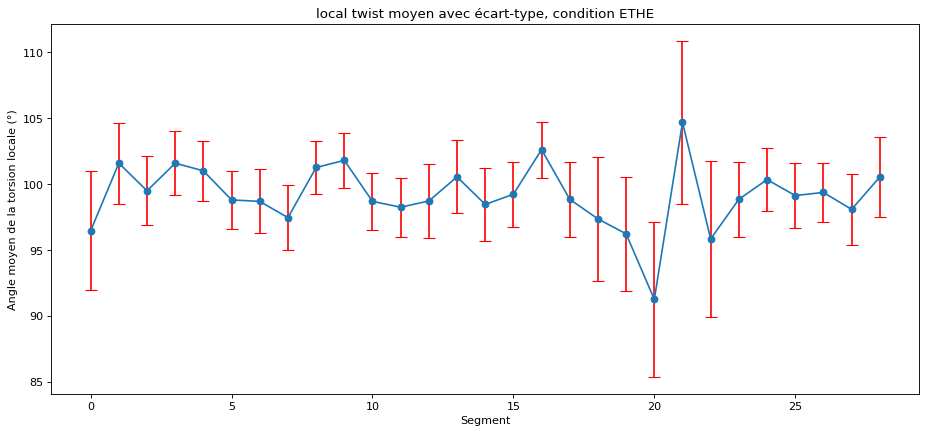

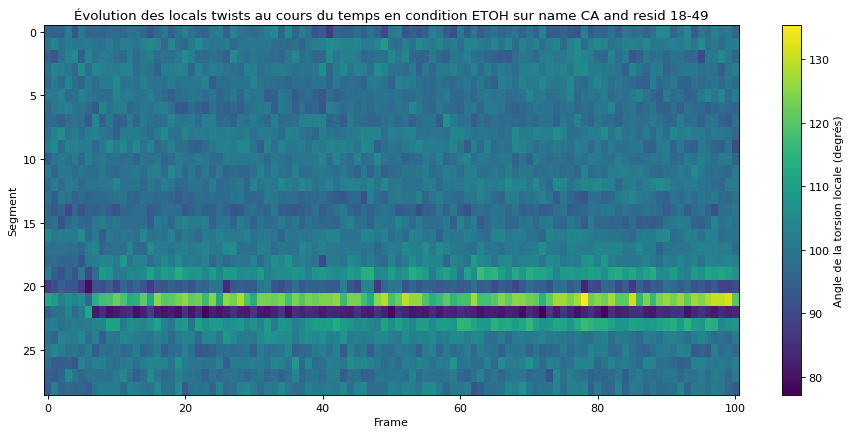

...

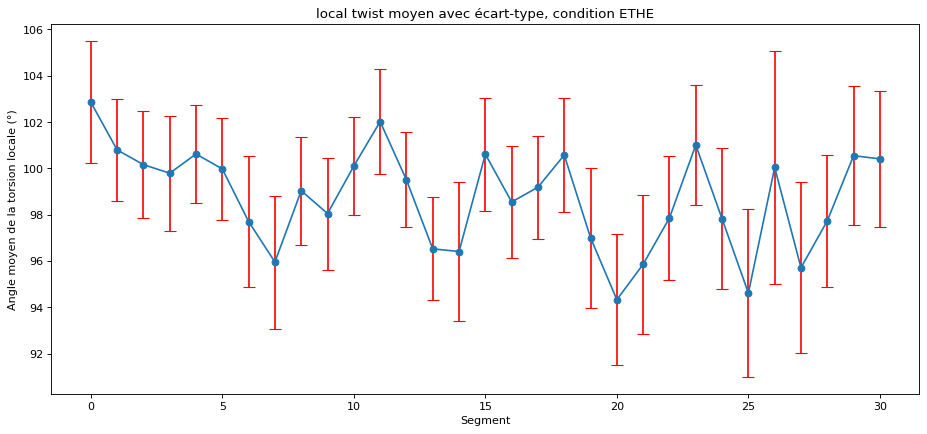

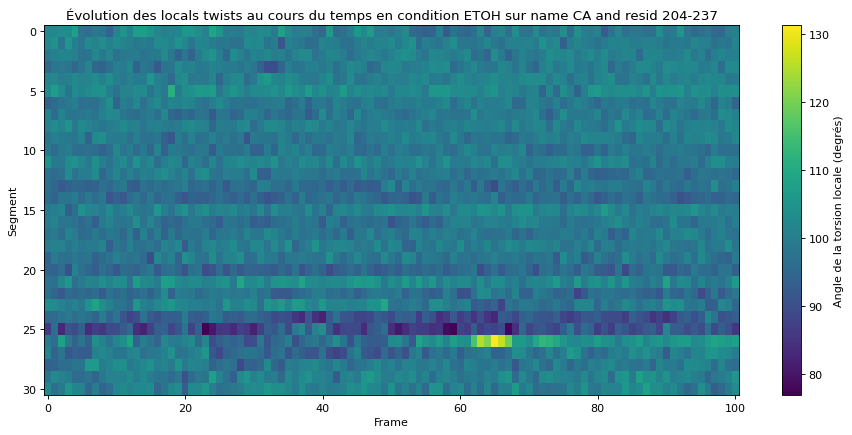

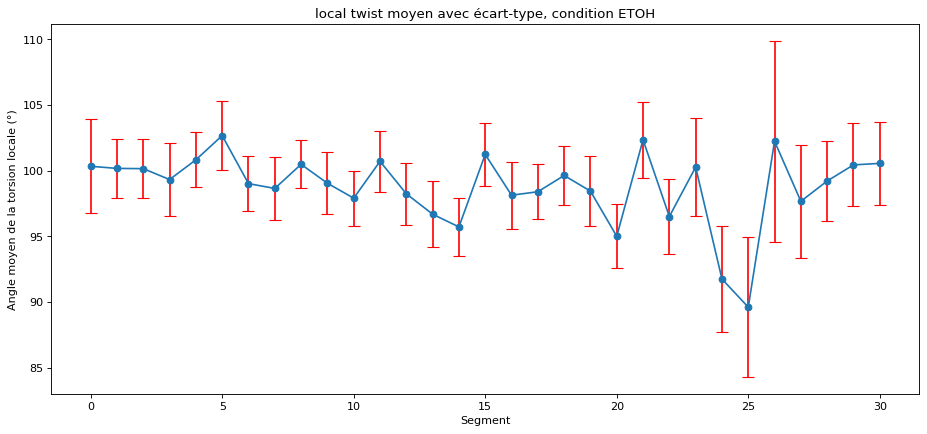

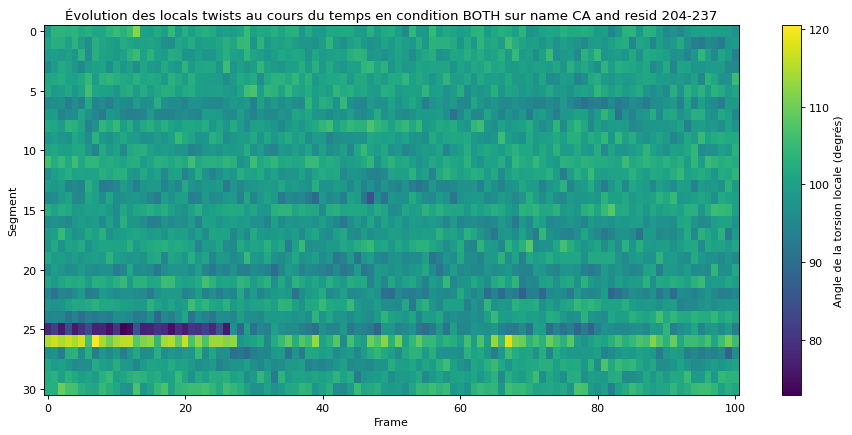

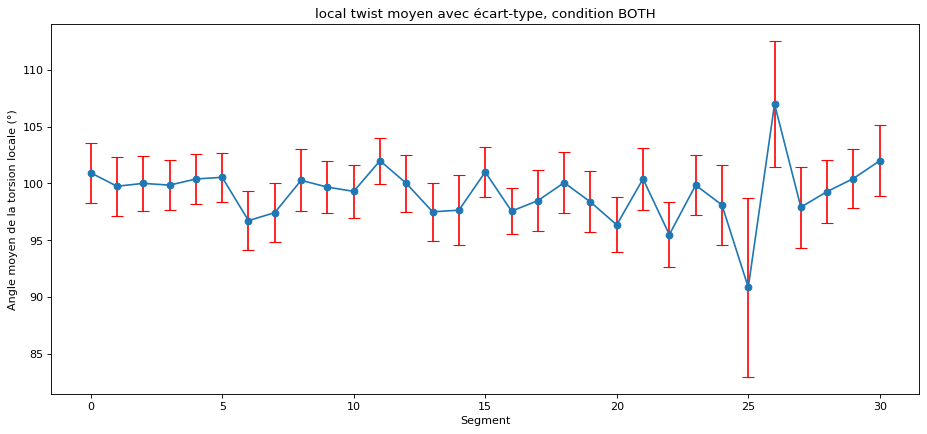

In [56]:
alone_results_twists = {}
ETHE_results_twists = {}
ETOH_results_twists = {}
BOTH_results_twists = {}

for i, helix in enumerate(all_helix, start=1):
    alone_results_twists[f"helix_{i}"] = analyse_helanal_twists(ALONE_tpr, ALONE_fit, helix, "alone")
    ETHE_results_twists[f"helix_{i}"] = analyse_helanal_twists(ETHE_tpr, ETHE_fit, helix,"ETHE")
    ETOH_results_twists[f"helix_{i}"] = analyse_helanal_twists(ETOH_tpr, ETOH_fit, helix,"ETOH")
    BOTH_results_twists[f"helix_{i}"] = analyse_helanal_twists(BOTH_tpr, BOTH_fit, helix,"BOTH")

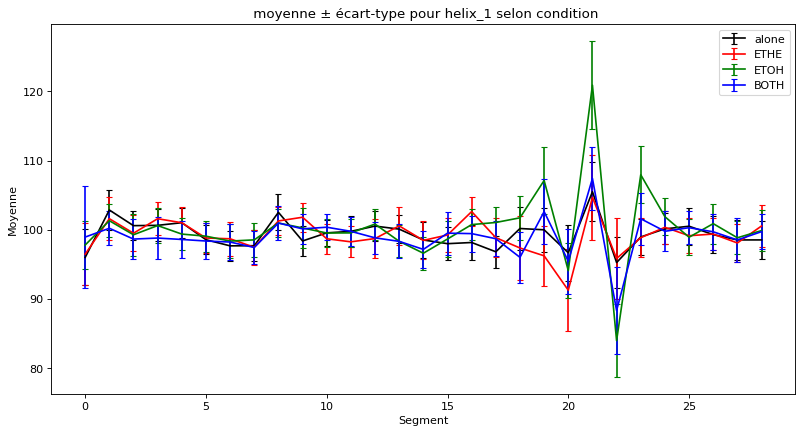

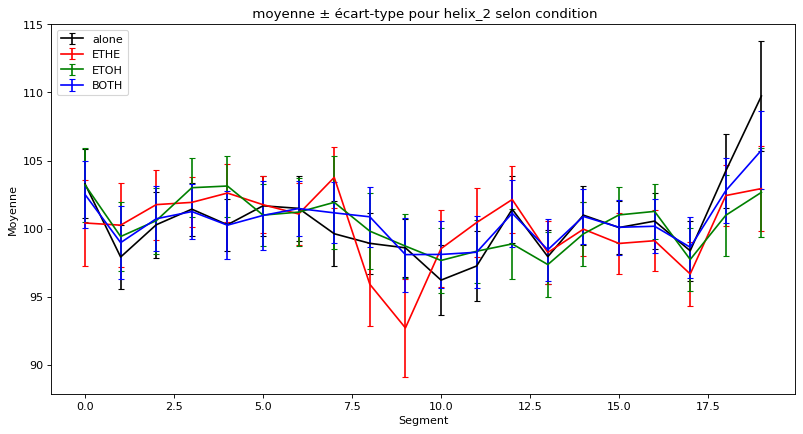

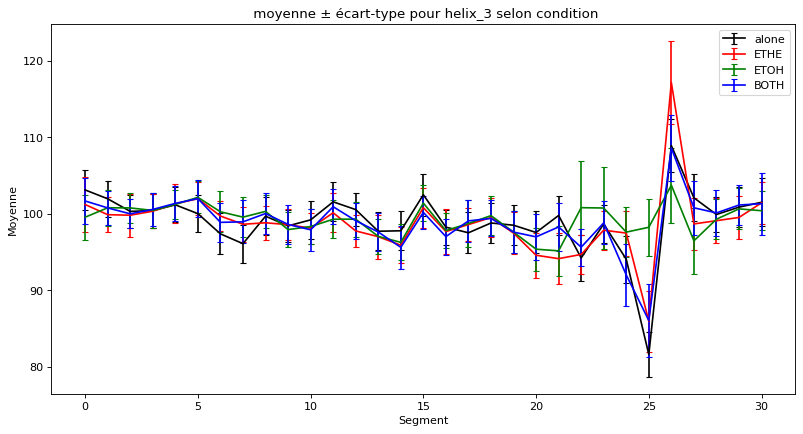

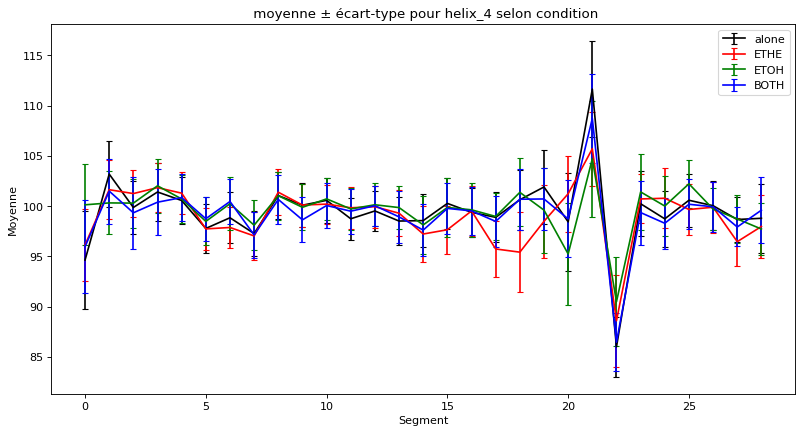

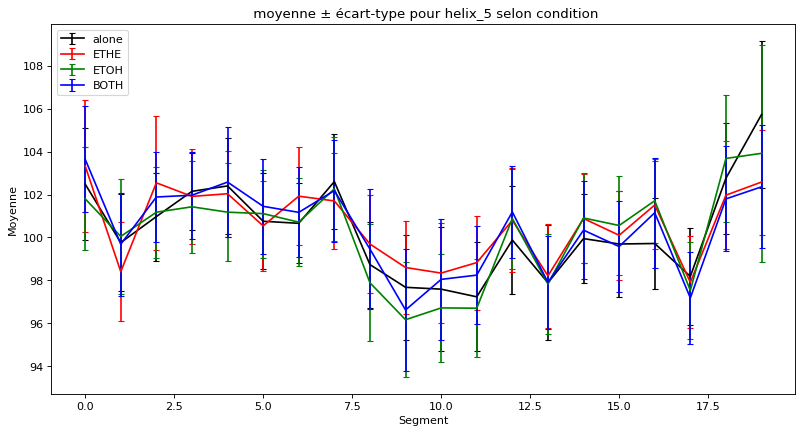

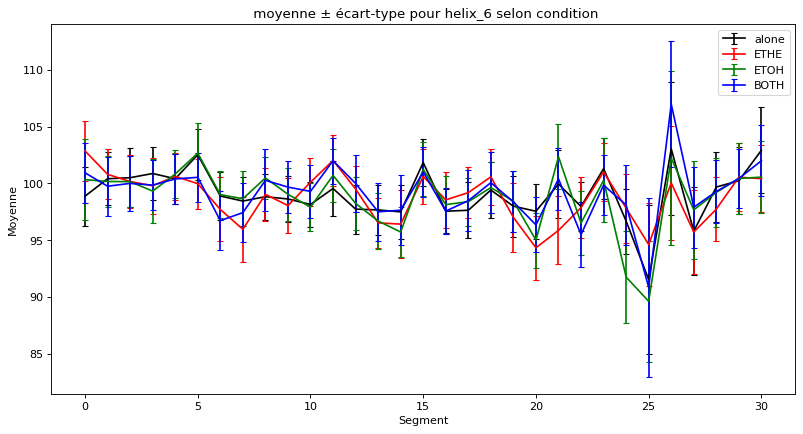

In [57]:
plot_par_helice(alone_results_twists, ETHE_results_twists, ETOH_results_twists, BOTH_results_twists)

In [58]:
def analyse_helanal_screw(tpr, fit, helix, condition = "?"):
    all_screw = []
    
    u = mda.Universe(tpr,fit) 
    #il faut le faire là sinon ça repart toujours toujours toujours à 0
    result = hel.HELANAL(u, select=(helix,))
    result.run()
    
    for i, ts in enumerate(u.trajectory[::100]):
        screw = np.array(result.results.local_screw_angles[i])
        all_screw.append(screw)
        
    angle_degre = np.array(all_screw)
    #plt.figure(figsize=(10,6))
    plt.imshow(angle_degre.T, aspect='auto', cmap='viridis')
    plt.colorbar(label='Angle de courbure (degrés)')
    plt.xlabel('Frame')
    plt.ylabel('Segment')
    plt.title(f'Évolution des screws angles au cours du temps en condition {condition} sur {helix}')
    plt.show()  

    means = []
    stds = []
    
    for i in range(angle_degre.shape[1]):  # sur chaque segment
        means.append(circmean(angle_degre[:, i], high=180, low=-180))
        stds.append(circstd(angle_degre[:, i], high=180, low=-180))
    
    means = np.array(means)
    stds = np.array(stds)

    
    segments = np.arange(len(means))
    
    #plt.figure(figsize=(10,6))
    plt.errorbar(segments, means, yerr=stds, fmt='-o', ecolor='r', capsize=5)
    plt.xlabel('Segment')
    plt.ylabel('Angle de rotation autour de l’axe (°)')
    plt.title(f'Screws angles moyen avec écart-type, condition {condition}')
    plt.show()

    return(means, stds)


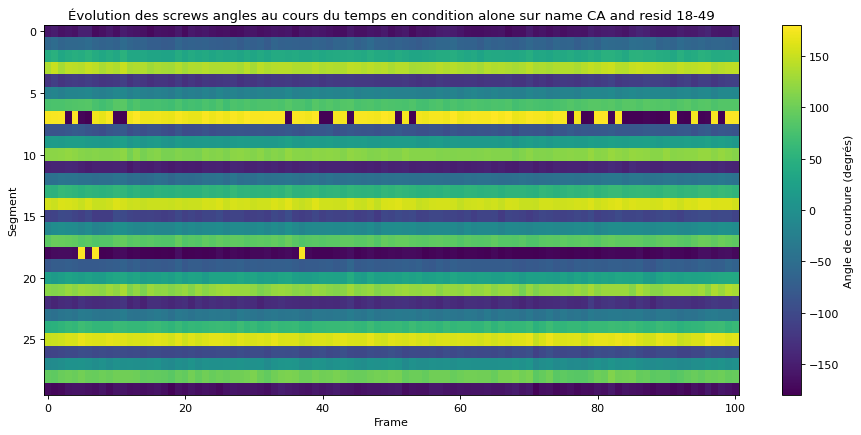

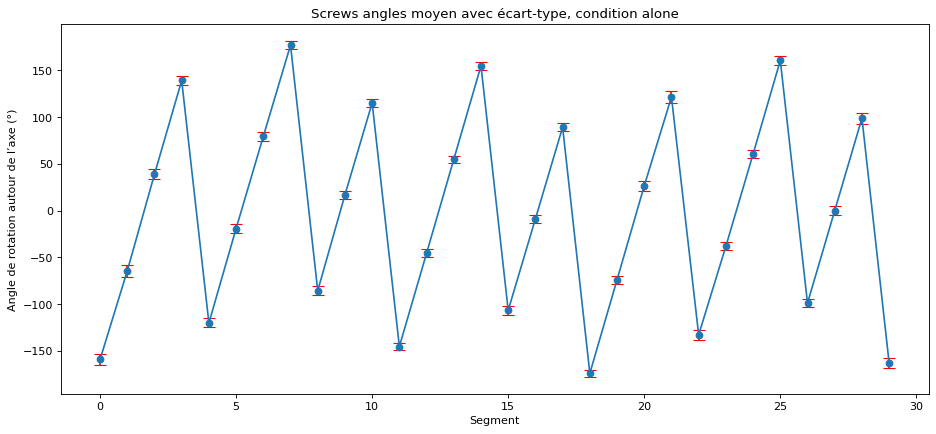

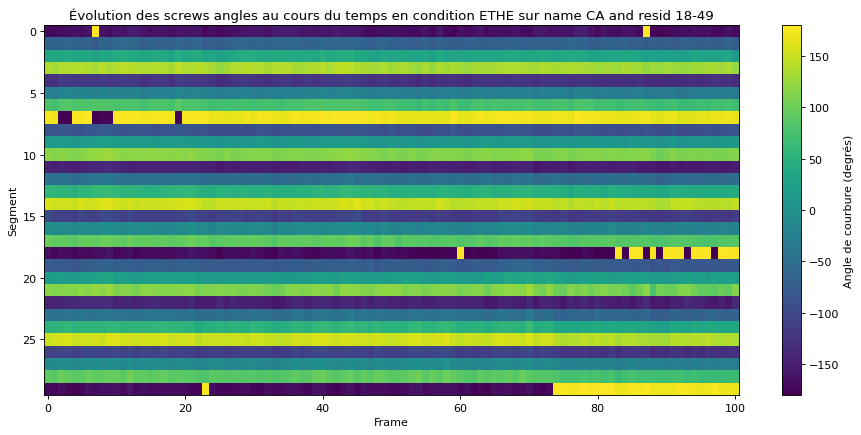

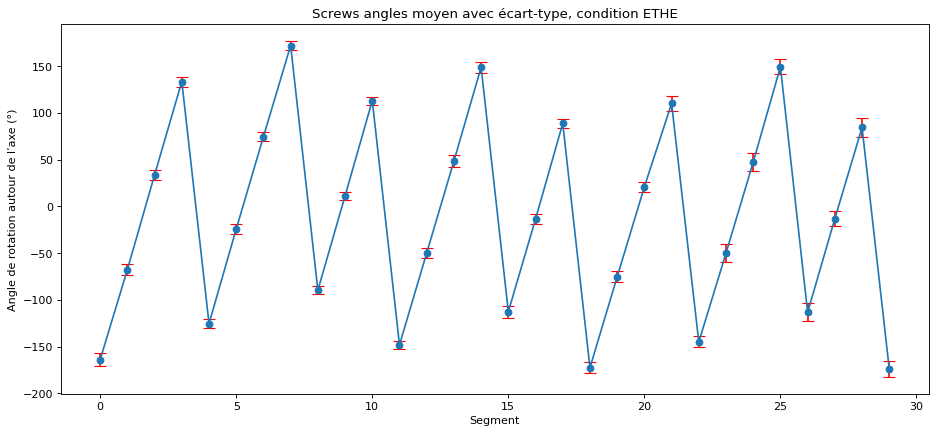

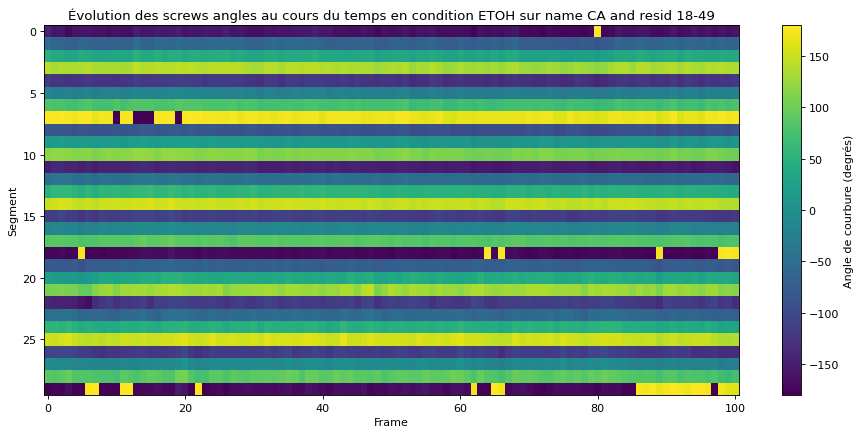

...

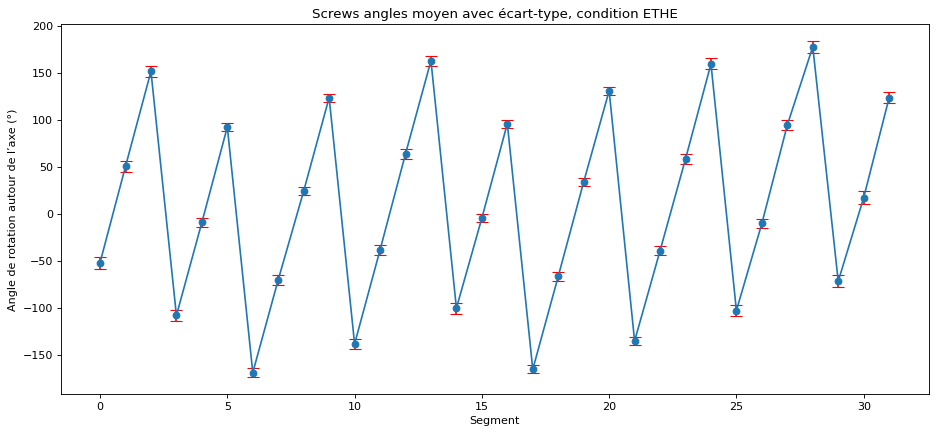

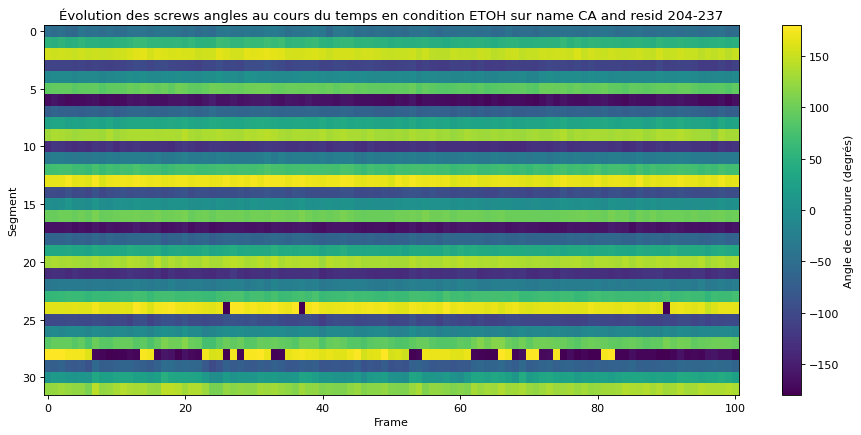

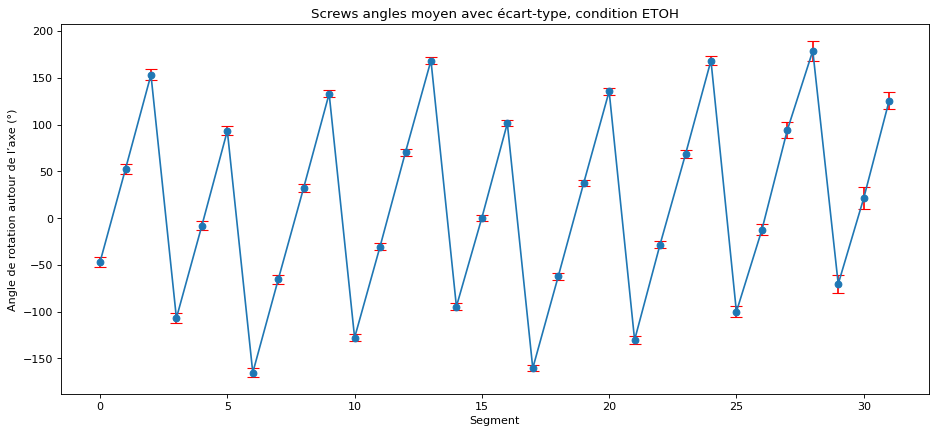

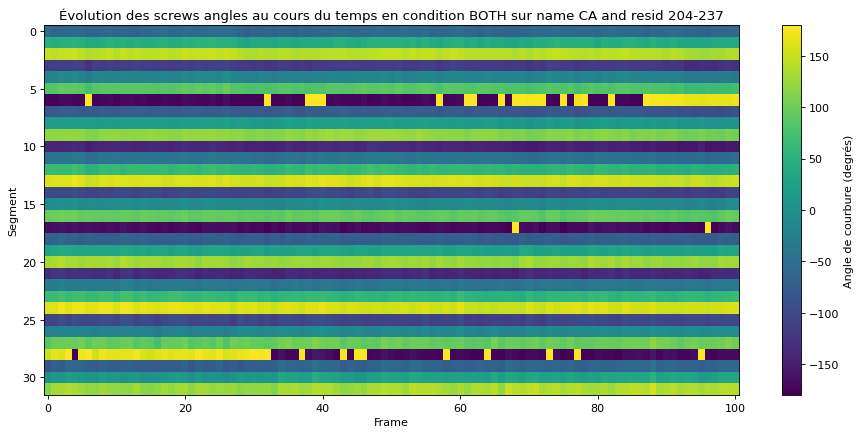

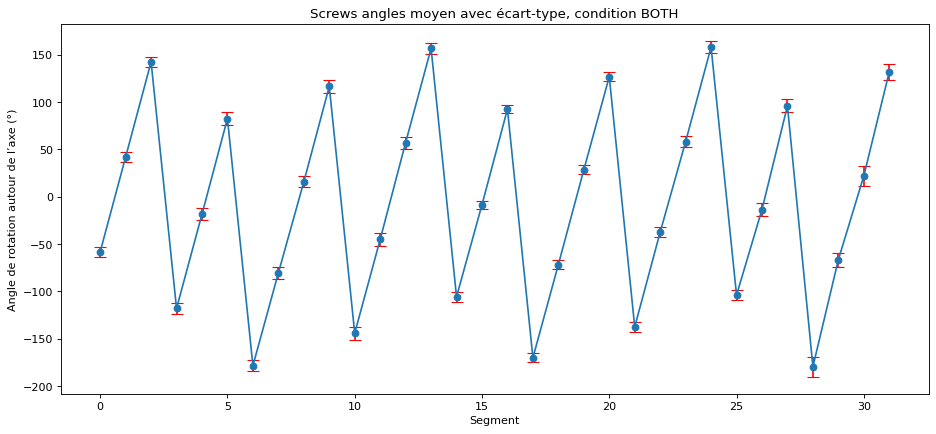

In [59]:
alone_results_screw = {}
ETHE_results_screw = {}
ETOH_results_screw = {}
BOTH_results_screw = {}

for i, helix in enumerate(all_helix, start=1):
    alone_results_screw[f"helix_{i}"] = analyse_helanal_screw(ALONE_tpr, ALONE_fit, helix, "alone")
    ETHE_results_screw[f"helix_{i}"] = analyse_helanal_screw(ETHE_tpr, ETHE_fit, helix,"ETHE")
    ETOH_results_screw[f"helix_{i}"] = analyse_helanal_screw(ETOH_tpr, ETOH_fit, helix,"ETOH")
    BOTH_results_screw[f"helix_{i}"] = analyse_helanal_screw(BOTH_tpr, BOTH_fit, helix,"BOTH")

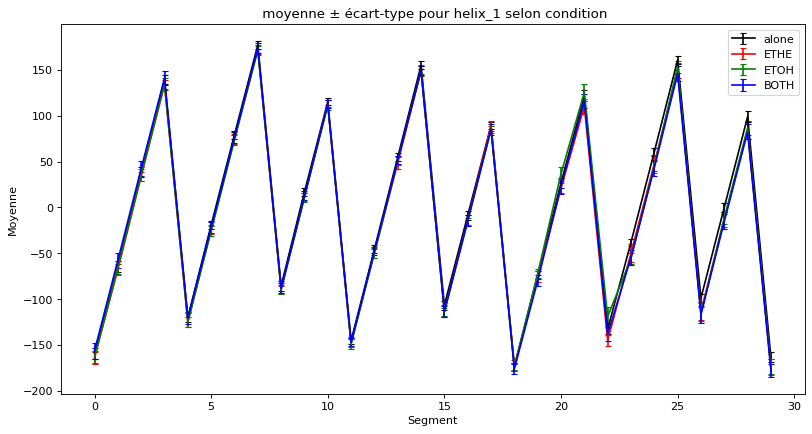

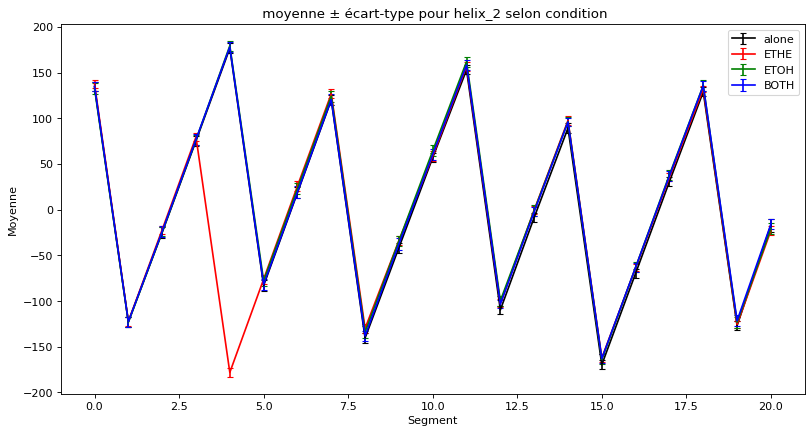

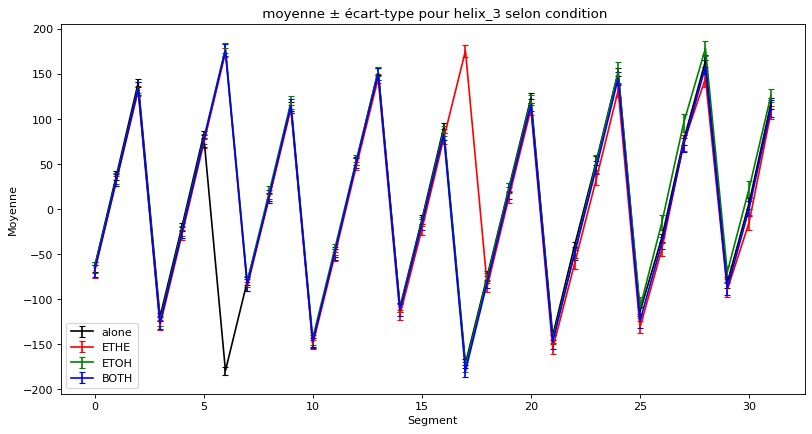

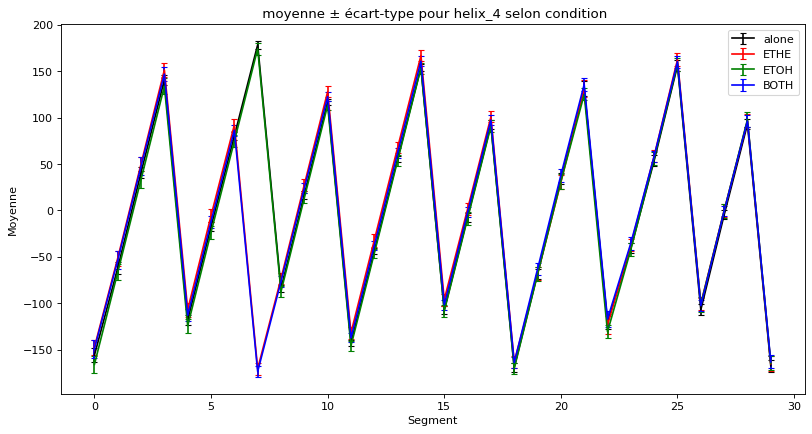

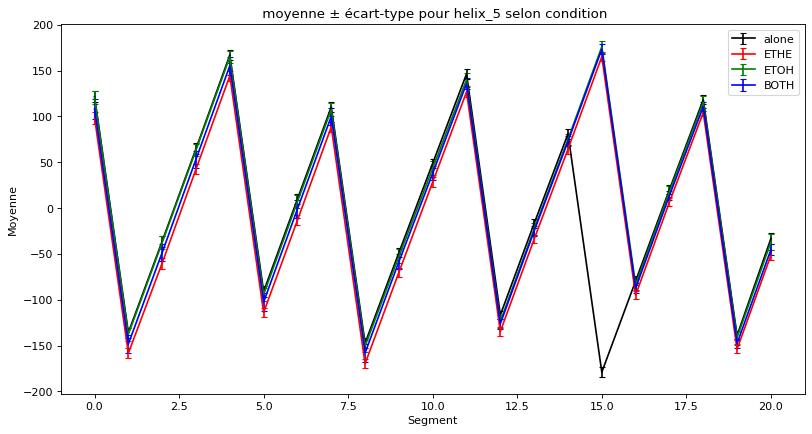

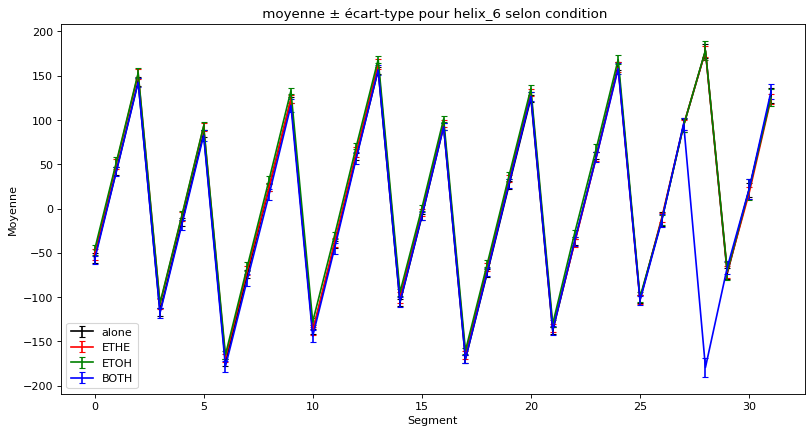

In [60]:
plot_par_helice(alone_results_screw, ETHE_results_screw, ETOH_results_screw, BOTH_results_screw)

On va regarder le nombre de coordination des ions cuivres. 

In [61]:
def coord_CU1P(gro, xtc, cutoff = 2.7):

    u = mda.Universe(gro,xtc)
    cus = u.select_atoms("name CU1P")
    others = u.atoms.select_atoms("protein and not name CU1P")

    n_frames = len(u.trajectory)
    cu_idx_list = [cu.ix for cu in cus]
    coord_counts = {cu.ix: np.zeros(n_frames, int) for cu in cus}
    
    coord_resid_history = { (cu.ix, resid): 0 
                            for cu in cus 
                            for resid in set(others.resids) }
    
    
    for t, ts in enumerate(u.trajectory):
        cu_pos = cus.positions
        other_pos = others.positions
        dists = distance_array(cu_pos, other_pos)  # (n_cu, n_other)
    
        for i_cu, cu in enumerate(cus):
            close = np.where(dists[i_cu] < cutoff)[0]
            # extraire les résidus de ces atomes
            residus = others.resids[close]
            # uniques
            uniques = np.unique(residus)
            coord_counts[cu.ix][t] = uniques.size
            for resid in uniques:
                coord_resid_history[(cu.ix, resid)] += 1
    
    #Mettre dans un DataFrame pour le plot
    df_counts = pd.DataFrame(coord_counts)
    df_counts.index.name = "frame"
    df_counts.reset_index(inplace=True) # df_counts aura colonnes: frame, CU_IDX1, CU_IDX2, …
    
    
    plt.figure(figsize=(12,4))
    for cu_idx in cu_idx_list:
        plt.scatter(df_counts["frame"], df_counts[cu_idx], label=f"Cu {cu_idx}", marker= '.')
    plt.xlabel("Frame")
    plt.ylabel("Nombre de résidus coordonnés (limite à 2.7 Å)")
    plt.title("Coordination Cu²⁺ au cours du temps")
    plt.legend()
    plt.tight_layout()
    #plt.savefig(os.path.join(outdir, "nb_coordinations_CU1P"), dpi = 300)
    plt.show()
    
    #Résumé par résidu 
    résumé = []
    for (cu_idx, resid), count in coord_resid_history.items():
        freq = count / n_frames
        if freq > 0:  # seuls les résidus ayant coordonné au moins une fois
            résumé.append({"cu_idx": cu_idx,
                           "resid": resid,
                           "freq_frames": freq})
    
    résumé_df = pd.DataFrame(résumé)
    # trier par cu_idx puis fréquence décroissante
    résumé_df = résumé_df.sort_values(["cu_idx","freq_frames"],
                                      ascending=[True, False])
    
    print("Top 10 résidus coordonnant par Cu²⁺ :")
    for cu in résumé_df.cu_idx.unique():
        top = résumé_df[résumé_df.cu_idx==cu].head(10)
        print(f"\nCu {cu} :\n", top.to_string(index=False))


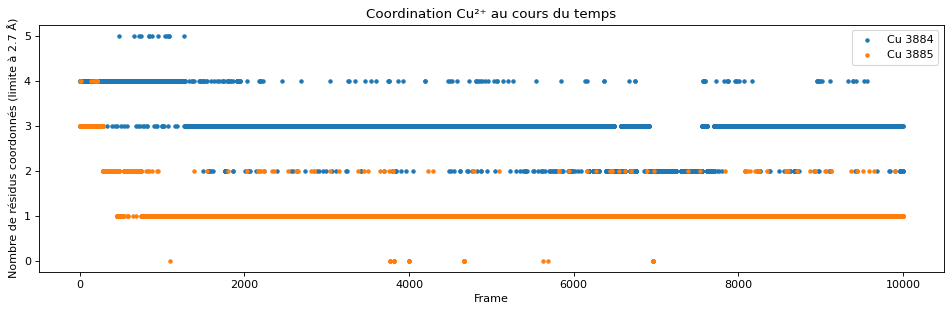

Top 10 résidus coordonnant par Cu²⁺ :

Cu 3884 :
  cu_idx  resid  freq_frames
   3884     72     0.996600
   3884     68     0.963004
   3884    188     0.915008
   3884    192     0.136986
   3884     36     0.006899
   3884    156     0.000700

Cu 3885 :
  cu_idx  resid  freq_frames
   3885     68     0.996300
   3885    156     0.055894
   3885     36     0.043696
   3885    185     0.003700
   3885    188     0.001100
   3885     65     0.000100


In [62]:
coord_CU1P(ETHE_gro, ETHE_xtc)

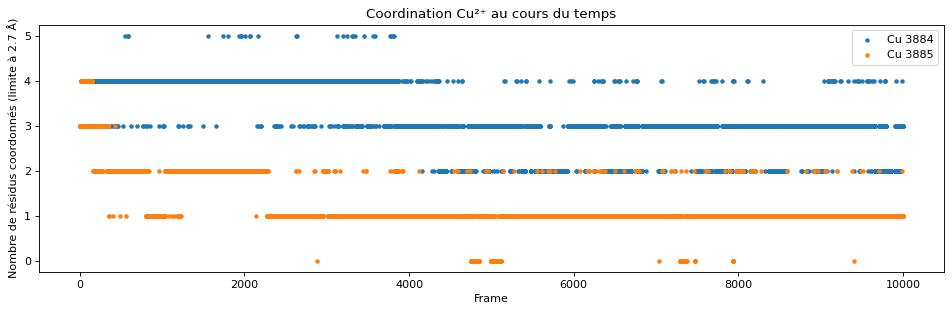

Top 10 résidus coordonnant par Cu²⁺ :

Cu 3884 :
  cu_idx  resid  freq_frames
   3884    192     0.998000
   3884     68     0.954005
   3884    188     0.856414
   3884     72     0.385061
   3884    156     0.012999
   3884     36     0.001700

Cu 3885 :
  cu_idx  resid  freq_frames
   3885    188     0.973403
   3885     36     0.207679
   3885    156     0.037096
   3885     68     0.010099
   3885     65     0.001700
   3885     32     0.000800
   3885    185     0.000500
   3885    184     0.000100


In [63]:
coord_CU1P(ETOH_gro, ETOH_xtc)

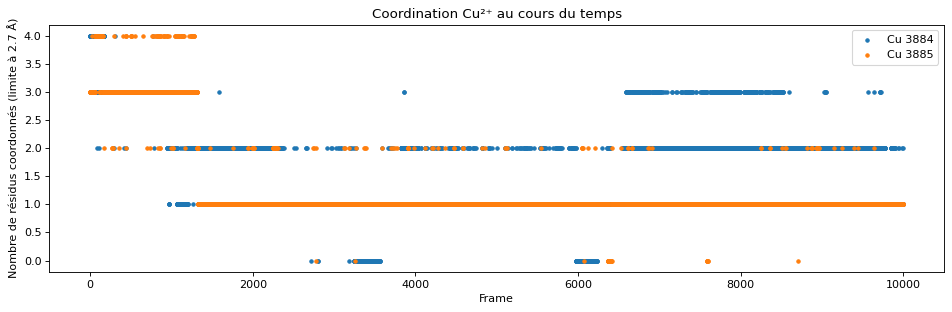

Top 10 résidus coordonnant par Cu²⁺ :

Cu 3884 :
  cu_idx  resid  freq_frames
   3884     29     0.618338
   3884     75     0.363864
   3884     72     0.261674
   3884     68     0.249775
   3884    192     0.127287
   3884    214     0.039496
   3884    188     0.019498
   3884     82     0.001100
   3884    191     0.000800
   3884    156     0.000600

Cu 3885 :
  cu_idx  resid  freq_frames
   3885    188     0.992701
   3885    156     0.128987
   3885     68     0.123988
   3885     36     0.030897
   3885     65     0.003500
   3885    192     0.001400
   3885     64     0.000100


In [64]:
coord_CU1P(BOTH_gro, BOTH_xtc)

On va regarder les interactions entre la proteine et l'éthylène et l'éthanol grâce à une matrice de contact : 

In [65]:
def contact_helix(Sel1, Sel2, Cutoff=5.0, Orient=None,box=None):
    """evaluate all contact between Sel1 and Sel2 with less than Cutoff"""
    data_contact =  []
    # ~ if Orient == None:
    coord1 = Sel1.positions
    coord2 = Sel2.positions
            
    pairs, test = mda.lib.distances.capped_distance(coord1, coord2, Cutoff, box)
                
        
    for k, [i, j] in enumerate(pairs):
        
        res1 = "{0}{1}".format(Sel1[i].resnum, Sel1[i].resname)
        if Orient == None:
            res2 = "{0}{1}".format(Sel2[j].resnum, Sel2[j].resname)
        else:
            res2 = "{0}".format(Sel2[j].resname)
            
        contact = res1+"-"+res2
        if not contact in data_contact:
            data_contact.append(contact)
    
    return data_contact

class contact_resid(AnalysisBase):
    def __init__(self, atomgroup1, atomgroup2, parameter, direction=None, **kwargs):
        super(contact_resid, self).__init__(atomgroup1.universe.trajectory,
                                            atomgroup2.universe.trajectory,
                                            **kwargs)
        self._parameter = parameter
        self._ag1 = atomgroup1
        self._ag2 = atomgroup2
        self._orient = direction
        self.times = self._ag1.universe.trajectory.totaltime
    def _prepare(self):
        
        self.result = []
        self.data_plot = []
        self.PairsName = []
        
    def _single_frame(self):
        self.result.append(contact_helix(self._ag1, self._ag2, self._parameter,self._orient))
    
    def _conclude(self):
        pairs_val =  []
        for i in range(self.n_frames):
            if i == self.start:
                pairs_val = self.result[i]
                for k,pairs in enumerate(pairs_val):
                    empty = np.empty((self.n_frames))
                    empty[:] = np.nan
                    #print empty
                    self.data_plot.append(empty)
                    self.data_plot[k][i]= k+1
            else:
                for pairs in self.result[i]:
                    if not pairs in pairs_val:
                        k = len(pairs_val)-1
                        empty = np.empty((self.n_frames))
                        empty[:] = np.nan
                        self.data_plot.append(empty)
                        self.data_plot[k][i] = k+1
                        pairs_val.append(pairs)
                    else:
                        k = pairs_val.index(pairs)
                        self.data_plot[k][i] = k+1
        self.PairsName = pairs_val


    def plot(self, CutP=0.10, Csvfile=None, Savefile=None, show_table=True):
        """
        Plot contact data and optionally display the stats table beside the plot.
        Parameters:
        CutP (float): Minimal percentage over time a contact must be present to be plotted.
        Csvfile (str): Optional CSV output.
        Savefile (str): Optional path to save the plot.
        show_table (bool): Whether to show the DataFrame next to the plot.

        Returns:
        pandas.DataFrame: Table with 'Contact' and 'Persistence (%)'.
        """
        import matplotlib.gridspec as gridspec
        
        data_stats = []
        y_labels = []
        dataPlt = self.data_plot
        NamePairs = self.PairsName

        try:
            time = np.arange(len(self._ag1.universe.trajectory.nframes*self._ag1.universe.trajectory.dt)) # nanoseconds
        except AttributeError:
            time = np.arange(len(dataPlt[0]))*100

        if Csvfile:
            with open(Csvfile, 'w', newline='') as flux:
                writer = csv.writer(flux)
                writer.writerow(["contact"] + list(range(1, len(dataPlt[0]) + 1)))

        # Two-column layout
        fig = plt.figure(figsize=(20, 20) if show_table else (6.4, 4.8))
        if show_table:
            gs = gridspec.GridSpec(1, 2, width_ratios=[2, 1])
            ax_plot = plt.subplot(gs[0])
        else:
            ax_plot = plt.gca()
              # Plot
        y_index = 1
        plotted_indices = []

        for i, tmp in enumerate(dataPlt):
            tmp = np.array(tmp)
            valid_vals = tmp[~np.isnan(tmp)]
            if len(valid_vals) == 0:
                continue
            valId = np.unique(valid_vals)[0]
            ratio = np.sum(valid_vals == valId) / len(tmp)

            if ratio > CutP:
                Xdata = [y_index if x == valId else np.nan for x in tmp]
                ax_plot.plot(time/1000, Xdata, '.', label=NamePairs[i])
                data_stats.append({"Contact": NamePairs[i], "Persistence (%)": ratio * 100})
                y_labels.append(NamePairs[i])
                plotted_indices.append(y_index)

                if Csvfile:
                    CsvData = [y_index if x == valId else 0 for x in tmp]
                    with open(Csvfile, 'a', newline='') as flux:
                        writer = csv.writer(flux)
                        writer.writerow([NamePairs[i]] + CsvData)

                y_index += 1

        # Format plot
        ax_plot.set_yticks(plotted_indices)
        ax_plot.set_yticklabels(y_labels)
        ax_plot.set_xlabel("Time (ns)")
        ax_plot.set_ylabel("Contacts")
        ax_plot.set_title("Persistent Contacts (> {:.0%})".format(CutP))

        # DataFrame
        df = pd.DataFrame(data_stats).sort_values(by="Persistence (%)", ascending=False).reset_index(drop=True)
        
        if show_table:
            ax_table = plt.subplot(gs[1])
            ax_table.axis('off')
            table = ax_table.table(cellText=df.values,
                            colLabels=df.columns,
                            cellLoc='left',
                            loc='center')
            table.auto_set_font_size(False)
            table.set_fontsize(10)
            table.scale(1, 1.5)

        plt.tight_layout()

        if Savefile:
            plt.savefig(Savefile, dpi=300)
        else:
            plt.show()


  0%|          | 0/10001 [00:00<?, ?it/s]

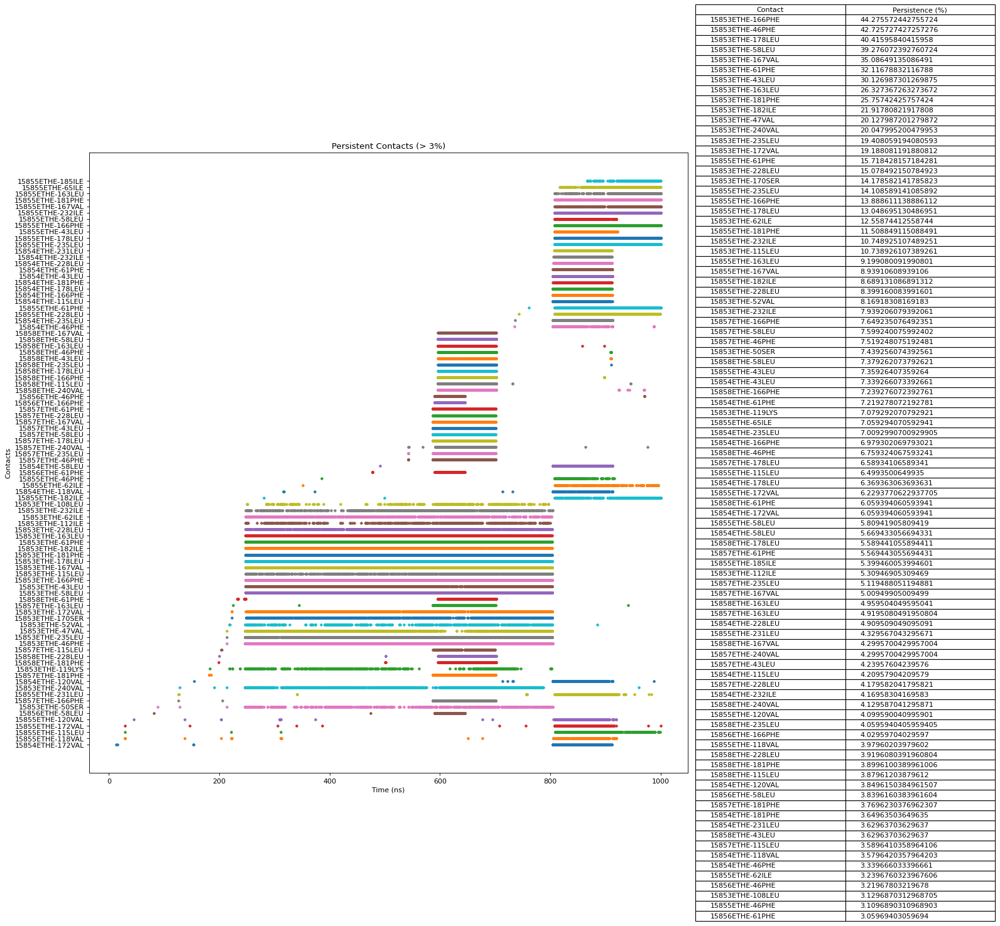

In [66]:
ETHE_md = mda.Universe(ETHE_gro,ETHE_xtc)
Protein =  mda.Universe(ETHE_gro,ETHE_xtc)

Sel1 = ETHE_md .select_atoms("resname ETHE")
Sel2 =  ETHE_md.select_atoms("protein")

data1 = contact_resid(Sel1, Sel2, 5).run()
data1.plot(0.03, show_table=True) #30 ns de CutP 


  0%|          | 0/10001 [00:00<?, ?it/s]

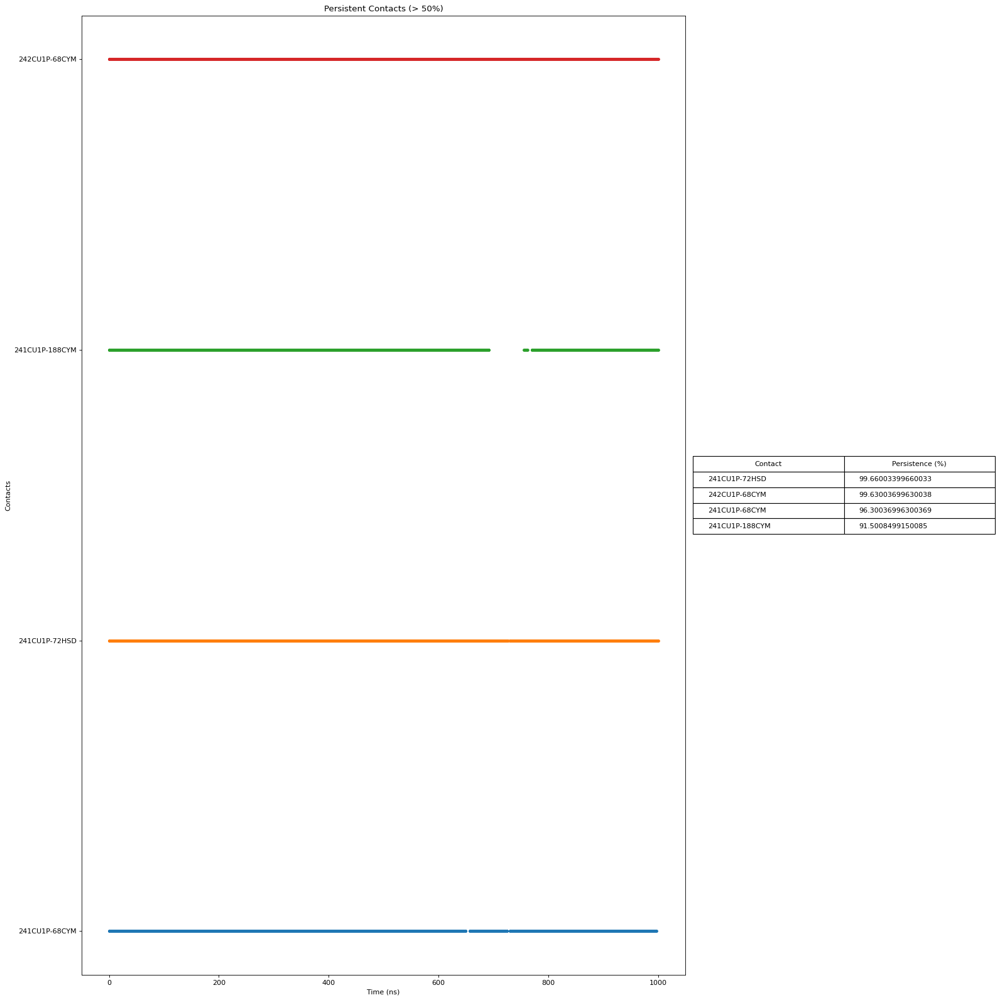

In [67]:
Cu =  ETHE_md.select_atoms("resid 241 242")
data2 = contact_resid(Cu, Sel2, 2.7).run()
data2.plot(0.5, show_table=True) 

  0%|          | 0/10001 [00:00<?, ?it/s]

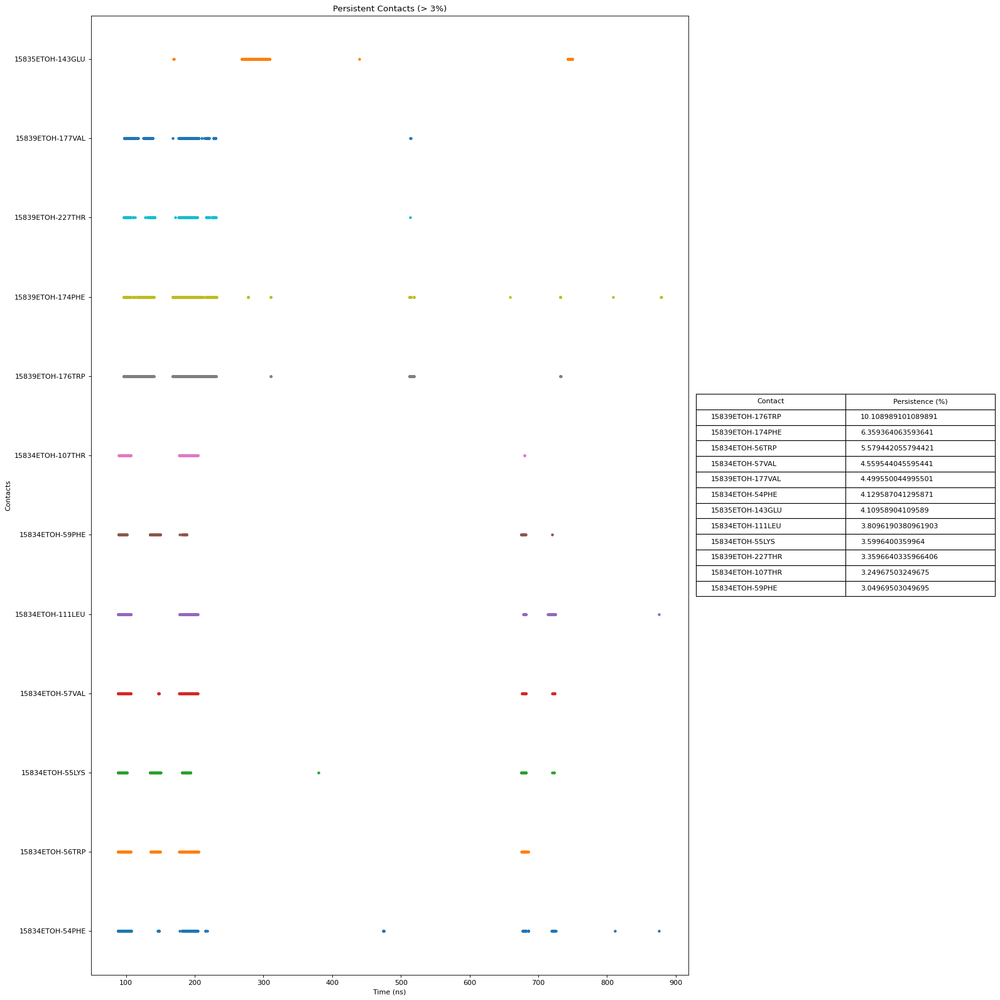

In [68]:
Sel1 =  mda.Universe(ETOH_gro,ETOH_xtc).select_atoms("resname ETOH")
Sel2 =  mda.Universe(ETOH_gro,ETOH_xtc).select_atoms("protein")

data3 = contact_resid(Sel1, Sel2, 5).run()
data3.plot(0.03, show_table=True) #30 ns de CutP 


  0%|          | 0/10001 [00:00<?, ?it/s]

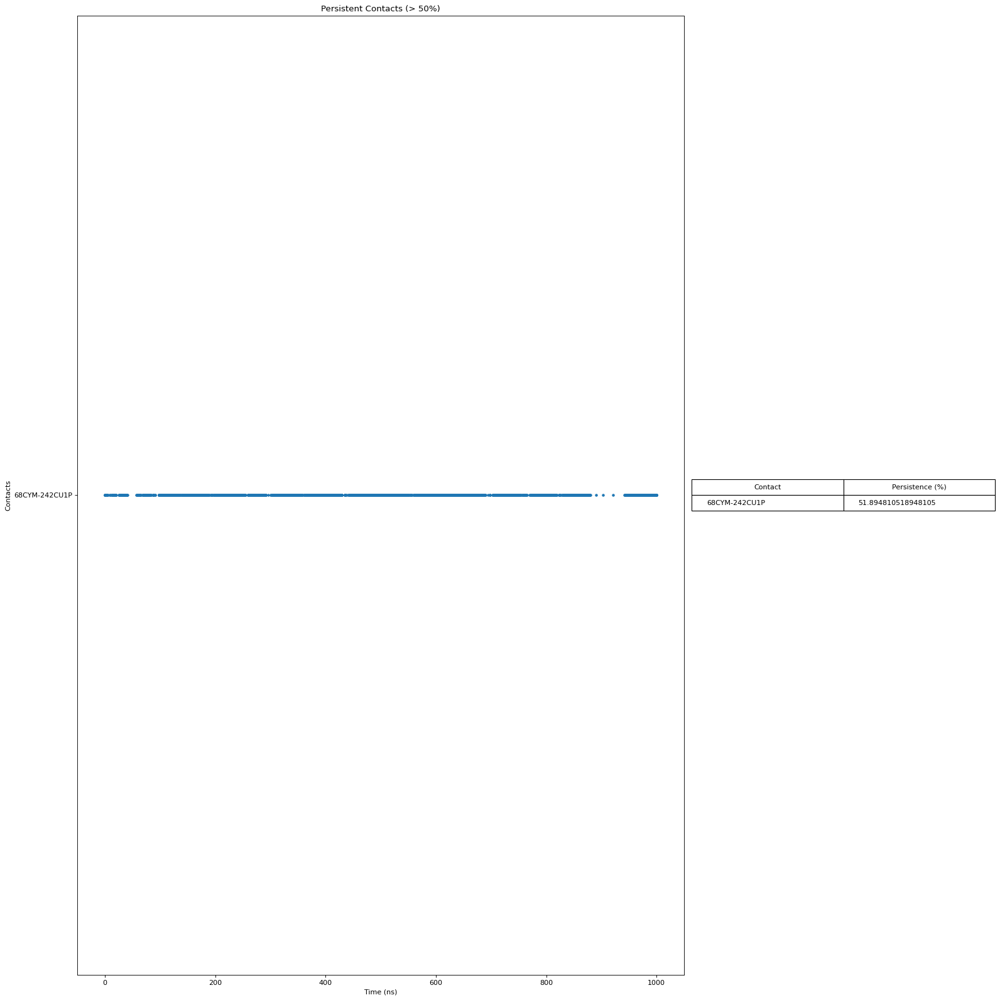

In [69]:
Cu =  mda.Universe(ETOH_gro,ETOH_xtc).select_atoms("resid 241 242")
data4 = contact_resid(Sel2, Cu, 2.7).run()
data4.plot(0.5, show_table=True) 

  0%|          | 0/10001 [00:00<?, ?it/s]

KeyError: 'Persistence (%)'

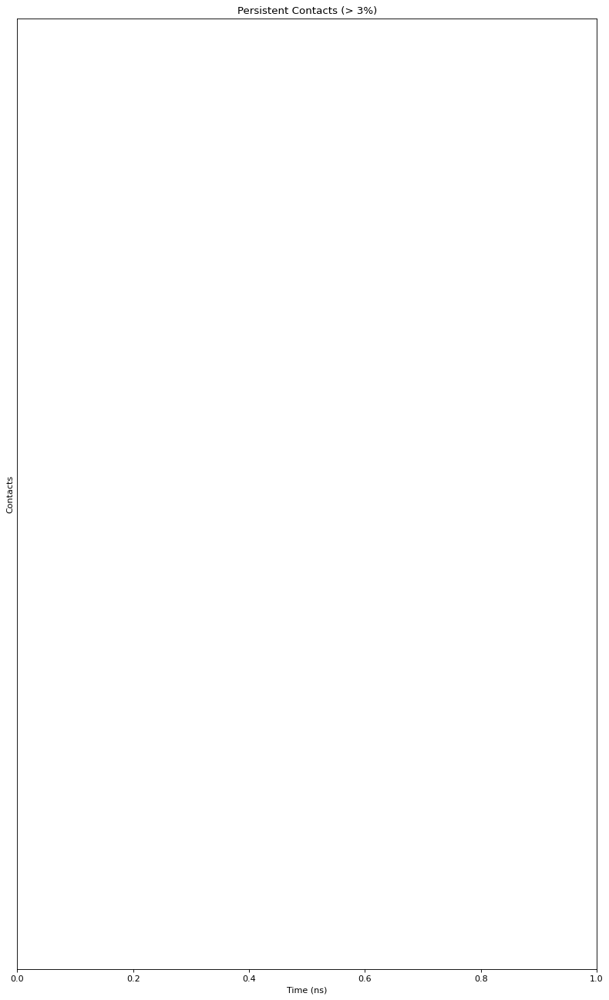

In [70]:
Sel1 =  mda.Universe(BOTH_gro,BOTH_xtc).select_atoms("resname ETOH")
Sel2 =  mda.Universe(BOTH_gro,BOTH_xtc).select_atoms("protein")

data5 = contact_resid(Sel1, Sel2, 5).run()
data5.plot(0.03, show_table=True) #30 ns de CutP 

In [ ]:
Sel1 =  mda.Universe(BOTH_gro,BOTH_xtc).select_atoms("resname ETOH")

data7 = contact_resid(Sel1, Sel2, 5).run()
data7.plot(0.03, show_table=True) #30 ns de CutP 


In [ ]:
Cu =  mda.Universe(BOTH_gro,BOTH_xtc).select_atoms("resid 241 242")
data8 = contact_resid(Cu, Sel2, 2.7).run()
data8.plot(0.5, show_table=True)  